# Машинное обучение, ФКН ВШЭ

# Обучение без учителя.

В этом проекте мы посмотрим на несколько алгоритмов кластеризации и применим их к географическим и текстовым данным. Также мы подробно остановимся на тематическом моделировании текстов, задаче обучения представлений и поработаем с semi-supervised learning.

In [1]:
import pandas as pd
import numpy as np

from numpy import linalg as LA

np.random.seed(0xFFFFFFF)

## Часть 1. Кластеризация автобусных остановок

### Спектральная кластеризация

Сравним разные алгоритмы кластеризации для данных об автобусных остановках Москвы.

Реализуем алгоритм **спектральной кластеризации**. Напомним, что для графа с матрицей смежности $W = \{w_{ij}\}_{i, j = 1 \dots \ell}$ лапласиан определяется как:

$$
L = D - W,
$$

где $D = \text{diag}(d_1, ..., d_{\ell}), d_i = \sum_{j=1}^{\ell} w_{ij}$.

In [2]:
import os
os.environ["OMP_NUM_THREADS"] = '4'

from sklearn.base import ClusterMixin
from sklearn.cluster import KMeans


class GraphClustering(ClusterMixin):
    def __init__(self, n_clusters=8, n_components=None, **kwargs):
        '''
        Spectral clustering algorithm
        param n_clusters: number of clusters to form
        param n_components: number of eigenvectors to use
        '''

        if n_components is None:
            n_components = n_clusters

        self.n_components = n_components
        self.kmeans = KMeans(n_clusters=n_clusters, **kwargs)

    def fit_predict(self, X, y=None):
        '''
        Perform spectral clustering from graph adjacency matrix
        and return vertex labels.
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, ) - vertex labels
        '''

        eigenvectors = self._generate_eigenvectors(X)
        labels = self.kmeans.fit_predict(eigenvectors[:, 1:])
        return labels

    def _generate_eigenvectors(self, X):
        '''
        Compute eigenvectors for spectral clustering
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, n_components) - eigenvectors
        '''

        D = np.diag(np.sum(X, axis=1))
        L = D - X
        w, v = LA.eigh(L)  #  the column v[:,i] is the eigenvector corresponding to the eigenvalue w[i]
        assert np.all(w == np.sort(w))                                                    # проверка, что с.з. правда отсортированы
        assert np.all(v[:,np.argsort(w)[:self.n_components]] == v[:,:self.n_components])  # проверка, что с.в. действительно соотв-т 
                                                                                          # первым self.n_components
        U = v[:,:self.n_components]  # перем self.n_components с.в., соответствующих self.n_components наименьших с.з.
        return U
    
    def _get_cluster_centers_(self):
        return self.kmeans.cluster_centers_

Протестируем свое решение.

In [3]:
n_blocks, n_vertices = 10, 1000
block_vertices = n_vertices // n_blocks

X = np.zeros((n_vertices, n_vertices))
for i in range(0, n_vertices, block_vertices):
    X[i:i + block_vertices, i:i + block_vertices] = np.sqrt(i + 1)

graph_clustering = GraphClustering(n_clusters=n_blocks)
labels = graph_clustering.fit_predict(X)

true_labels = np.zeros(n_vertices, dtype=np.int32)
for i in range(0, n_vertices, block_vertices):
    true_labels[i:i + block_vertices] = labels[i]

assert labels.shape == (n_vertices, )
assert np.all(np.bincount(labels) == np.full(n_blocks, block_vertices))
assert np.all(labels == true_labels)

Приступим к работе с реальными данными. Скачаем файл с данными об остановках общественного транспорта **в формате .xlsx** по [ссылке](https://data.mos.ru/opendata/download/60464/1/201) (так гарантированно не возникнет проблем с парсингом файла) и загрузите таблицу в ноутбук. Если вдруг сайт Правительства Москвы не будет открываться, можно взять какую-нибудь версию данных [отсюда](https://data.mos.ru/opendata/7704786030-city-surface-public-transport-stops). Для удобства визуализации мы будем работать только с остановками в ЦАО.

In [4]:
data = pd.read_excel('City surface public transport stops.xlsx')
data = data[data.AdmArea_en == "Czentral`ny'j administrativny'j okrug"]
data = data.reset_index()
data.head()

,index,ID_en,Name_en,Longitude_WGS84_en,Latitude_WGS84_en,Street_en,AdmArea_en,District_en,RouteNumbers_en,StationName_en,Direction_en,Pavilion_en,OperatingOrgName_en,EntryState_en,global_id,geoData
0,278,347,"«2-й Лесной пер.», улица Бутырский Вал (347)",37.586584,55.782106,улица Бутырский Вал,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ18; А12; АТ56; АТ78,2-й Лесной пер.,NaN,да,ГУП «Мосгортранс»,active,889085436,NaN
1,279,349,"«Ул. Сущевский Вал», Новослободская улица (349)",37.590714,55.790630,Новослободская улица,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ47; АМ10; АТ3; АТ56; АТ78,Ул. Сущевский Вал,NaN,да,ГУП «Мосгортранс»,active,889085437,NaN
2,355,479,"«Стадион Лужники (южн.) (пос.)», улица Лужники...",37.565972,55.714265,улица Лужники,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Стадион Лужники (южн.) (пос.),NaN,да,ГУП «Мосгортранс»,active,889085549,NaN
3,356,480,"«Спортзал Дружба», Лужнецкая набережная (480)",37.570191,55.712504,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Спортзал Дружба,NaN,да,ГУП «Мосгортранс»,active,889085550,NaN
4,357,481,"«Лужнецкая наб.», Лужнецкая набережная (481)",37.574559,55.713770,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Лужнецкая наб.,NaN,да,ГУП «Мосгортранс»,active,889085551,NaN


In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1037 entries, 0 to 1036
Data columns (total 16 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   index                1037 non-null   int64  
 1   ID_en                1037 non-null   int64  
 2   Name_en              1037 non-null   object 
 3   Longitude_WGS84_en   1037 non-null   float64
 4   Latitude_WGS84_en    1037 non-null   float64
 5   Street_en            1037 non-null   object 
 6   AdmArea_en           1037 non-null   object 
 7   District_en          1037 non-null   object 
 8   RouteNumbers_en      1037 non-null   object 
 9   StationName_en       1037 non-null   object 
 10  Direction_en         0 non-null      float64
 11  Pavilion_en          1037 non-null   object 
 12  OperatingOrgName_en  853 non-null    object 
 13  EntryState_en        1037 non-null   object 
 14  global_id            1037 non-null   int64  
 15  geoData              0 non-null      f

Воспользуемся библиотекой `folium` для визуализации данных.

In [ ]:
# !pip install folium

In [5]:
import folium

my_map = folium.Map([55.75215, 37.61819], zoom_start=12)
for id, row in data.iterrows():
    folium.Circle([row.Latitude_WGS84_en, row.Longitude_WGS84_en],
                  radius=10).add_to(my_map)
my_map

### Построение графа

Попробуем построить граф, в котором вершинами будут остановки. Д

ля каждой остановки указаны номера маршрутов, проходящих через неё. Логично соединить ребрами соседние остановки каждого маршрута. Однако мы не знаем, в каком порядке автобусы объезжают остановки. Но мы можем применить эвристический алгоритм, который восстановит нам порядок маршрутов:

* Для каждого маршрута выделим список всех остановок, через которые он проходит.
* Выберем начальную остановку маршрута как точку, наиболее удаленную от всех остальных остановок этого маршрута.
* Каждую следующую точку маршрута будем выбирать как самую близкую из оставшихся точек (не включенных в маршрут ранее).

Фактически, у нас получается жадное решение задачи коммивояжера. Когда мы отсортировали маршруты, можем построить по ним граф. Будем строить его по таким правилам:

* Между двумя остановками будет ребро, если они являются соседними хотя бы на одном маршруте. Вес ребра равен числу маршрутов, на которых остановки являются соседними.
* В графе не будет петель (то есть у матрицы смежности будет нулевая диагональ).

Реализуем предложенный выше способ построения графа.

In [6]:
def haversine_array(lat1, lng1, lat2, lng2):
    """
    Функция, считающая корректное расстояние между двумя геокоординатами на Земле
    с учетом ее формы
    """
    lat1, lng1, lat2, lng2 = map(np.radians, (lat1, lng1, lat2, lng2))
    AVG_EARTH_RADIUS = 6371  # in km
    lat = lat2 - lat1
    lng = lng2 - lng1
    d = np.sin(lat * 0.5) ** 2 + np.cos(lat1) * np.cos(lat2) * np.sin(lng * 0.5) ** 2
    h = 2 * AVG_EARTH_RADIUS * np.arcsin(np.sqrt(d))
    return h

In [7]:
# поставим датасету индексы, соответствующие колонке ID_en, чтобы дальше было удобно обращаться к ним
data = data.set_index(data['ID_en'].values)
data.head(3)

,index,ID_en,Name_en,Longitude_WGS84_en,Latitude_WGS84_en,Street_en,AdmArea_en,District_en,RouteNumbers_en,StationName_en,Direction_en,Pavilion_en,OperatingOrgName_en,EntryState_en,global_id,geoData
347,278,347,"«2-й Лесной пер.», улица Бутырский Вал (347)",37.586584,55.782106,улица Бутырский Вал,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ18; А12; АТ56; АТ78,2-й Лесной пер.,NaN,да,ГУП «Мосгортранс»,active,889085436,NaN
349,279,349,"«Ул. Сущевский Вал», Новослободская улица (349)",37.590714,55.790630,Новослободская улица,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ47; АМ10; АТ3; АТ56; АТ78,Ул. Сущевский Вал,NaN,да,ГУП «Мосгортранс»,active,889085437,NaN
479,355,479,"«Стадион Лужники (южн.) (пос.)», улица Лужники...",37.565972,55.714265,улица Лужники,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Стадион Лужники (южн.) (пос.),NaN,да,ГУП «Мосгортранс»,active,889085549,NaN


In [3]:
from collections import defaultdict

def get_routes(data):
    '''
    Accumulate routes from raw data
    param data: pd.DataFrame - public transport stops data
    return: dict - unsorted stops ids for each route,
                   e.g. routes['A1'] = [356, 641, 190]
    '''

    routes = defaultdict(list)

    for i in range(len(data)):
        # забираем все номера маршрутов на i-й остановке
        routes_numbers = data.iloc[i]['RouteNumbers_en'].split('; ')
        for route in routes_numbers:
            # пробегаемся по каждому маршруту
            # по ключу - названию маршрута - добавляем значение - ID остановки
            routes[route].append(data.iloc[i]['ID_en'])
    return dict(routes)


def sort_routes(data, routes):
    '''
    Sort routes according to the proposed algorithm

    В качестве наиболее удаленной от всех остальных остановок каждого маршрута
    функция принимает остановку, наиболее отдаленную от средних координат всех остановок на маршруте
    param data: pd.DataFrame - public transport stops data
    param routes: dict - unsorted stops ids for each route
    return: dict - sorted stops ids for each route
    '''

    sorted_routes = {}

    for k, v in routes.items():
        # берем из датасета данные про все остановки на маршруте
        route_data = data.loc[data['ID_en'].isin(v)].copy()
        # считаем средние координаты по всем остановкам
        lon_mean = route_data['Longitude_WGS84_en'].mean()
        lat_mean = route_data['Latitude_WGS84_en'].mean()

        # считаем корректное расстояние с учетом формы Земли (haversine) от каждой остановки до средних координат
        route_data.loc[:, 'haversine'] = haversine_array(route_data['Latitude_WGS84_en'].values, route_data['Longitude_WGS84_en'].values,
                                                        lat_mean, lon_mean)
        # забираем расстояния
        haversine = route_data['haversine'].to_numpy()
        # сортируем по расстояниям
        idx = np.argsort(haversine)
        # берем ID самой отдаленной остановки от средних координат
        farthest_station = route_data.iloc[idx[-1]]['ID_en']
        # забираем координаты самой отдаленной остановки
        farthest_station_lat = route_data[route_data['ID_en'] == farthest_station]['Latitude_WGS84_en'].to_numpy()
        farthest_station_lng = route_data[route_data['ID_en'] == farthest_station]['Longitude_WGS84_en'].to_numpy()
        # создаем новую колонку: будет ставить 1 тем остановкам, которые мы забрали в отсортированный массив
        route_data['took_to_route'] = 0
        # создаем список с отсортированными остановками 
        # и помещаем туда самую дальнюю остановку в качестве первой
        sorted_stations = [farthest_station]
        # отмечаем, что мы взяли самую дальнюю остановку
        route_data.loc[route_data['ID_en'] == farthest_station, 'took_to_route'] += 1

        while route_data['took_to_route'].sum() < len(route_data):  # пока не отсортировали все остановки
            # забираем информацию про еще не отсортированные остановки
            route_data_dont_taken = route_data.loc[route_data['took_to_route'] != 1].copy()
            # считаем расстояние от каждой остановки до последней взятой (т.е. последней самой дальней)
            route_data_dont_taken.loc[:, 'haversine_to_farthest_station'] = haversine_array(route_data_dont_taken['Latitude_WGS84_en'].values, 
                                                                                            route_data_dont_taken['Longitude_WGS84_en'].values,
                                                                                            farthest_station_lat,
                                                                                            farthest_station_lng)
            # забираем расстояния, сортируем и выбираем самую ближайшую остановку к текущей
            haversine_to_farthest_station = route_data_dont_taken['haversine_to_farthest_station'].to_numpy()
            idx = np.argsort(haversine_to_farthest_station)
            next_station = route_data_dont_taken.iloc[idx]['ID_en'].to_numpy()[0]
            # добавляем саму самую ближайшую остановку к текущей в отсортированный массив
            sorted_stations.append(next_station)

            # отмечаем, что мы взяли новую остановку next_station в массив sorted_stations и забираем ее координаты для следующего сравнения
            route_data.loc[route_data['ID_en'] == next_station, 'took_to_route'] += 1
            farthest_station_lat = route_data[route_data['ID_en'] == next_station]['Latitude_WGS84_en'].to_numpy()
            farthest_station_lng = route_data[route_data['ID_en'] == next_station]['Longitude_WGS84_en'].to_numpy()

        # когда отсортировали все остановки, создаем новую пару ключ-значение в новом словаре
        sorted_routes[k] = sorted_stations
    return sorted_routes


def get_adjacency_matrix(data, sorted_routes):
    '''
    Compute adjacency matrix for sorted routes
    param data: pd.DataFrame - public transport stops data
    param sorted_routes: dict - sorted stops ids for each route
    return: (n_samples, n_samples) - graph adjacency matrix
    '''

    # копируем массив, чтобы не изменять исходный
    data_copy = data.copy()
    # создаю фейковые метки, чтобы обращаться по ним к строкам и столбцам матрицы
    data_copy['_label'] = np.arange(len(data_copy))

    # инициализирую матрицу смежности нулями
    adjacency_matrix = np.zeros((data.shape[0],data.shape[0]))
    # пробегаюсь по строкам/стобцам, т.к. она симметричная
    for i in range(len(data)):
        # беру информацию про одну остановку
        station_data = data.iloc[i]
        # смотрю, какие маршруты проходят через нее
        routes_numbers = station_data['RouteNumbers_en'].split('; ')
        # пробегаюсь по маршрутам
        for route in routes_numbers:
            # беру остановки в отсортированном порядке
            stations_sorted = sorted_routes[route]
            if len(stations_sorted) < 2:
                # если на этом маршруте только 1 остановка, игнорируем, чтобы не было петель в графе
                continue
            
            for station_idx in range(len(stations_sorted)):
                # пробегаюсь по отсортированному маршруту
                if stations_sorted[station_idx - 1] == station_data['ID_en']:
                    # если предыдущая остановка - наша искомая, мы попали в соседнюю по этому маршруту, соединяем их ребром
                    # из предложенного алгоритма следует, что иначе попасть в эту остановку мы не можем
                    # берем информацию про станцию, с которой нужно соединить текущую
                    current_data = data_copy.loc[data_copy['ID_en'] == stations_sorted[station_idx]]
                    global_idx = int(current_data['_label'])
                    # попарно соединяем остановки ребром с весом, т.к. матрица симметричная
                    adjacency_matrix[i, global_idx] += 1
                    adjacency_matrix[global_idx, i] += 1
                    # поиск соседа по маршруту route завершен, круговых маршрутов у нас нет
                    break

    return adjacency_matrix

In [11]:
routes = get_routes(data)
sorted_routes = sort_routes(data, routes)
adjacency_matrix = get_adjacency_matrix(data, sorted_routes)

**Немного самопроверок:**
1. Сумма элементов матрицы смежностей, разделенная на два (т.к. матрица симметричная), должна быть равна сумме «весов» вершин, т.е. числу маршрутов, которое проходит через каждую остановку в нашем случае.
2. На главной диагонали должны быть нули, т.к. петель в графе нет.

In [13]:
s = 0
for i in range(len(data)):
    station_data = data.iloc[i]
    routes_numbers = station_data['RouteNumbers_en'].split('; ')
    s += len(routes_numbers)

print(s * 2)
print(np.sum(adjacency_matrix))

6400
6390.0


*Примечание*: разница на 10 значений появилась из-за того, что в данных есть 5 маршрутов из одной остановки. У них не должно быть связей ни с какими другими остановками, петель в графе нет, поэтому $5 \times 2 = 10$ дает нам эту разницу

Вот пример таких маршрутов:

In [14]:
sorted_routes['АТ86'], sorted_routes['А239'], sorted_routes['А714'], sorted_routes['А172'], sorted_routes['ААА255']

([1740], [6080], [6084], [16426], [6592])

Учитывая тот факт, что здесь есть несколько маршрутов из одной одинаковой остановки (6084), это может быть ошибка в данных, либо сказывается тот факт, что мы ограничили данные ЦАО — возможно, остальная часть маршрутов была обрезана и осталась в другом округе.

In [15]:
s = 0

for i in range(len(adjacency_matrix)):
    if adjacency_matrix[i, i] > 0:
        print(i, adjacency_matrix[i, i])
    s += adjacency_matrix[i, i]

s

0.0

Петель в графе нет.

In [16]:
adjacency_matrix[46, 0], adjacency_matrix[0, 46]

(4.0, 4.0)

Симметричность тоже учтена.

Проверим, что маршруты получились адекватными. Для этого нарисуем их на карте.

In [17]:
random_keys = np.random.choice(list(sorted_routes.keys()), size=5)
random_keys

array(['АМ71', 'АТ28', 'АСТ2', 'АН11', 'АО47'], dtype='<U6')

In [18]:
my_map = folium.Map([55.75215, 37.61819], zoom_start=12)
for route_id in random_keys:
    coords = data.loc[
        sorted_routes[route_id],
        ['Latitude_WGS84_en', 'Longitude_WGS84_en']
    ].values.tolist()
    folium.vector_layers.PolyLine(coords).add_to(my_map)

my_map

Посмотрим на то, как выглядели данные в сыром виде:

In [19]:
my_map = folium.Map([55.75215, 37.61819], zoom_start=12)
for route_id in random_keys:
    for id, row in data.loc[data['ID_en'].isin(sorted_routes[route_id])].iterrows():
        folium.Circle([row.Latitude_WGS84_en, row.Longitude_WGS84_en],
                    radius=50).add_to(my_map)
my_map

Реализуем функцию `draw_clustered_map`, которая рисует карту центра Москвы с кластерами остановок, раскрашенными в разные цвета.

In [20]:
def draw_clustered_map(data, labels, set_colors=False, users_colors=None):
    '''
    Create map with coloured clusters
    param data: pd.DataFrame - public transport stops data
    param labels: (n_samples, ) - cluster labels for each stop
    param set_colors: bool - нужно ли задать собственные цвета
    param users_colors: list - список с цветами, которые хочет задать пользователь
    return: folium.Map - map with coloured clusters

    примечание: для поддержки более 10 цветов (классов) нужно расширить палитру
    '''

    if not set_colors:
        # цвета по умолчанию, если не заданы другие
        colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']
    else:
        colors = users_colors

    # счетчик для определения цвета, соотв. i-му лейблу (кластеру)
    i = 0

    my_map = folium.Map([55.75215, 37.61819], zoom_start=12)
    for id, row in data.iterrows():
        folium.Circle([row.Latitude_WGS84_en, row.Longitude_WGS84_en],
                    radius=75,
                    fill=True,
                    fill_opacity=0.5,  # плотность заполнения круга
                    weight=1,          # жирность границ
                    opacity=0.8,       # плотность границ
                    # если используется алгоритм DBSCAN, он выдает шумовые метки `-1`
                    # они будут раскрашены в серый цвет
                    color='grey' if labels[i] == -1 else colors[labels[i]]).add_to(my_map)
        i += 1
    return my_map

### K-Means и DBSCAN на координатах остановок

 Примените алгоритмы кластеризации K-Means и DBSCAN из `sklearn` на координатах остановок, а также свою реализацию спектральной кластеризации на построенной выше матрице смежности. Визуализируем результат кластеризации с помощью функции `draw_clustered_map`. Подберем параметры алгоритмов (`n_clusters` у K-Means, `eps` у DBSCAN, `n_clusters` и `n_components` у спектральной кластеризации) так, чтобы получить наиболее характерный для этих алгоритмов результат кластеризации. Также учтем, что DBSCAN помечает некоторые точки как шумовые (раскрасим их в отдельный цвет).

In [4]:
import matplotlib.pyplot as plt
import seaborn as sns

sns.set(style='darkgrid', palette='deep')
plt.rcParams['font.size'] = 12
plt.rcParams['savefig.format'] = 'pdf'

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [5]:
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import SpectralClustering

In [23]:
X = data[['Longitude_WGS84_en', 'Latitude_WGS84_en']].to_numpy()

### KMeans

В начале попробуем поработать с небольшим числом кластеров, а затем — подобрать «по науке».

In [24]:
k_means = KMeans(n_clusters=3, random_state=13)
k_means = k_means.fit(X)
clusters = k_means.predict(X)
centers = k_means.cluster_centers_ 

In [328]:
my_map = draw_clustered_map(data, clusters)
for lng, lat in centers:
    # отмечаю центры кластеров
    folium.Circle([lat, lng],
                  radius=500, 
                  fill=True,
                  fill_opacity=0.5,
                  weight=1,
                  opacity=0.8,
                  color='grey').add_to(my_map)
my_map

Серым цветом отмечены центры кластеров.

Что сказать? Типичный KMeans.

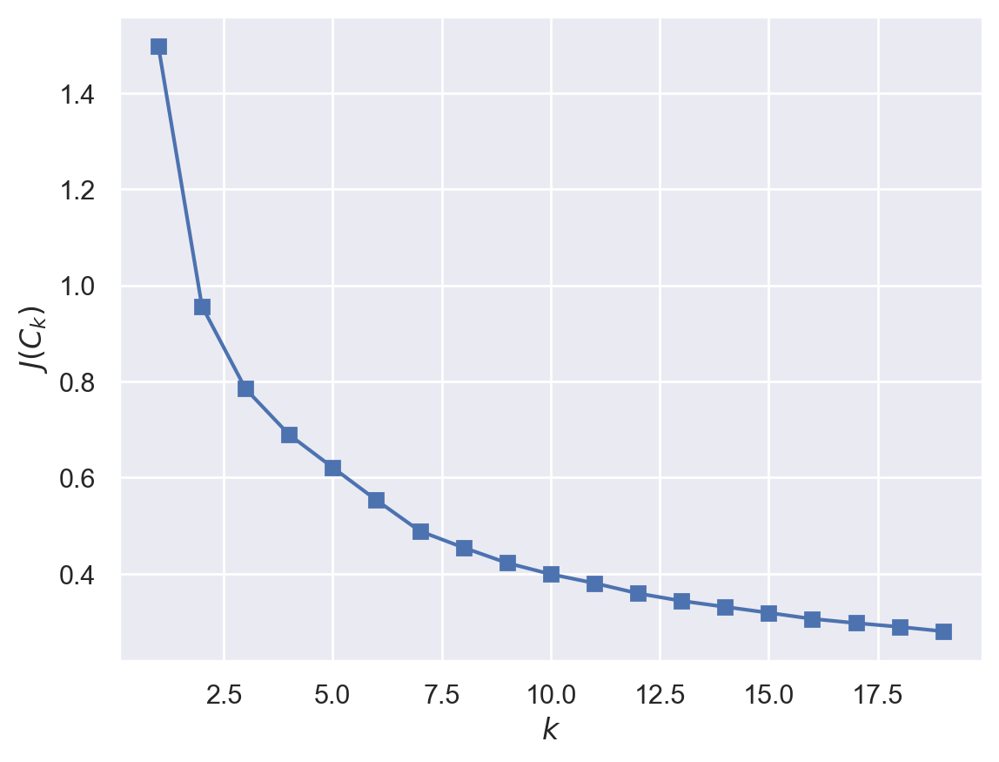

In [329]:
from sklearn import metrics 
from scipy.spatial.distance import cdist

rg = range(1, 20)
inertia = []
for k in rg:
    kmeans = KMeans(n_clusters=k, random_state=13).fit(X)
    inertia.append(np.sqrt(kmeans.inertia_))
    
plt.plot(rg, inertia, marker='s');
plt.xlabel('$k$')
plt.ylabel('$J(C_k)$');

Пожалуй, уместно выделить 3-8 кластеров. Попробуем посмотреть на возможные результаты визуально.

In [330]:
k_means = KMeans(n_clusters=4, random_state=13)
k_means = k_means.fit(X)
clusters = k_means.predict(X)
centers = k_means.cluster_centers_ 

my_map = draw_clustered_map(data, clusters)
for lng, lat in centers:
    # отмечаю центры кластеров
    folium.Circle([lat, lng],
                  radius=500, 
                  fill=True,
                  fill_opacity=0.5,
                  weight=1,
                  opacity=0.8,
                  color='grey').add_to(my_map)
my_map

In [331]:
k_means = KMeans(n_clusters=5, random_state=13)
k_means = k_means.fit(X)
clusters = k_means.predict(X)
centers = k_means.cluster_centers_ 

my_map = draw_clustered_map(data, clusters)
for lng, lat in centers:
    # отмечаю центры кластеров
    folium.Circle([lat, lng],
                  radius=500, 
                  fill=True,
                  fill_opacity=0.5,
                  weight=1,
                  opacity=0.8,
                  color='grey').add_to(my_map)
my_map

In [25]:
k_means = KMeans(n_clusters=7, random_state=13)
k_means = k_means.fit(X)
clusters = k_means.predict(X)
centers = k_means.cluster_centers_ 

my_map = draw_clustered_map(data, clusters)
for lng, lat in centers:
    # отмечаю центры кластеров
    folium.Circle([lat, lng],
                  radius=500, 
                  fill=True,
                  fill_opacity=0.5,
                  weight=1,
                  opacity=0.8,
                  color='grey').add_to(my_map)
my_map

По моему мнению, вариант с 7 кластерами кажется оптимальным. Кластеры неплохо аппроксимируют районы Москвы. В целом, выглядит очень характерно для KMeans. Баланс классов хороший, т.к. кластеры выпуклые.

Просто для эксперимента — как будет выглядеть карта с 10 кластерами:

In [26]:
k_means = KMeans(n_clusters=10, random_state=13)
k_means = k_means.fit(X)
clusters = k_means.predict(X)
centers = k_means.cluster_centers_ 

my_map = draw_clustered_map(data, clusters)
for lng, lat in centers:
    folium.Circle([lat, lng],
                  radius=500, 
                  fill=True,
                  fill_opacity=0.5,
                  weight=1,
                  opacity=0.8,
                  color='grey').add_to(my_map)
my_map

### DBSCAN

Для DBSCAN нет хорошей метрики для сравнения, поэтому будем действовать эксперементальным путем.

В начале попробуем реализацию с гипарпараметрами по умолчанию, затем — будем эксперементировать.

In [27]:
dbscan = DBSCAN(n_jobs=-1)
clusters = dbscan.fit_predict(X)

In [394]:
my_map = draw_clustered_map(data, clusters)
my_map

Получилось, что с `eps=0.5, min_samples=5` все объекты попали в один кластер, причем даже выбросов не нашлось:

In [395]:
np.unique(clusters), dbscan.core_sample_indices_

(array([0], dtype=int64),
 array([   0,    1,    2, ..., 1034, 1035, 1036], dtype=int64))

Попробуем перебрать некоторое количество вариантов `eps`:

In [28]:
# для начала считаем все наблюдения аномальными
outlier_percentage = 1.

num_clusters = []
anomaly_percentage = []

# берем маленький эпсилон и начинаем увеличивать
eps = 0.00001
eps_history = [eps]

while outlier_percentage > 0.1:    
    model = DBSCAN(eps=eps).fit(X)
    
    labels = model.labels_
    num_clusters.append(len(np.unique(labels))-1)
    labels = np.array([1 if label == -1 else 0 for label in labels])
    
    # считаем текущий процент "шума"
    outlier_percentage = sum(labels==1) / len(labels)    
    eps += 0.00001
    eps_history.append(eps)
    anomaly_percentage.append(outlier_percentage)

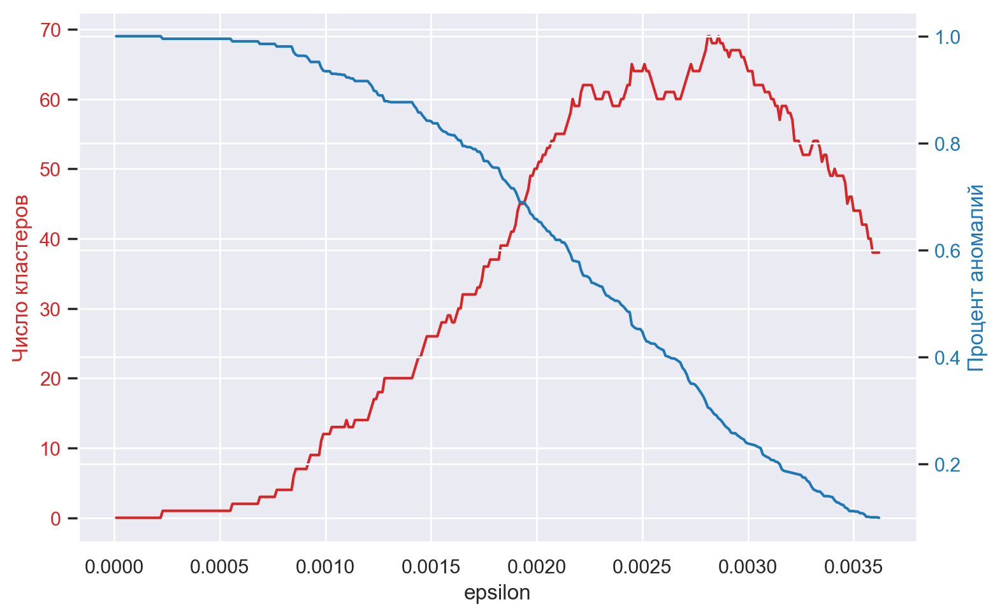

In [29]:
iterations = eps_history[:-1]

fig, ax1 = plt.subplots(figsize=(8,5))
color = 'tab:red'
ax1.set_xlabel('epsilon')
ax1.set_ylabel('Число кластеров', color=color)
ax1.plot(iterations, num_clusters, color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # инициализация второй оси в соотвествии с размером первой

color = 'tab:blue'
ax2.set_ylabel('Процент аномалий', color=color)
ax2.plot(iterations, anomaly_percentage, color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout() 
plt.show()

Чтобы получить адекватное число кластеров и аномалий, логично брать eps примерно в промежутке $[0.0005; 0.001]$

In [392]:
dbscan = DBSCAN(eps=0.0005, n_jobs=-1)
clusters = dbscan.fit_predict(X)

my_map = draw_clustered_map(data, clusters)
my_map

Видно плохо, но на севере у Рижского вокзала есть один-единственный плотный кластер. Остальное — шум.

In [6]:
palette = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf',
           '#e6daa6, #c79fef', 'ebbf90f', '#069af3', '#3d1c02', '#fc5a50', '#7fff00', '#00ffff', '#00008b', '#ffd700',
           '#daa520', '#ffc0cb', '#ffff00', '#008080', '#c0c0c0', '#ff00ff', '#000080', '#808000']

In [420]:
dbscan = DBSCAN(eps=0.0015, n_jobs=-1)
clusters = dbscan.fit_predict(X)

my_map = draw_clustered_map(data, clusters, set_colors=True, users_colors=palette)
my_map

In [421]:
len(np.unique(clusters)) - 1

26

Получилось 26 плотных маленьких кластеров. Нужно увеличить `min_samples`, но тогда нужно будет увеличить и `eps` тоже:

In [465]:
dbscan = DBSCAN(eps=0.015, min_samples=100, n_jobs=-1)
clusters = dbscan.fit_predict(X)

my_map = draw_clustered_map(data, clusters, set_colors=True, users_colors=palette)
my_map

In [466]:
dbscan = DBSCAN(eps=0.005, min_samples=10, n_jobs=-1)
clusters = dbscan.fit_predict(X)

my_map = draw_clustered_map(data, clusters, set_colors=True, users_colors=palette)
my_map

In [467]:
len(np.unique(clusters)) - 1

16

Пожалуй, это самый понятный вариант из опробованных.

Было перепробовано очень много комбинаций и получились следующие варианты, которые были очень чувствительны к изменению гиперпараметра `eps` даже на десятитысячную:
1. Все остановки — выбросы.
2. Все остановки — один кластер.
3. 2-3 больших кластера, более 50% — выбросы.
4. 15-20 небольших кластеров и около 20% выбросов.

Кажется, что последний вариант с 16 кластерами — максимум, который можно выжать из DBSCAN для этой задачи. По моему мнению, этот аглоритм плохо подходит для данной задачи.

**Заключительный пример: изменение `min_samples` с 10 до 12:**

In [476]:
dbscan = DBSCAN(eps=0.005, min_samples=10, n_jobs=-1)
clusters = dbscan.fit_predict(X)

my_map = draw_clustered_map(data, clusters, set_colors=True, users_colors=palette)
my_map

In [477]:
dbscan = DBSCAN(eps=0.005, min_samples=12, n_jobs=-1)
clusters = dbscan.fit_predict(X)

my_map = draw_clustered_map(data, clusters, set_colors=True, users_colors=palette)
my_map

Видно, как чувствительно алгоритм отреагировал на такое небольшое изменениие.

### Спектральная кластеризация

In [39]:
graph_clust = GraphClustering(n_clusters=8)  # n_components=n_clusters
clusters = graph_clust.fit_predict(adjacency_matrix)

centers = graph_clust._get_cluster_centers_()
centers.shape
# я пробовал снизить размерность для визуализации через t-SNE, но получилось очень плохо

(8, 7)

In [41]:
my_map = draw_clustered_map(data, clusters)
my_map

Поменьше кластеров:

In [42]:
graph_clust = GraphClustering(n_clusters=6)  # n_components=n_clusters
clusters = graph_clust.fit_predict(adjacency_matrix)

my_map = draw_clustered_map(data, clusters)
my_map

Побольше кластеров:

In [43]:
graph_clust = GraphClustering(n_clusters=20)  # n_components=n_clusters
clusters = graph_clust.fit_predict(adjacency_matrix)

my_map = draw_clustered_map(data, clusters, set_colors=True, users_colors=palette)
my_map

Меньше кластеров, но больше компонент:

In [44]:
graph_clust = GraphClustering(n_clusters=8, n_components=20)
clusters = graph_clust.fit_predict(adjacency_matrix)

my_map = draw_clustered_map(data, clusters, set_colors=True, users_colors=palette)
my_map

Больше кластеров, меньше компонент:

In [45]:
graph_clust = GraphClustering(n_clusters=12, n_components=6)
clusters = graph_clust.fit_predict(adjacency_matrix)

my_map = draw_clustered_map(data, clusters, set_colors=True, users_colors=palette)
my_map

Из экспериментов я обнаружил, что лучше выбирать больше кластеров, потому что в таком случае выделяются интересные кластеры в виде отдельных магистралей, длинных линий трамваев и т.д.. Также лучшие результаты получаются при `n_clusters` $\le$ `n_components`.

*Вот мой любимый вариант:*

In [61]:
graph_clust = GraphClustering(n_clusters=12, n_components=8)
clusters = graph_clust.fit_predict(adjacency_matrix)

my_map = draw_clustered_map(data, clusters, set_colors=True, users_colors=palette)
my_map

Проинтерпретируйте полученные результаты.

Чем отличаются полученные кластеры?
* *KMeans* — по определению ищет кластеры выпуклой формы. Визуально неплохо подходит для задачи, поскольку хорошо делит Москву на районы. Результаты интерпретируемые, но простые, баланс классов хороший, равномерный.
* *DBSCAN* — невероятно чувствительно реагирует на изменение гиперпараметров приминительно для нашей задачи. Находит кластеры плохой формы или не находит их в целом. Плохо подходит для задачи. Баланс классов чаще всего плохой. Всегда выделяет больше 20% шумовых точек. 
* *Спектральная кластеризация* — находит очень нетривиальные кластеры, но баланс классов может страдать. При небольшом числе кластеров делит ЦАО довольно банально, схоже с KMeans, а при большом числе кластеров и небольшом числе первых компонент — выделяет интересные отдельные длинные маршруты, шоссе, проспекты, магистрали и т.д., которые проходят сквозь весь город.

**Итого**: предсказуемо, учитывая контекст задачи, мне больше всего понравился результат **спектральной кластеризации**. Учитывая, что кластеризация — в принципе слабо интерпретируемая область, спектральная кластеризация находит кластеры, из которых можно получить какую-то интересную информацию про данные: например, какие протяженные и важные маршруты есть в городе, какие связанные между собой маршруты есть. 

KMeans получился интересным, потому что он логично делил Москву на районы, можно посмотреть, где находятся транспортные «центры тяжести» по сосредоточению остановок. Но, в целом, результат банален.

Результат DBSCAN не понравился совершенно.

## Часть 2. Тематическое моделирование текстов

В этой части мы познакомимся с одной из самых популярных задач обучения без учителя &mdash; с задачей тематического моделирования текстов. Допустим, нам доступна некоторая коллекция документов без разметки, и мы хотим автоматически выделить несколько тем, которые встречаются в документах, а также присвоить каждому документу одну (или несколько) тем. Фактически, мы будем решать задачу, похожую на кластеризацию текстов: отличие в том, что нас будет интересовать не только разбиение текстов на группы, но и выделение ключевых слов, определяющих каждую тему.

Мы будем работать с новостными статьями BBC за 2004-2005 годы. Скачаем данные по [ссылке](https://www.kaggle.com/hgultekin/bbcnewsarchive).

In [7]:
data = pd.read_csv('bbc-news-data.csv', sep='\t')
data.sample(5)

,category,filename,title,content
1289,politics,394.txt,Economy focus for election battle,Britain's economic future will be at the hear...
1872,tech,049.txt,Domain system scam fear,A system to make it easier to create website ...
1044,politics,149.txt,Blair returns from peace mission,Prime Minister Tony Blair has arrived back fr...
654,entertainment,145.txt,Sir Paul rocks Super Bowl crowds,Sir Paul McCartney wowed fans with a live min...
134,business,135.txt,Feta cheese battle reaches court,A row over whether only Greece should be allo...


Данные уже содержат разметку по тематике (колонка category). В этой части мы забудем, что она есть, и будем работать только с текстовыми данными. Проведем предобработку текста, состоящую из следующих пунктов:

* Объединим заголовок и содержание статьи в одно поле.
* Приведем текст к нижнему регистру, разобьем его на токены.
* Оставим только буквенные слова (удалив, таким образом, пунктуацию и числа).
* Применим лемматизацию.
* Удалим стоп-слова.

In [8]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

In [9]:
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')

stop_words = set(stopwords.words('english') + ['ha', 'wa', 'say', 'said'])
lemmatizer = WordNetLemmatizer()

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Admin\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Admin\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Admin\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [10]:
def preprocess(text):
    text = list(filter(str.isalpha, word_tokenize(text.lower())))
    text = list(lemmatizer.lemmatize(word) for word in text)
    text = list(word for word in text if word not in stop_words)
    return ' '.join(text)

In [11]:
data['raw_text'] = data.apply(lambda row: row.title + row.content, axis=1)
data['text'] = data.apply(lambda row: preprocess(row.raw_text), axis=1)

In [12]:
data

,category,filename,title,content,raw_text,text
0,business,001.txt,Ad sales boost Time Warner profit,Quarterly profits at US media giant TimeWarne...,Ad sales boost Time Warner profit Quarterly pr...,ad sale boost time warner profit quarterly pro...
1,business,002.txt,Dollar gains on Greenspan speech,The dollar has hit its highest level against ...,Dollar gains on Greenspan speech The dollar ha...,dollar gain greenspan speech dollar hit highes...
2,business,003.txt,Yukos unit buyer faces loan claim,The owners of embattled Russian oil giant Yuk...,Yukos unit buyer faces loan claim The owners o...,yukos unit buyer face loan claim owner embattl...
3,business,004.txt,High fuel prices hit BA's profits,British Airways has blamed high fuel prices f...,High fuel prices hit BA's profits British Airw...,high fuel price hit ba profit british airway b...
4,business,005.txt,Pernod takeover talk lifts Domecq,Shares in UK drinks and food firm Allied Dome...,Pernod takeover talk lifts Domecq Shares in UK...,pernod takeover talk lift domecq share uk drin...
...,...,...,...,...,...,...
2220,tech,397.txt,BT program to beat dialler scams,BT is introducing two initiatives to help bea...,BT program to beat dialler scams BT is introdu...,bt program beat dialler scam bt introducing tw...
2221,tech,398.txt,Spam e-mails tempt net shoppers,Computer users across the world continue to i...,Spam e-mails tempt net shoppers Computer users...,spam tempt net shopper computer user across wo...
2222,tech,399.txt,Be careful how you code,A new European directive could put software w...,Be careful how you code A new European directi...,careful code new european directive could put ...
2223,tech,400.txt,US cyber security chief resigns,The man making sure US computer networks are ...,US cyber security chief resigns The man making...,u cyber security chief resigns man making sure...


Для визуализации частот слов в текстах мы будем использовать [облака тегов](https://en.wikipedia.org/wiki/Tag_cloud).

In [13]:
from wordcloud import WordCloud

def draw_wordcloud(texts, max_words=1000, width=1000, height=500):
    wordcloud = WordCloud(background_color='white', max_words=max_words,
                          width=width, height=height)
    
    joint_texts = ' '.join(list(texts))
    wordcloud.generate(joint_texts)
    return wordcloud.to_image()

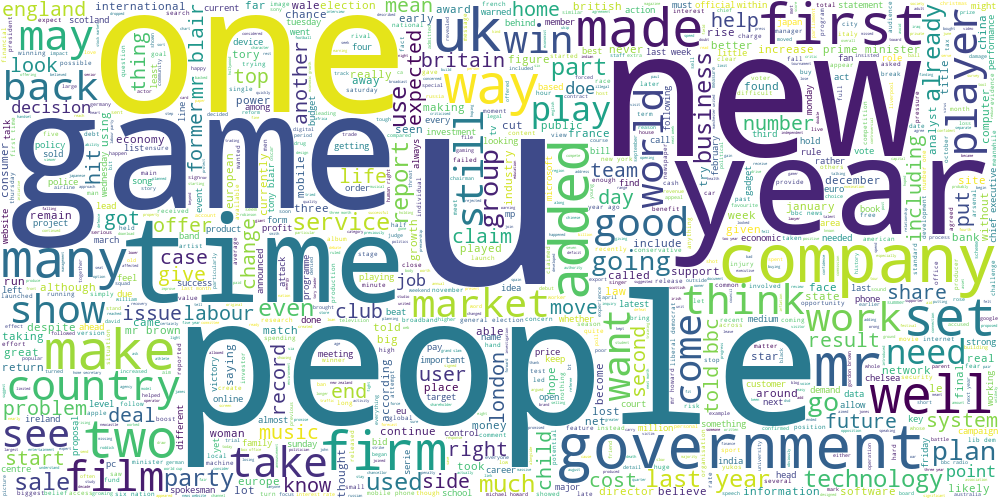

In [15]:
draw_wordcloud(data.text)

Обучим алгоритм K-Means на tf-idf представлениях текстов. При обучении tf-idf векторайзера рекомендуется отбросим редко встречающиеся слова, а также воздержимся от использования N-грамм. Возьмем не очень большое число кластеров, чтобы было удобно интерпретировать получившиеся темы (например, `n_clusters` = 8). Постройте облака тегов для текстов из разных кластеров. Попробуем озаглавить каждую тему.

In [14]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [14]:
# посмотрим, какие категории есть в данных
data['category'].unique()

array(['business', 'entertainment', 'politics', 'sport', 'tech'],
      dtype=object)

In [84]:
# обучаю tf-idf, отбрасывая 0.5% слов по встречаемости
vectorizer = TfidfVectorizer(max_df=1.0, min_df=0.005)
X = vectorizer.fit_transform(data.text)

In [85]:
# удалили почти 20 тыс., оставили чуть больше 4 тыс.
len(vectorizer.stop_words_), len(vectorizer.vocabulary_)

(19944, 4263)

In [86]:
vectorizer.stop_words_

{'lukoil',
 'rebirth',
 'curse',
 'cafe',
 'dardanelles',
 'swelled',
 'depress',
 'receives',
 'surging',
 'cooder',
 'sodje',
 'finn',
 'capitalise',
 'eventful',
 'cvrd',
 'veto',
 'dunst',
 'legislative',
 'kazuhiro',
 'sanyo',
 'unemployed',
 'crowned',
 'infect',
 'mugged',
 'defected',
 'richfield',
 'hairy',
 'farhat',
 'spotless',
 'solo',
 'qualitatively',
 'denham',
 'panayis',
 'rambus',
 'eli',
 'modifying',
 'handel',
 'adductor',
 'clubman',
 'vary',
 'inherit',
 'akroyd',
 'norbert',
 'assumption',
 'daubed',
 'kawa',
 'honeynet',
 'myriad',
 'prevention',
 'eloy',
 'supplementary',
 'renovated',
 'fer',
 'koubek',
 'immunisation',
 'wuthering',
 'bailey',
 'pointedly',
 'gameboyzz',
 'preaching',
 'voltage',
 'personalised',
 'magnate',
 'bungalow',
 'unwittingly',
 'toby',
 'capra',
 'wanda',
 'demeanour',
 'trainor',
 'determines',
 'marquis',
 'ssl',
 'hated',
 'dinosaur',
 'absurd',
 'irritable',
 'castres',
 'jordi',
 'carrington',
 'mastering',
 'loosening',
 'ck

In [88]:
# обучаю kmeans с 6 кластерами
k_means = KMeans(n_clusters=6, random_state=13)
k_means = k_means.fit(X)

clusters = k_means.predict(X)
centers = k_means.cluster_centers_ 

data['cluster'] = clusters

In [92]:
for i in range(len(np.unique(clusters))):
    print(f'Размер кластера {i + 1}: {len(data[data["cluster"] == i])}')

Размер кластера 1: 166
Размер кластера 2: 252
Размер кластера 3: 350
Размер кластера 4: 600
Размер кластера 5: 490
Размер кластера 6: 367


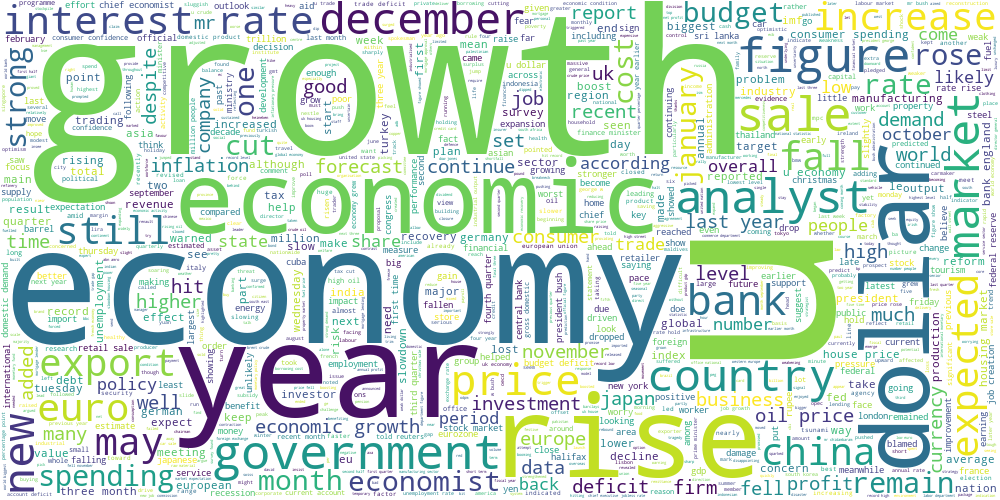

In [93]:
draw_wordcloud(data[data["cluster"] == 0].text)

Этот кластер можно озаглавить как «Экономика и финансы»

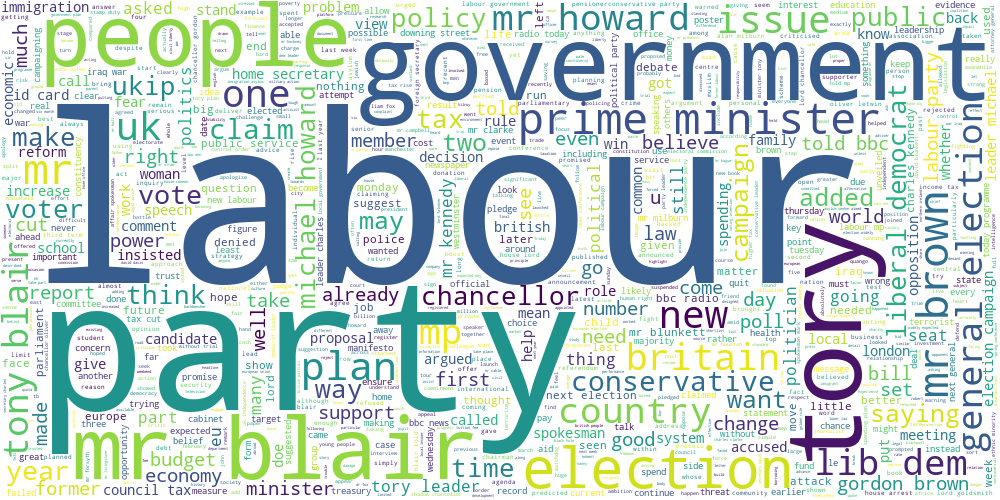

In [94]:
draw_wordcloud(data[data["cluster"] == 1].text)

Это «Политика»

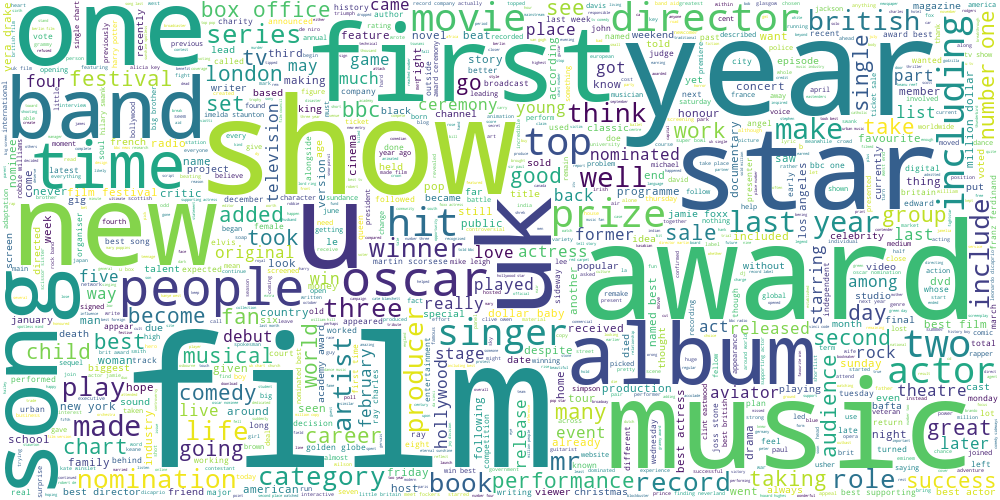

In [95]:
draw_wordcloud(data[data["cluster"] == 2].text)

Этот кластер — «Культура»

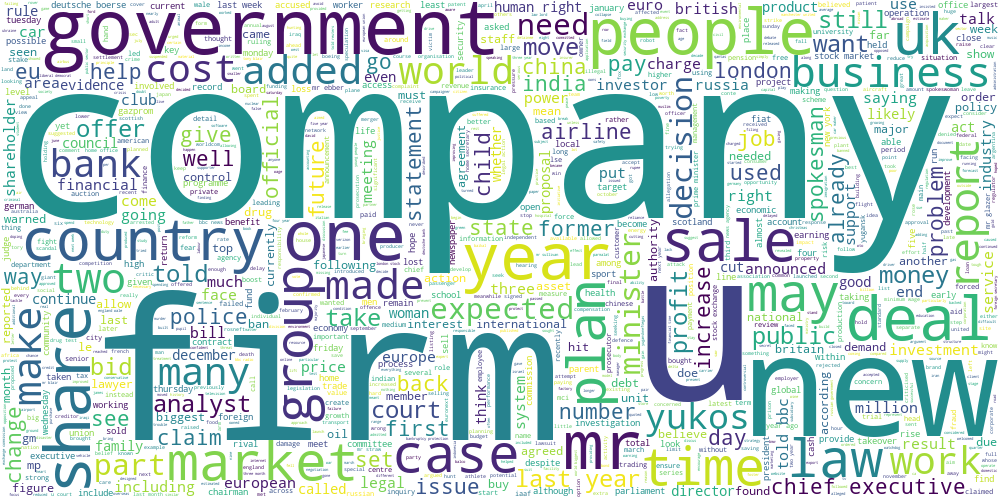

In [96]:
draw_wordcloud(data[data["cluster"] == 3].text)

Это «Деловые новости». Немного отличается от экономики и финансов акцентом в сторону законов, поддержки, чего-то более государственного.

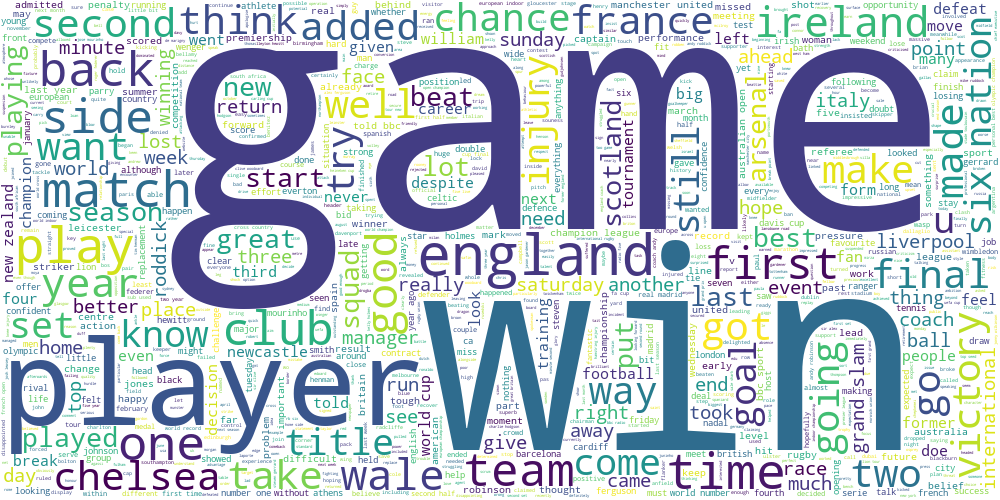

In [97]:
draw_wordcloud(data[data["cluster"] == 4].text)

Это явно «Спорт»

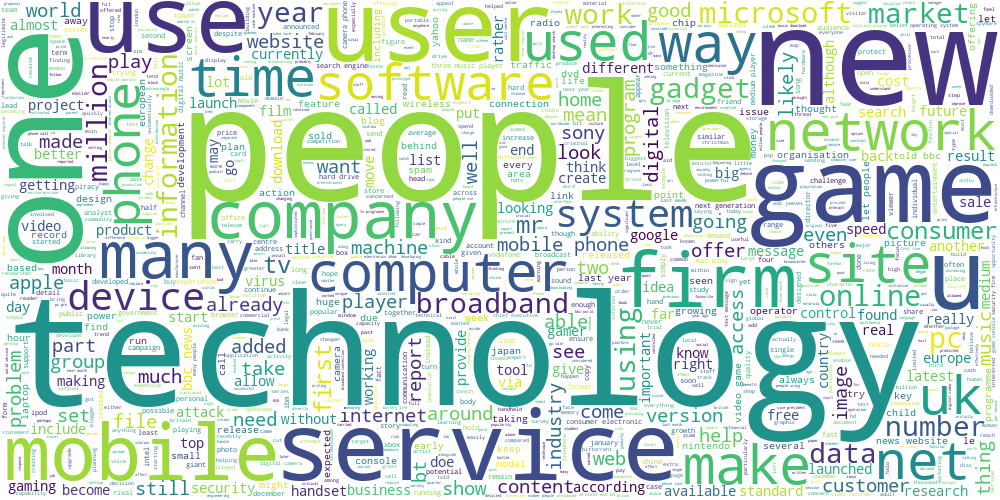

In [98]:
draw_wordcloud(data[data["cluster"] == 5].text)

Это «Технологии»

Попробуем другой способ выделить ключевые слова для каждой темы. Помимо непосредственного разбиения объектов алгоритм K-Means получает центр каждого кластера. Попробуем взять центры кластеров и посмотреть на слова, для которых значения соответствующих им признаков максимальны. Согласуются ли полученные слова с облаками тегов из прошлого задания?

In [15]:
def get_top_keywords(n_terms):
    """
    Функция ищет n_terms самых характерных слов в каждом кластере на основе tf-idf
    param n_terms: сколько слов с самым высоким скором tf-idf нужно вывести для каждого класса

    источник: https://medium.com/mlearning-ai/text-clustering-with-tf-idf-in-python-c94cd26a31e7
    """
    df = pd.DataFrame(X.todense()).groupby(clusters).mean() # groups the TF-IDF vector by cluster
    terms = vectorizer.get_feature_names_out() # access tf-idf terms
    for i,r in df.iterrows():
        print(f'\nКластер {i + 1}')
        print(', '.join([terms[t] for t in np.argsort(r)[-n_terms:]])) # for each row of the dataframe, find the n terms that have the highest tf idf score

In [143]:
get_top_keywords(10)


Кластер 1
market, rise, bank, year, dollar, economic, price, rate, growth, economy

Кластер 2
would, howard, tax, brown, tory, blair, party, election, labour, mr

Кластер 3
album, year, actor, music, band, show, star, best, award, film

Кластер 4
law, new, deal, year, would, government, share, firm, mr, company

Кластер 5
team, injury, champion, club, cup, match, win, player, england, game

Кластер 6
digital, net, service, computer, game, user, technology, people, phone, mobile


**Ответ**: да, слова очень сильно согласуются с облаками слов выше. По этим словам можно точно понять, какие новости попали в кластер, даже лучше, чем по облакам слов. Все выделенные слова встречались в облаках слов, но «шумовых» слов уже нет.

В первой части мы сравнили три разных алгоритма кластеризации на географических данных. Проделаем то же самое для текстовых данных (в качестве признакого описания снова используем tf-idf). Получите три разбиения на кластеры с помощью алгоритмов K-Means, DBSCAN и спектральной кластеризации (на этот раз воспользуйтесь реализацией из `sklearn`). Для K-Means и спектральной кластеризации возьмите одинаковое небольшое число кластеров, подберите параметр `eps` метода DBSCAN так, чтобы получить приблизительно такое же число кластеров.

Далее, обучим двухмерные t-SNE представления над tf-idf признаками текстов. Визуализируйте эти представления для каждого алгоритма, раскрасив каждый кластер своим цветом. Учтем, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).

In [15]:
from sklearn.manifold import TSNE

In [146]:
# обучаем k-means
k_means = KMeans(n_clusters=6, random_state=13)
k_means = k_means.fit(X)
clusters_k_means = k_means.predict(X)
centers_k_means = k_means.cluster_centers_ 

In [147]:
# спектральная кластеризация
spectral_clust = SpectralClustering(n_clusters=6, random_state=13)
clusters_spectral = spectral_clust.fit_predict(X)

In [250]:
# обучаем dbscan
dbscan = DBSCAN(eps=1.2, min_samples=13, n_jobs=-1)  # eps=1.24, min_samples=19 тоже неплохо
clusters_dbscan = dbscan.fit_predict(X)

In [251]:
np.unique(clusters_dbscan)  # получилось 7 кластеров

array([-1,  0,  1,  2,  3,  4,  5,  6], dtype=int64)

In [164]:
tsne = TSNE(n_components=2, perplexity=30.0, random_state=13, learning_rate='auto', init='random', n_jobs=-1)
X_embedded = tsne.fit_transform(X)

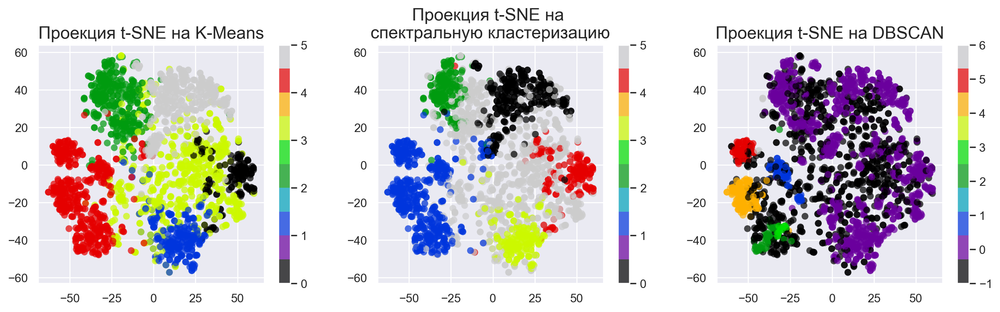

In [260]:
# основа для визуализации взята из сема 14 по МО-2
np.random.seed(13)

plt.figure(figsize=(16, 4))
plt.subplot(1, 3, 1)
# визуализируем k-means
plt.scatter(X_embedded[:, 0], X_embedded[:, 1], c=clusters_k_means, 
            edgecolor='none', alpha=0.7, s=40,
            cmap=plt.cm.get_cmap('nipy_spectral', 10))
plt.colorbar()
plt.title('Проекция t-SNE на K-Means', fontsize=16)
# визуализируем спектральную кластеризацию
plt.subplot(1, 3, 2)
plt.scatter(X_embedded[:, 0], X_embedded[:, 1], c=clusters_spectral, 
            edgecolor='none', alpha=0.7, s=40,
            cmap=plt.cm.get_cmap('nipy_spectral', 10))
plt.colorbar()
plt.title('Проекция t-SNE на \nспектральную кластеризацию', fontsize=16)
# визуализируем dbscan
plt.subplot(1, 3, 3)
plt.scatter(X_embedded[:, 0], X_embedded[:, 1], c=clusters_dbscan, 
            edgecolor='none', alpha=0.7, s=40,
            cmap=plt.cm.get_cmap('nipy_spectral', 10))
plt.colorbar()
plt.title('Проекция t-SNE на DBSCAN', fontsize=16)

plt.show()

In [254]:
print(f'У DBSCAN {round(np.sum(clusters_dbscan == -1) / len(clusters_dbscan) * 100, 2)}% шумовых точек')

У DBSCAN 38.52% шумовых точек


Получилось, что DBSCAN выделяет почти 40% шумовых точек (новостей), потому что они лежат слишком разрозненно относительно друг друга для этого алгоритма. Такая же проблема была с остановками в задании выше.

В ходе экспериментов было выяснено, что при попытке поднятия гиперпараметра `eps` для DBSCAN новости либо схлопываются в 1 большой кластер, либо превращаются в два кластера: левую и правую части, что становится плохо интерпретируемым.

Про **баланс** кластеров:

In [266]:
print('K-Means\n')
for i in range(len(np.unique(clusters_k_means))):
    print(f'Размер кластера {i + 1}: {np.sum(clusters_k_means == i)} ({round(np.sum(clusters_k_means == i) / len(clusters_k_means) * 100)}%)')

K-Means

Размер кластера 1: 166 (7%)
Размер кластера 2: 252 (11%)
Размер кластера 3: 350 (16%)
Размер кластера 4: 600 (27%)
Размер кластера 5: 490 (22%)
Размер кластера 6: 367 (16%)


In [269]:
print('Спектральная кластеризация\n')
for i in range(len(np.unique(clusters_spectral))):
    print(f'Размер кластера {i + 1}: {np.sum(clusters_spectral == i)} ({round(np.sum(clusters_spectral == i) / len(clusters_spectral) * 100)}%)')

Спектральная кластеризация

Размер кластера 1: 315 (14%)
Размер кластера 2: 492 (22%)
Размер кластера 3: 186 (8%)
Размер кластера 4: 198 (9%)
Размер кластера 5: 185 (8%)
Размер кластера 6: 849 (38%)


In [275]:
print('DBSCAN\n')
for i in range(-1, len(np.unique(clusters_dbscan)) - 1):
    if i == -1:
        print(f'Шумовых точек: {np.sum(clusters_dbscan == i)} ({round(np.sum(clusters_dbscan == i) / len(clusters_dbscan) * 100)}%)')
    print(f'Размер кластера {i + 1}: {np.sum(clusters_dbscan == i)} ({round(np.sum(clusters_dbscan == i) / len(clusters_dbscan) * 100)}%)')

DBSCAN

Шумовых точек: 857 (39%)
Размер кластера 0: 857 (39%)
Размер кластера 1: 1046 (47%)
Размер кластера 2: 68 (3%)
Размер кластера 3: 56 (3%)
Размер кластера 4: 14 (1%)
Размер кластера 5: 114 (5%)
Размер кластера 6: 62 (3%)
Размер кластера 7: 8 (0%)


Прокомментируйте получившиеся результаты. Какой баланс кластеров получился у разных методов? Соотносятся ли визуализации для текстов с визуализациями для географических данных?

**Ответ:** 

Применительно к данной задаче больше всего мне нравятся результаты работы спектральной кластеризации и K-Means — они почти неотличимы. Баланс их кластеров получился близким к равномерному, результат интерпретируемый (видели ранее).

Результат K-Means и DBSCAN **похож** на тот, который был получен для географических данных. K-Means находит довольно тривиальные выпуклые кластеры, DBSCAN выделяет очень плотные кластеры и много шумовых точек, при этом он все так же гиперчувствителен к изменению гиперпараметров и может резко свалиться в один кластер или отнести 99% точек к шумовым.

Результат спектральной кластеризации **отличается** от варианта, полученного для географических данных. Здесь он очень похож на результат K-Means. Думаю, что это логично, учитывая, что данные очень явно можно разделить на n-е число кластеров: по 2-мерной проекции хорошо видна структура данных. Однако, в отличие от K-Means, спектр. кластеризация выделила в один большой класс разреженную область точек в центре. Это интересное наблюдение, но из-за этого баланс классов нарушился.

В целом, я бы сказал, что для меня алгоритмы кластеризации для этой задачи ранжируются так же, как и выше: *спектральная кластеризация, K-Means, DBSCAN*. Причем результат работы DBSCAN снова категорически не понравился.

Обучим модель латентного размещения Дирихле. Не забудем, что она работает с мешком слов, а не с tf-idf признаками. Возьмем параметр `n_components` в 2-3 раза больше, чем число кластеров для K-Means. Проверим, получились ли темы более узкими от такого нововведения. Построим облака тегов для нескольких наиболее удачных тем.

In [16]:
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.feature_extraction.text import CountVectorizer

In [291]:
# применяем bag of words с теми же параметрами
bag_of_words_vect = CountVectorizer(max_df=1.0, min_df=0.005)
bag_of_words = bag_of_words_vect.fit_transform(data.text)
feature_names = bag_of_words_vect.get_feature_names_out()

In [292]:
# размер матрицы такой же, как с tf-idf, т.к. я не менял шорткат
bag_of_words.shape

(2225, 4263)

In [338]:
# обучаю модель
lda = LatentDirichletAllocation(n_components=15, max_iter=50, evaluate_every=3, n_jobs=-1, random_state=13, verbose=1)
lda.fit(bag_of_words)

iteration: 1 of max_iter: 50
iteration: 2 of max_iter: 50
iteration: 3 of max_iter: 50, perplexity: 1713.9792
iteration: 4 of max_iter: 50
iteration: 5 of max_iter: 50
iteration: 6 of max_iter: 50, perplexity: 1543.2937
iteration: 7 of max_iter: 50
iteration: 8 of max_iter: 50
iteration: 9 of max_iter: 50, perplexity: 1494.5082
iteration: 10 of max_iter: 50
iteration: 11 of max_iter: 50
iteration: 12 of max_iter: 50, perplexity: 1470.8567
iteration: 13 of max_iter: 50
iteration: 14 of max_iter: 50
iteration: 15 of max_iter: 50, perplexity: 1457.3288
iteration: 16 of max_iter: 50
iteration: 17 of max_iter: 50
iteration: 18 of max_iter: 50, perplexity: 1449.0804
iteration: 19 of max_iter: 50
iteration: 20 of max_iter: 50
iteration: 21 of max_iter: 50, perplexity: 1443.9527
iteration: 22 of max_iter: 50
iteration: 23 of max_iter: 50
iteration: 24 of max_iter: 50, perplexity: 1440.2095
iteration: 25 of max_iter: 50
iteration: 26 of max_iter: 50
iteration: 27 of max_iter: 50, perplexity: 14

LatentDirichletAllocation(evaluate_every=3, max_iter=50, n_components=15,
                          n_jobs=-1, random_state=13, verbose=1)

In [340]:
# считаю вероятности и проставляю метки кластеров
labels_prob = lda.transform(bag_of_words)
labels = np.argmax(labels_prob, axis=1)

# добавляю метки в исходный датасет
data['cluster'] = labels

In [341]:
# посмотрим на самые вероятные слова в каждом из кластеров
# на основе этого распределения решим, по каким кластерам интересно построить облако слов
# источник: https://towardsdatascience.com/latent-dirichlet-allocation-for-topic-modelling-explained-algorithm-and-python-scikit-learn-c65a82e7304d

for idx, topic in enumerate(lda.components_):
    print ("Topic ", idx, " ".join(feature_names[i] for i in topic.argsort()[:-10 - 1:-1]))

Topic  0 mobile technology game phone people digital new music also video
Topic  1 people user net service software site firm information internet system
Topic  2 mr company share bid offer would executive firm new chief
Topic  3 company firm china sale yukos oil deal india year new
Topic  4 mr law court lord legal case action rule government company
Topic  5 england wale ireland game side six rugby minute first player
Topic  6 mr labour party would election blair tory minister howard mp
Topic  7 people child school would right woman police year life new
Topic  8 year growth price market economy rate sale bank month profit
Topic  9 drug test sport ban jackson also kenteris greek decision iaaf
Topic  10 film best award year show star also actor director tv
Topic  11 government tax would country year mr eu also budget plan
Topic  12 world year win first champion final second set open last
Topic  13 game would club think like time player want good one
Topic  14 music song band album chart

In [342]:
# посмотрим на баланс классов

for i in range(len(np.unique(labels))):
    print(f'Размер кластера {i}: {len(data[data["cluster"] == i])}')

Размер кластера 0: 217
Размер кластера 1: 174
Размер кластера 2: 71
Размер кластера 3: 97
Размер кластера 4: 85
Размер кластера 5: 171
Размер кластера 6: 244
Размер кластера 7: 81
Размер кластера 8: 237
Размер кластера 9: 36
Размер кластера 10: 262
Размер кластера 11: 156
Размер кластера 12: 166
Размер кластера 13: 177
Размер кластера 14: 51


Посмотрим на самые интересные варианты кластеров:

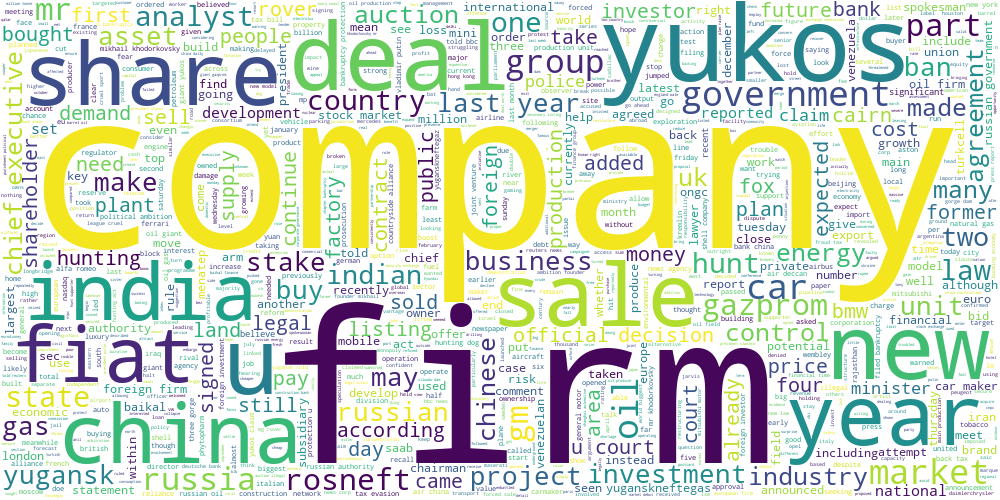

In [343]:
draw_wordcloud(data[data["cluster"] == 3].text)

Категорию выше можно назвать **«Международной торговлей»** — причем в уклоном в сторону нефти: ЮКОС, газ, Газпром, Роснефть, нефть.

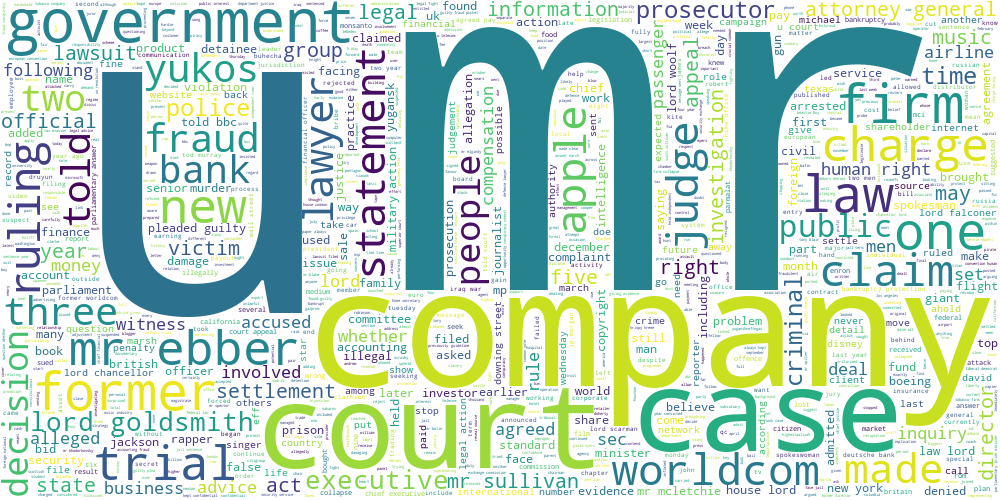

In [344]:
draw_wordcloud(data[data["cluster"] == 4].text)

Эта категория про **«Юриспруденцию»**: права, легально, нелегально, суд, судья, закон, регулирование, ЮКОС (возмоно, в контексте уголовного преследования в России).

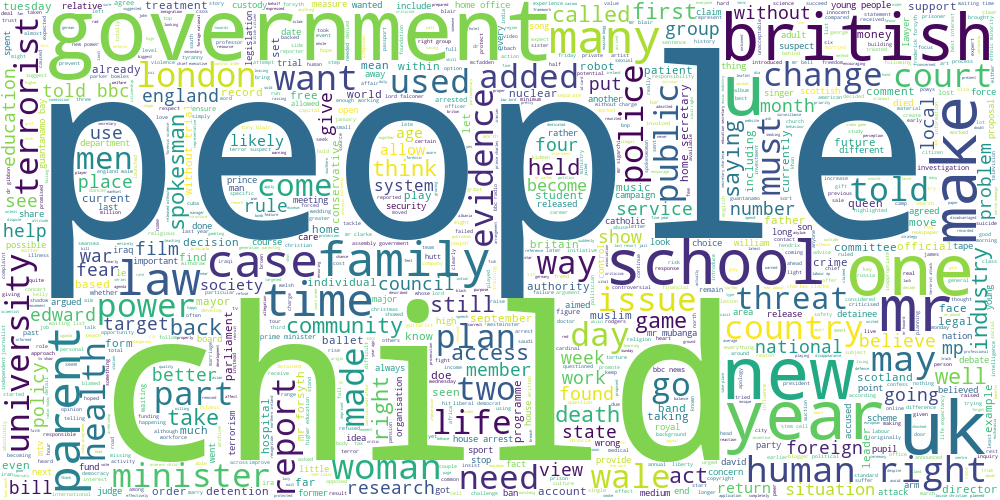

In [345]:
draw_wordcloud(data[data["cluster"] == 7].text)

Эта категория очень похожа на **«Социальную сферу»**: дети, люди, женщина, университет, школа, здоровье, общество.

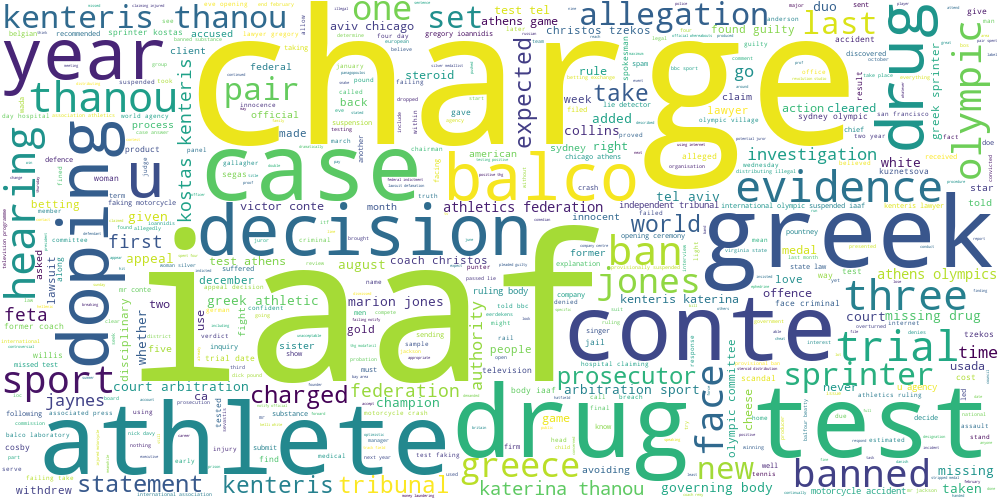

In [346]:
draw_wordcloud(data[data["cluster"] == 9].text)

В этой категории говорится про **«Спортивные ограничения»**: Международная ассоциация легкоатлетических федераций (IAAF), обвинение, допинг, тест, бан, спортивный трибунал, доказательство, лекарства, олимпиада, ряд разных фамилий людей, которые, вероятно, попали под ограничения.

Нужно отметить, что кластер очень маленький: всего 36 новостей.

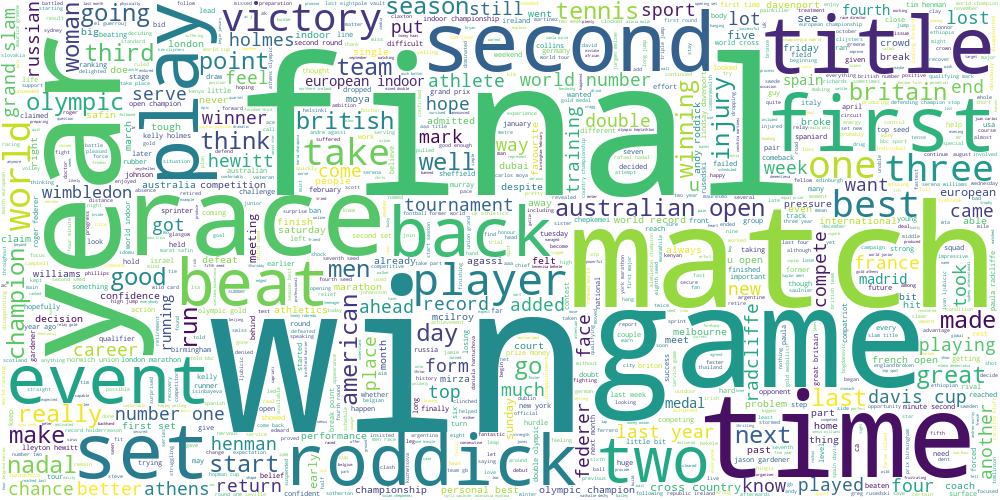

In [347]:
draw_wordcloud(data[data["cluster"] == 12].text)

А здесь, наоброт, **«Спортивные победы**: победа, финал, первый, победил, чемпион, ряд фамилий знаменитых спортсменов (причем теннисистов: Надаль, Роддик, Уильямс — возможно, это связано с новостями про Уимбилдон), разные турниры и персональные премии. 

***Вывод***: модель латентного размещения Дирихле действительно позволяет находить более сложные, узкие и интересные темы в текстовых последовательностях. Однако баланс кластеров получается очень разным (логично).

## Часть 3. Transfer learning для задачи классификации текстов

Вспомним, что у нас есть разметка для тематик статей. Попробуем обучить классификатор поверх unsupervised-представлений для текстов. Рассмотрим три модели:

* Логистическая регрессия на tf-idf признаках
* K-Means на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров
* Латентное размещение Дирихле + логистическая регрессия на вероятностях тем

Разделим выборку на обучающую и тестовую, замерим accuracy на обоих выборках для всех трех моделей.

In [17]:
from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

In [18]:
# создаю правильные ответы
le = LabelEncoder()
y = le.fit_transform(data['category'])
data['y'] = y

In [19]:
data.sample(5)

,category,filename,title,content,raw_text,text,y
1900,tech,077.txt,Rich pickings for hi-tech thieves,"Viruses, trojans and other malicious programs...","Rich pickings for hi-tech thieves Viruses, tro...",rich picking thief virus trojan malicious prog...,4
357,business,358.txt,Deutsche attacks Yukos case,German investment bank Deutsche Bank has chal...,Deutsche attacks Yukos case German investment ...,deutsche attack yukos case german investment b...,0
1975,tech,152.txt,New Year's texting breaks record,A mobile phone was as essential to the recent...,New Year's texting breaks record A mobile phon...,new year texting break record mobile phone ess...,4
829,entertainment,320.txt,Johnny Cash manager Holiff dies,"The former manager of Johnny Cash, Saul Israe...",Johnny Cash manager Holiff dies The former man...,johnny cash manager holiff dy former manager j...,1
21,business,022.txt,Sluggish economy hits German jobs,The number of people out of work in Europe's ...,Sluggish economy hits German jobs The number o...,sluggish economy hit german job number people ...,0


In [21]:
X_train, X_test, y_train, y_test = train_test_split(data.drop('y', axis=1), y, test_size=0.25, random_state=13)

In [25]:
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((1668, 6), (557, 6), (1668,), (557,))

### Логистическая регрессия на tf-idf признаках

In [27]:
vectorizer = TfidfVectorizer(max_df=1.0, min_df=0.005)
X_train_tf_idf = vectorizer.fit_transform(X_train.text)
X_test_tf_idf = vectorizer.transform(X_test.text)

In [30]:
X_train_tf_idf.shape, X_test_tf_idf.shape

((1668, 4369), (557, 4369))

In [31]:
lr = LogisticRegression(random_state=13, max_iter=1000, n_jobs=-1)
lr.fit(X_train_tf_idf, y_train)

LogisticRegression(max_iter=1000, n_jobs=-1, random_state=13)

In [32]:
lr_pred_train = lr.predict(X_train_tf_idf)
lr_pred_test = lr.predict(X_test_tf_idf)

acc_lr_train = accuracy_score(y_train, lr_pred_train)
acc_lr_test = accuracy_score(y_test, lr_pred_test)

print(f'Accuracy train: {round(acc_lr_train, 4)} \
      \nAccuracy test:  {round(acc_lr_test, 4)}')

Accuracy train: 0.9958       
Accuracy test:  0.9695


In [86]:
# dataframe для сравнения 
# методов классификации по метрикам
df_metrics = pd.DataFrame(columns=['accuracy train', 
                                   'accuracy test',
                                   'C (коэф. рег.)'])

# добавление очередной строки с характеристиками метода
df_metrics.loc['tf-idf + logreg (base)'] = [
    0.9958,
    0.9695,
    1.0
]

Теперь попробую подобрать коэф. регуляризации по лог. шкале:

In [36]:
c = np.logspace(-2, 5, 50)
parameters = {'C': c}

grid_search = GridSearchCV(lr, parameters, cv=3, n_jobs=-1, verbose=1)
grid_search.fit(X_train_tf_idf, y_train)

Fitting 3 folds for each of 50 candidates, totalling 150 fits


GridSearchCV(cv=3,
             estimator=LogisticRegression(max_iter=1000, n_jobs=-1,
                                          random_state=13),
             n_jobs=-1,
             param_grid={'C': array([1.00000000e-02, 1.38949549e-02, 1.93069773e-02, 2.68269580e-02,
       3.72759372e-02, 5.17947468e-02, 7.19685673e-02, 1.00000000e-01,
       1.38949549e-01, 1.93069773e-01, 2.68269580e-01, 3.72759372e-01,
       5.17947468e-01, 7.19685673e-01, 1.00000000e+00, 1.38...
       2.68269580e+01, 3.72759372e+01, 5.17947468e+01, 7.19685673e+01,
       1.00000000e+02, 1.38949549e+02, 1.93069773e+02, 2.68269580e+02,
       3.72759372e+02, 5.17947468e+02, 7.19685673e+02, 1.00000000e+03,
       1.38949549e+03, 1.93069773e+03, 2.68269580e+03, 3.72759372e+03,
       5.17947468e+03, 7.19685673e+03, 1.00000000e+04, 1.38949549e+04,
       1.93069773e+04, 2.68269580e+04, 3.72759372e+04, 5.17947468e+04,
       7.19685673e+04, 1.00000000e+05])},
             verbose=1)

In [37]:
grid_search.best_params_, grid_search.best_score_

({'C': 268.26957952797216}, 0.9760191846522782)

In [38]:
lr_pred_train = grid_search.predict(X_train_tf_idf)
lr_pred_test = grid_search.predict(X_test_tf_idf)

acc_lr_train = accuracy_score(y_train, lr_pred_train)
acc_lr_test = accuracy_score(y_test, lr_pred_test)

print(f'Accuracy train: {round(acc_lr_train, 4)} \
      \nAccuracy test:  {round(acc_lr_test, 4)}')

Accuracy train: 1.0       
Accuracy test:  0.9749


In [87]:
# добавление очередной строки с характеристиками метода
df_metrics.loc['tf-idf + logreg (CV)'] = [
    1.0,
    0.9749,
    268.3
]

df_metrics

,accuracy train,accuracy test,C (коэф. рег.)
tf-idf + logreg (base),0.9958,0.9695,1.0
tf-idf + logreg (CV),1.0000,0.9749,268.3


### K-Means на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров

Возьму 8 кластеров, как по умолчанию в K-Means.

In [69]:
k_means = KMeans(n_clusters=8, random_state=13)  # n_clusters=8 по умолч
k_means = k_means.fit(X_train_tf_idf)
clusters = k_means.predict(X_train_tf_idf)
centers = k_means.cluster_centers_ 

In [70]:
centers.shape

(8, 4369)

Для удобства расчета расстояния до центров кластера в векторном виде я применю обученный на `train`-е `vectorizer` ко всей выборке, посчитаю расстояния, а затем разделю на обучающую и тестовую выборки в той же пропорции и с тем же сидом, как выше.

In [71]:
X_tf_idf = vectorizer.transform(data.text)

In [72]:
X_tf_idf.shape

(2225, 4369)

In [73]:
cluster_data = data.copy()  # сюда я буду записывать расстояние до кластеров
X_tf_idf = vectorizer.transform(data.text)

for i in range(centers.shape[0]):
    # для каждого центра кластера
    # превращаем каждый центр в строку
    one_center_as_row = centers[i].reshape(-1, 1).T
    # создаю матрицу из единиц одного размера с X_tf_idf
    ones = np.ones(X_tf_idf.shape)  # (2225, 4369)
    # дублирую центры кластеров до размера X_tf_idf
    one_center_as_matrix = one_center_as_row * ones
    # считаю расстояние до центра i-го кластера для каждого объекта (новости)
    norm = np.linalg.norm(one_center_as_matrix - X_tf_idf, axis=1)

    # записываем расстояние до каждого кластера для каждого объекта (новости)
    cluster_data['dist_to_clust_' + str(i)] = norm

In [74]:
cluster_data.sample(5)

,category,filename,title,content,raw_text,text,y,dist_to_clust_0,dist_to_clust_1,dist_to_clust_2,dist_to_clust_3,dist_to_clust_4,dist_to_clust_5,dist_to_clust_6,dist_to_clust_7
1626,sport,314.txt,O'Driscoll saves Irish blushes,Two moments of magic from Brian O'Driscoll gu...,O'Driscoll saves Irish blushes Two moments of ...,save irish blush two moment magic brian guided...,3,1.004958,1.059984,1.020334,1.027773,0.962391,1.049790,1.044175,1.016327
482,business,483.txt,Ailing EuroDisney vows turnaround,"EuroDisney, the European home of Mickey Mouse...","Ailing EuroDisney vows turnaround EuroDisney, ...",ailing eurodisney vow turnaround eurodisney eu...,0,0.992685,1.054408,0.955965,1.011150,1.016677,1.042783,1.015769,1.029235
1081,politics,186.txt,Blair says mayor should apologise,Tony Blair has urged London mayor Ken Livings...,Blair says mayor should apologise Tony Blair h...,blair mayor apologise tony blair urged london ...,2,0.977485,0.937510,1.007102,1.018530,1.008659,1.045573,1.038575,1.027940
805,entertainment,296.txt,Snow Patrol bassist exits group,"Snow Patrol had ""no other course of action"" b...",Snow Patrol bassist exits group Snow Patrol ha...,snow patrol bassist exit group snow patrol cou...,1,0.969928,1.053164,1.013824,1.020338,1.009230,1.007274,1.037988,1.013517
578,entertainment,069.txt,Foxx and Swank take actors awards,Jamie Foxx and Hilary Swank have won the Scre...,Foxx and Swank take actors awards Jamie Foxx a...,foxx swank take actor award jamie foxx hilary ...,1,0.999755,1.061861,1.023135,1.028312,1.020484,0.895244,1.041396,1.028813


In [75]:
dist_cluster_data = cluster_data[cluster_data.columns[7:]]
y = cluster_data['y']

In [76]:
X_train, X_test, y_train, y_test = train_test_split(dist_cluster_data, y, test_size=0.25, random_state=13)

In [77]:
lr = LogisticRegression(random_state=13, max_iter=1000, n_jobs=-1)
lr.fit(X_train, y_train)

LogisticRegression(max_iter=1000, n_jobs=-1, random_state=13)

In [82]:
lr_pred_train = lr.predict(X_train)
lr_pred_test = lr.predict(X_test)

acc_lr_train = accuracy_score(y_train, lr_pred_train)
acc_lr_test = accuracy_score(y_test, lr_pred_test)

print(f'Accuracy train: {round(acc_lr_train, 4)} \
      \nAccuracy test:  {round(acc_lr_test, 4)}')

Accuracy train: 0.8711       
Accuracy test:  0.8366


In [88]:
df_metrics.loc['KMeans (tf-idf) + logreg (center dist.) (base)'] = [
    0.8711,
    0.8366,
    1.0
]

Скорее всего, модель склонна переобучаться, поэтому нужно подобрать гиперпараметр, отвечающий за регуляризацию.

In [79]:
# переберем по логарифмической сетке
c = np.logspace(-2, 5, 50)
parameters = {'C': c}

grid_search = GridSearchCV(lr, parameters, cv=3, n_jobs=-1, verbose=3)
grid_search.fit(X_train, y_train)

Fitting 3 folds for each of 50 candidates, totalling 150 fits


GridSearchCV(cv=3,
             estimator=LogisticRegression(max_iter=1000, n_jobs=-1,
                                          random_state=13),
             n_jobs=-1,
             param_grid={'C': array([1.00000000e-02, 1.38949549e-02, 1.93069773e-02, 2.68269580e-02,
       3.72759372e-02, 5.17947468e-02, 7.19685673e-02, 1.00000000e-01,
       1.38949549e-01, 1.93069773e-01, 2.68269580e-01, 3.72759372e-01,
       5.17947468e-01, 7.19685673e-01, 1.00000000e+00, 1.38...
       2.68269580e+01, 3.72759372e+01, 5.17947468e+01, 7.19685673e+01,
       1.00000000e+02, 1.38949549e+02, 1.93069773e+02, 2.68269580e+02,
       3.72759372e+02, 5.17947468e+02, 7.19685673e+02, 1.00000000e+03,
       1.38949549e+03, 1.93069773e+03, 2.68269580e+03, 3.72759372e+03,
       5.17947468e+03, 7.19685673e+03, 1.00000000e+04, 1.38949549e+04,
       1.93069773e+04, 2.68269580e+04, 3.72759372e+04, 5.17947468e+04,
       7.19685673e+04, 1.00000000e+05])},
             verbose=3)

In [80]:
grid_search.best_params_, grid_search.best_score_

({'C': 71968.56730011514}, 0.9646282973621103)

In [81]:
lr_pred_train = grid_search.predict(X_train)
lr_pred_test = grid_search.predict(X_test)

acc_lr_train = accuracy_score(y_train, lr_pred_train)
acc_lr_test = accuracy_score(y_test, lr_pred_test)

print(f'Accuracy train: {round(acc_lr_train, 4)} \
      \nAccuracy test:  {round(acc_lr_test, 4)}')

Accuracy train: 0.9682       
Accuracy test:  0.9443


Получилось намного лучше.

In [89]:
df_metrics.loc['KMeans (tf-idf) + logreg (center dist.) (CV)'] = [
    0.9682,
    0.9443,
    71968.6
]

df_metrics

,accuracy train,accuracy test,C (коэф. рег.)
tf-idf + logreg (base),0.9958,0.9695,1.0
tf-idf + logreg (CV),1.0000,0.9749,268.3
KMeans (tf-idf) + logreg (center dist.) (base),0.8711,0.8366,1.0
KMeans (tf-idf) + logreg (center dist.) (CV),0.9682,0.9443,71968.6


### Латентное размещение Дирихле + логистическая регрессия на вероятностях тем

In [102]:
X_train, X_test, y_train, y_test = train_test_split(data.drop('y', axis=1), y, test_size=0.25, random_state=13)

In [103]:
# обучаем и применяем bag of words
bag_of_words_vect = CountVectorizer(max_df=1.0, min_df=0.005)
X_train_bow = bag_of_words_vect.fit_transform(X_train.text)
X_test_bow = bag_of_words_vect.transform(X_test.text)
feature_names = bag_of_words_vect.get_feature_names_out()

In [104]:
X_train_bow.shape, X_test_bow.shape

((1668, 4369), (557, 4369))

In [105]:
# обучаю модель
# взял n_components побольше
lda = LatentDirichletAllocation(n_components=10, max_iter=50, evaluate_every=10, n_jobs=-1, random_state=13, verbose=1)  # n_components=10 по умолч
lda.fit(X_train_bow)

iteration: 1 of max_iter: 50
iteration: 2 of max_iter: 50
iteration: 3 of max_iter: 50
iteration: 4 of max_iter: 50
iteration: 5 of max_iter: 50
iteration: 6 of max_iter: 50
iteration: 7 of max_iter: 50
iteration: 8 of max_iter: 50
iteration: 9 of max_iter: 50
iteration: 10 of max_iter: 50, perplexity: 1586.1164
iteration: 11 of max_iter: 50
iteration: 12 of max_iter: 50
iteration: 13 of max_iter: 50
iteration: 14 of max_iter: 50
iteration: 15 of max_iter: 50
iteration: 16 of max_iter: 50
iteration: 17 of max_iter: 50
iteration: 18 of max_iter: 50
iteration: 19 of max_iter: 50
iteration: 20 of max_iter: 50, perplexity: 1556.1648
iteration: 21 of max_iter: 50
iteration: 22 of max_iter: 50
iteration: 23 of max_iter: 50
iteration: 24 of max_iter: 50
iteration: 25 of max_iter: 50
iteration: 26 of max_iter: 50
iteration: 27 of max_iter: 50
iteration: 28 of max_iter: 50
iteration: 29 of max_iter: 50
iteration: 30 of max_iter: 50, perplexity: 1549.5625
iteration: 31 of max_iter: 50
iteration:

LatentDirichletAllocation(evaluate_every=10, max_iter=50, n_jobs=-1,
                          random_state=13, verbose=1)

In [106]:
labels_prob_train = lda.transform(X_train_bow)
labels_prob_test = lda.transform(X_test_bow)

lr = LogisticRegression(random_state=13, max_iter=1000, n_jobs=-1)
lr.fit(labels_prob_train, y_train)

LogisticRegression(max_iter=1000, n_jobs=-1, random_state=13)

In [107]:
labels_prob_train.shape

(1668, 10)

In [108]:
lr_pred_train = lr.predict(labels_prob_train)
lr_pred_test = lr.predict(labels_prob_test)

acc_lr_train = accuracy_score(y_train, lr_pred_train)
acc_lr_test = accuracy_score(y_test, lr_pred_test)

print(f'Accuracy train: {round(acc_lr_train, 4)} \
      \nAccuracy test:  {round(acc_lr_test, 4)}')

Accuracy train: 0.9538       
Accuracy test:  0.9425


In [90]:
df_metrics.loc['LDA + logreg (topic probs) (base)'] = [
    0.9538,
    0.9425,
    1.0
]

In [114]:
# переберем по логарифмической сетке
c = np.logspace(-2, 5, 50)
parameters = {'C': c}

grid_search = GridSearchCV(lr, parameters, cv=3, n_jobs=-1, verbose=3)
grid_search.fit(labels_prob_train, y_train)

Fitting 3 folds for each of 50 candidates, totalling 150 fits


GridSearchCV(cv=3,
             estimator=LogisticRegression(max_iter=1000, n_jobs=-1,
                                          random_state=13),
             n_jobs=-1,
             param_grid={'C': array([1.00000000e-02, 1.38949549e-02, 1.93069773e-02, 2.68269580e-02,
       3.72759372e-02, 5.17947468e-02, 7.19685673e-02, 1.00000000e-01,
       1.38949549e-01, 1.93069773e-01, 2.68269580e-01, 3.72759372e-01,
       5.17947468e-01, 7.19685673e-01, 1.00000000e+00, 1.38...
       2.68269580e+01, 3.72759372e+01, 5.17947468e+01, 7.19685673e+01,
       1.00000000e+02, 1.38949549e+02, 1.93069773e+02, 2.68269580e+02,
       3.72759372e+02, 5.17947468e+02, 7.19685673e+02, 1.00000000e+03,
       1.38949549e+03, 1.93069773e+03, 2.68269580e+03, 3.72759372e+03,
       5.17947468e+03, 7.19685673e+03, 1.00000000e+04, 1.38949549e+04,
       1.93069773e+04, 2.68269580e+04, 3.72759372e+04, 5.17947468e+04,
       7.19685673e+04, 1.00000000e+05])},
             verbose=3)

In [115]:
grid_search.best_params_, grid_search.best_score_

({'C': 10.0}, 0.9544364508393285)

In [117]:
lr_pred_train = grid_search.predict(labels_prob_train)
lr_pred_test = grid_search.predict(labels_prob_test)

acc_lr_train = accuracy_score(y_train, lr_pred_train)
acc_lr_test = accuracy_score(y_test, lr_pred_test)

print(f'Accuracy train: {round(acc_lr_train, 4)} \
      \nAccuracy test:  {round(acc_lr_test, 4)}')

Accuracy train: 0.9592       
Accuracy test:  0.939


In [91]:
df_metrics.loc['LDA + logreg (topic probs) (CV)'] = [
    0.9592,
    0.939,
    10.0
]

df_metrics

,accuracy train,accuracy test,C (коэф. рег.)
tf-idf + logreg (base),0.9958,0.9695,1.0
tf-idf + logreg (CV),1.0000,0.9749,268.3
KMeans (tf-idf) + logreg (center dist.) (base),0.8711,0.8366,1.0
KMeans (tf-idf) + logreg (center dist.) (CV),0.9682,0.9443,71968.6
LDA + logreg (topic probs) (base),0.9538,0.9425,1.0
LDA + logreg (topic probs) (CV),0.9592,0.9390,10.0


Стало даже немного хуже, вероятно, потому что в модель LDA и так заложена регуляризация.

Подведем итоги:

In [92]:
df_metrics.sort_values(by='accuracy test', ascending=False)

,accuracy train,accuracy test,C (коэф. рег.)
tf-idf + logreg (CV),1.0000,0.9749,268.3
tf-idf + logreg (base),0.9958,0.9695,1.0
KMeans (tf-idf) + logreg (center dist.) (CV),0.9682,0.9443,71968.6
LDA + logreg (topic probs) (base),0.9538,0.9425,1.0
LDA + logreg (topic probs) (CV),0.9592,0.9390,10.0
KMeans (tf-idf) + logreg (center dist.) (base),0.8711,0.8366,1.0


У какой модели получилось лучшее качество? С чем это связано?

**Ответ:**
Получилось ранжировать модели по качеству с параметрами по умолч. следующим образом:
1. **tf-idf + logreg**: 0.9695.
2. **LDA + logreg (topic probs)**: 0.9425.
3. **KMeans (tf-idf) + logreg (center dist.)**: 0.8366.

Если смотреть на результаты моделей с подбором гиперпараметров, в целом, все модели показали хорошее качество, но безусловный фаворит — логистическая регрессия на tf-idf представлении. 

С параметрами по умолчанию, K-Means + logreg показывает результат хуже, чем другие две модели.

Суммируя, tf-idf + logreg — очень простая в использовании и применении модель, она сразу же дала лучший результат. Для нее практически не пришлось подбирать коэф. рег. Не требует подбора числа кластеров, как у других моделей. Думаю, что это логчино, учитывая задачу: в ней нет очень сложных текстов, по сути, по простому набору слов уже понятно, о чем новость.

Лог. рег. на расстояние до центров кластеров K-Means изначально показалось мне странной идеей, так и получилось: модель долго обучается, сильно переобучается (ведь по сути мы даем ей в качестве признаков целевую переменную: простой argmin от расстояния уже будет хорошим предиктором). Применение тоже долгое — нужно в начале считать расстояния, потом logreg.

LDA и logreg работает неплохо: быстро учится и не переобучается (в сам алгоритм LDA заложена регуляризация). Но, пожалуй, корпус текстов не такой большой, чтобы хорошо их выучить, поэтому качество хуже, чем у простой лог. рег. на tf-idf. После подбора коэф. рег. качество даже снизилось на тестовой выборке. Возможно, качество удалось бы повысить, увеличив число тем в алгоритме (по умолч. 10).

Все получилось логично.

Теперь просимулируем ситуацию слабой разметки, которая часто встречается в реальных данных. Разделим обучающую выборку в пропорции 5:65:30. Будем называть части, соответственно, размеченный трейн, неразмеченный трейн и валидация.

Все unsupervised-алгоритмы (векторайзеры и алгоритмы кластеризации) запустим на всем трейне целиком (размеченном и неразмеченном, суммарно 70%), а итоговый классификатор обучим только на размеченном трейне (5%). Подберем гиперпараметры моделей по качеству на валидации (30%), а затем оценим качество на тестовой выборке (которая осталась от прошлого задания).

### Логистическая регрессия на tf-idf признаках

In [26]:
X_train, X_test, y_train, y_test = train_test_split(data.drop('y', axis=1), y, test_size=0.25, random_state=13)

In [27]:
# буду бить обучающую выборку по этим границам
chortcut_1, chortcut_2 = [int(0.05*X_train.shape[0]), int(0.7*X_train.shape[0])]

print('Граница 1:', chortcut_1, '\nГраница 2:', chortcut_2)

Граница 1: 83 
Граница 2: 1167


In [128]:
# делим экс-train на три части
X_train_marked, X_train_not_marked, X_validate = X_train[:chortcut_1], X_train[chortcut_1:chortcut_2], X_train[chortcut_2:]
y_train_marked, y_train_not_marked, y_validate = y_train[:chortcut_1], y_train[chortcut_1:chortcut_2], y_train[chortcut_2:]

# проверка, что все сошлось
assert X_train_marked.shape[0] + X_train_not_marked.shape[0] + X_validate.shape[0] == X_train.shape[0]

# объединяю X_train для обучения unsupervised-алгоритмов
X_train_marked_and_not_marked = pd.concat([X_train_marked, X_train_not_marked])

In [130]:
# обучаю векторайзер и преобразую выборки
vectorizer = TfidfVectorizer(max_df=1.0, min_df=0.005)

X_train_marked_and_not_marked_tf_idf = vectorizer.fit_transform(X_train_marked_and_not_marked.text)

X_train_marked_tf_idf = vectorizer.transform(X_train_marked.text)
X_train_not_marked_tf_idf = vectorizer.transform(X_train_not_marked.text)
X_validate_tf_idf = vectorizer.transform(X_validate.text)
X_test_tf_idf = vectorizer.transform(X_test.text)

# проверка, что все сошлось
assert X_train_marked_and_not_marked_tf_idf.shape[1] == X_train_marked_tf_idf.shape[1] == \
    X_train_not_marked_tf_idf.shape[1] == X_validate_tf_idf.shape[1] == X_test_tf_idf.shape[1]

In [112]:
X_train_marked_and_not_marked_tf_idf.shape, X_train_marked_tf_idf.shape, X_train_not_marked_tf_idf.shape, X_validate_tf_idf.shape, X_test_tf_idf.shape

((1167, 4608), (83, 4608), (1084, 4608), (501, 4608), (557, 4608))

In [131]:
c = np.logspace(-2, 6, 100)
acc_train = []
acc_val = []

for c_i in c:
    # перебираю коэф. рег.
    lr = LogisticRegression(C=c_i, random_state=13, max_iter=1000, n_jobs=-1)
    lr.fit(X_train_marked_tf_idf, y_train_marked)

    lr_pred_train = lr.predict(X_train_marked_tf_idf)
    lr_pred_val = lr.predict(X_validate_tf_idf)

    acc_lr_train = accuracy_score(y_train_marked, lr_pred_train)
    acc_lr_val = accuracy_score(y_validate, lr_pred_val)

    acc_train.append(acc_lr_train)
    acc_val.append(acc_lr_val)

acc_train = np.array(acc_train)
acc_val = np.array(acc_val)

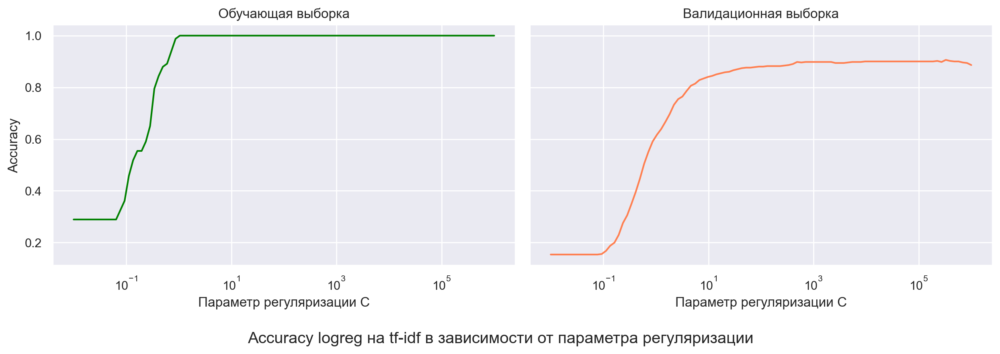

In [132]:
f, ax0 = plt.subplots(1, 2, figsize=(14,5), sharex=True, sharey=True)

ax0[0].plot(c, acc_train, color='green')
ax0[0].set_ylabel('Accuracy')
ax0[0].set_xlabel('Параметр регуляризации C')
ax0[0].set_title('Обучающая выборка')
ax0[0].set_xscale('log')

ax0[1].plot(c, acc_val, color='coral')
ax0[1].set_ylabel('')
ax0[1].set_xlabel('Параметр регуляризации C')
ax0[1].set_title('Валидационная выборка')
ax0[1].set_xscale('log')

f.suptitle("Accuracy logreg на tf-idf в зависимости от параметра регуляризации", y=0.035)
f.tight_layout(rect=[0.05, 0.05, 0.95, 0.95])

In [133]:
best_c_val_idx = np.argmax(acc_val)
best_c = c[best_c_val_idx]
print(best_c, acc_val[best_c_val_idx])

327454.9162877732 0.906187624750499


*Оцениваем итоговое качество:*

In [134]:
lr = LogisticRegression(C=best_c, random_state=13, max_iter=1000, n_jobs=-1)
lr.fit(X_train_marked_tf_idf, y_train_marked)

lr_pred_train = lr.predict(X_train_marked_tf_idf)
lr_pred_test = lr.predict(X_test_tf_idf)

acc_lr_train = accuracy_score(y_train_marked, lr_pred_train)
acc_lr_test = accuracy_score(y_test, lr_pred_test)

print(f'Accuracy train: {round(acc_lr_train, 4)} \
      \nAccuracy test:  {round(acc_lr_test, 4)}')

Accuracy train: 1.0       
Accuracy test:  0.9013


In [21]:
# dataframe для сравнения 
# методов классификации по метрикам
df_metrics_small = pd.DataFrame(columns=['accuracy train', 
                                   'accuracy test',
                                   'C (коэф. рег.)',
                                   'Число кластеров'])

# добавление очередной строки с характеристиками метода
df_metrics_small.loc['tf-idf + logreg (CV)'] = [
    1.0,
    0.9013,
    327455.0,
    None
]

df_metrics_small

,accuracy train,accuracy test,C (коэф. рег.),Число кластеров
tf-idf + logreg (CV),1.0,0.9013,327455.0,NaN


### K-Means на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров

Сделаю подбор числа кластеров и параметра регуляризации по валидационной выборке:

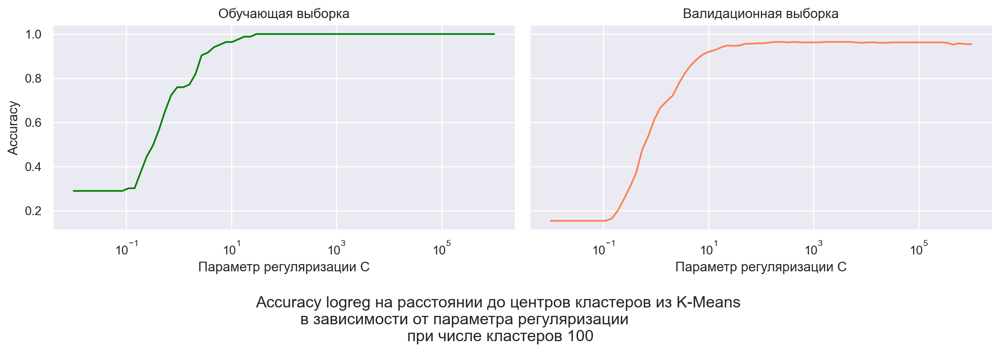

In [142]:
from IPython.display import clear_output

k_means_clusters = np.arange(5, 105, 5)
c = np.logspace(-2, 6, 70)
k_means_clust_acc = []
k_means_clust_best_c = []

for k_means_cluster in k_means_clusters:
    k_means = KMeans(n_clusters=k_means_cluster, random_state=13)
    k_means = k_means.fit(X_train_marked_and_not_marked_tf_idf)
    clusters = k_means.predict(X_train_marked_and_not_marked_tf_idf)
    centers = k_means.cluster_centers_ 

    cluster_data = data.copy()
    X_tf_idf = vectorizer.transform(data.text)  # vectorizer уже обучен на новом train

    for i in range(centers.shape[0]):
        # для каждого центра кластера
        # превращаем каждый центр в строку
        one_center_as_row = centers[i].reshape(-1, 1).T
        # создаю матрицу из единиц одного размера с X_tf_idf
        ones = np.ones(X_tf_idf.shape)  # (2225, 4608)
        # дублирую центры кластеров до размера X_tf_idf
        one_center_as_matrix = one_center_as_row * ones
        # считаю расстояние до центра i-го кластера для каждого объекта (новости)
        norm = np.linalg.norm(one_center_as_matrix - X_tf_idf, axis=1)

        # записываем расстояние до каждого кластера для каждого объекта (новости)
        cluster_data['dist_to_clust_' + str(i)] = norm

    # забираем новые признаки
    dist_cluster_data = cluster_data[cluster_data.columns[7:]]
    # делим на train и test
    X_train, X_test, y_train, y_test = train_test_split(dist_cluster_data, y, test_size=0.25, random_state=13)
    # делим на размеченный train и неразмеченный train и validate
    X_train_dist_marked, X_train_dist_not_marked, X_dist_validate = X_train[:chortcut_1], X_train[chortcut_1:chortcut_2], X_train[chortcut_2:]
    y_train_marked, y_train_not_marked, y_validate = y_train[:chortcut_1], y_train[chortcut_1:chortcut_2], y_train[chortcut_2:]
    # проверка, что все сошлось
    assert X_train_dist_marked.shape[0] + X_train_dist_not_marked.shape[0] + X_dist_validate.shape[0] == X_train.shape[0]

    # контейнеры для метрик
    acc_train = []
    acc_val = []

    for c_i in c:
        lr = LogisticRegression(C=c_i, random_state=13, max_iter=1000, n_jobs=-1)
        lr.fit(X_train_dist_marked, y_train_marked)

        lr_pred_train = lr.predict(X_train_dist_marked)
        lr_pred_val = lr.predict(X_dist_validate)

        acc_lr_train = accuracy_score(y_train_marked, lr_pred_train)
        acc_lr_val = accuracy_score(y_validate, lr_pred_val)

        acc_train.append(acc_lr_train)
        acc_val.append(acc_lr_val)

    acc_train = np.array(acc_train)
    acc_val = np.array(acc_val)

    # визуализируем метрики в зависимости от коэф. рег. для текущего числа кластеров
    clear_output(wait=True)
    f, ax0 = plt.subplots(1, 2, figsize=(14,5), sharex=True, sharey=True)

    ax0[0].plot(c, acc_train, color='green')
    ax0[0].set_ylabel('Accuracy')
    ax0[0].set_xlabel('Параметр регуляризации C')
    ax0[0].set_title('Обучающая выборка')
    ax0[0].set_xscale('log')

    ax0[1].plot(c, acc_val, color='coral')
    ax0[1].set_ylabel('')
    ax0[1].set_xlabel('Параметр регуляризации C')
    ax0[1].set_title('Валидационная выборка')
    ax0[1].set_xscale('log')

    f.suptitle(f"Accuracy logreg на расстоянии до центров кластеров из K-Means \nв зависимости от параметра регуляризации \
               \nпри числе кластеров {k_means_cluster}", y=0.035)
    f.tight_layout(rect=[0.05, 0.05, 0.95, 0.95])

    plt.show()

    # записываем метрики
    best_c_val_idx = np.argmax(acc_val)
    best_c = c[best_c_val_idx]

    k_means_clust_acc.append(np.max(acc_val))
    k_means_clust_best_c.append(best_c)

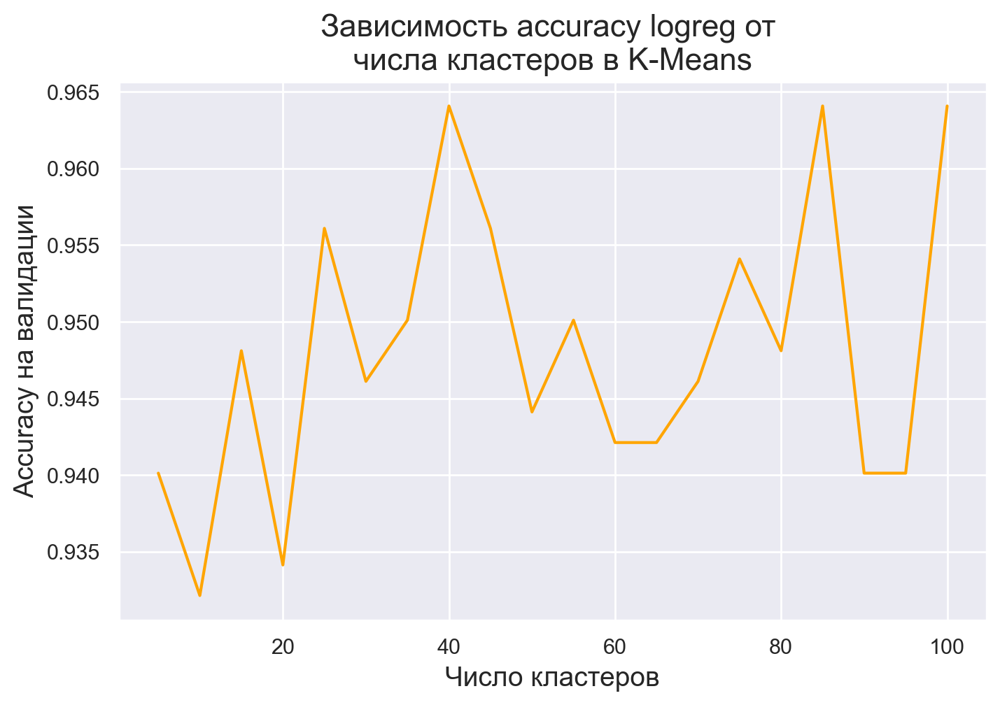

In [143]:
plt.figure(figsize=(8, 5))

plt.plot(k_means_clusters, k_means_clust_acc, color='orange')
plt.title('Зависимость accuracy logreg от \nчисла кластеров в K-Means', fontsize=16)
plt.xlabel("Число кластеров", fontsize=14)
plt.ylabel("Accuracy на валидации", fontsize=14);

In [147]:
n_clust_best_idx = np.argmax(k_means_clust_acc)
n_clust_best = k_means_clusters[n_clust_best_idx]
k_means_best_c = k_means_clust_best_c[n_clust_best_idx]
k_means_best_acc = k_means_clust_acc[n_clust_best_idx]

print(f'Лучшее число кластеров: {n_clust_best} \
      \nЛучшее C: {k_means_best_c} \
      \nЛучшее accuracy: {k_means_best_acc}')

Лучшее число кластеров: 40       
Лучшее C: 90473.57242349294       
Лучшее accuracy: 0.9640718562874252


*Оценим итоговое качество:*

In [145]:
# обучаем kmeans
k_means = KMeans(n_clusters=n_clust_best, random_state=13)
k_means = k_means.fit(X_train_marked_and_not_marked_tf_idf)
clusters = k_means.predict(X_train_marked_and_not_marked_tf_idf)
centers = k_means.cluster_centers_

In [146]:
# готовим данные
cluster_data = data.copy()
X_tf_idf = vectorizer.transform(data.text)  # vectorizer уже обучен на новом train

for i in range(centers.shape[0]):
    # для каждого центра кластера
    # превращаем каждый центр в строку
    one_center_as_row = centers[i].reshape(-1, 1).T
    # создаю матрицу из единиц одного размера с X_tf_idf
    ones = np.ones(X_tf_idf.shape)  # (2225, 4608)
    # дублирую центры кластеров до размера X_tf_idf
    one_center_as_matrix = one_center_as_row * ones
    # считаю расстояние до центра i-го кластера для каждого объекта (новости)
    norm = np.linalg.norm(one_center_as_matrix - X_tf_idf, axis=1)

    # записываем расстояние до каждого кластера для каждого объекта (новости)
    cluster_data['dist_to_clust_' + str(i)] = norm

# забираем новые признаки
dist_cluster_data = cluster_data[cluster_data.columns[7:]]
# делим на train и test
X_train, X_test, y_train, y_test = train_test_split(dist_cluster_data, y, test_size=0.25, random_state=13)
# делим на размеченный train и неразмеченный train и validate
X_train_dist_marked, X_train_dist_not_marked, X_dist_validate = X_train[:chortcut_1], X_train[chortcut_1:chortcut_2], X_train[chortcut_2:]
y_train_marked, y_train_not_marked, y_validate = y_train[:chortcut_1], y_train[chortcut_1:chortcut_2], y_train[chortcut_2:]
# объединяю train для обучения unsupervised
# X_train_dist_marked_and_not_marked = pd.concat([X_train_dist_marked, X_train_dist_not_marked])
# проверка, что все сошлось
assert X_train_dist_marked.shape[0] + X_train_dist_not_marked.shape[0] + X_dist_validate.shape[0] == X_train.shape[0]

In [148]:
lr = LogisticRegression(C=k_means_best_c, random_state=13, max_iter=1000, n_jobs=-1)
lr.fit(X_train_dist_marked, y_train_marked)

LogisticRegression(C=90473.57242349294, max_iter=1000, n_jobs=-1,
                   random_state=13)

In [150]:
lr_pred_train = lr.predict(X_train_dist_marked)
lr_pred_test = lr.predict(X_test)

acc_lr_train = accuracy_score(y_train_marked, lr_pred_train)
acc_lr_test = accuracy_score(y_test, lr_pred_test)

print(f'Accuracy train: {round(acc_lr_train, 4)} \
      \nAccuracy test:  {round(acc_lr_test, 4)}')

Accuracy train: 1.0       
Accuracy test:  0.9461


In [22]:
# добавление очередной строки с характеристиками метода
df_metrics_small.loc['KMeans (tf-idf) + logreg (center dist.) (CV)'] = [
    1.0,
    0.9461,
    90473.6,
    40
]

df_metrics_small

,accuracy train,accuracy test,C (коэф. рег.),Число кластеров
tf-idf + logreg (CV),1.0,0.9013,327455.0,NaN
KMeans (tf-idf) + logreg (center dist.) (CV),1.0,0.9461,90473.6,40.0


### Латентное размещение Дирихле + логистическая регрессия на вероятностях тем

Здесь нужен другой `vectorizer`, поэтому я разделю выборку снова.

In [75]:
X_train, X_test, y_train, y_test = train_test_split(data.drop('y', axis=1), y, test_size=0.25, random_state=13)

X_train_marked, X_train_not_marked, X_validate = X_train[:chortcut_1], X_train[chortcut_1:chortcut_2], X_train[chortcut_2:]
y_train_marked, y_train_not_marked, y_validate = y_train[:chortcut_1], y_train[chortcut_1:chortcut_2], y_train[chortcut_2:]

assert X_train_marked.shape[0] + X_train_not_marked.shape[0] + X_validate.shape[0] == X_train.shape[0]

X_train_marked_and_not_marked = pd.concat([X_train_marked, X_train_not_marked])

In [76]:
# обучаем и применяем bag of words
bag_of_words_vect = CountVectorizer(max_df=1.0, min_df=0.005)
X_train_marked_and_not_marked_bow = bag_of_words_vect.fit_transform(X_train_marked_and_not_marked.text)
feature_names = bag_of_words_vect.get_feature_names_out()

X_train_marked_bow = bag_of_words_vect.transform(X_train_marked.text)
X_train_not_marked_bow = bag_of_words_vect.transform(X_train_not_marked.text)
X_validate_bow = bag_of_words_vect.transform(X_validate.text)
X_test_bow = bag_of_words_vect.transform(X_test.text)

assert X_train_marked_and_not_marked_bow.shape[1] == X_train_marked_bow.shape[1] == \
    X_train_not_marked_bow.shape[1] == X_validate_bow.shape[1] == X_test_bow.shape[1]

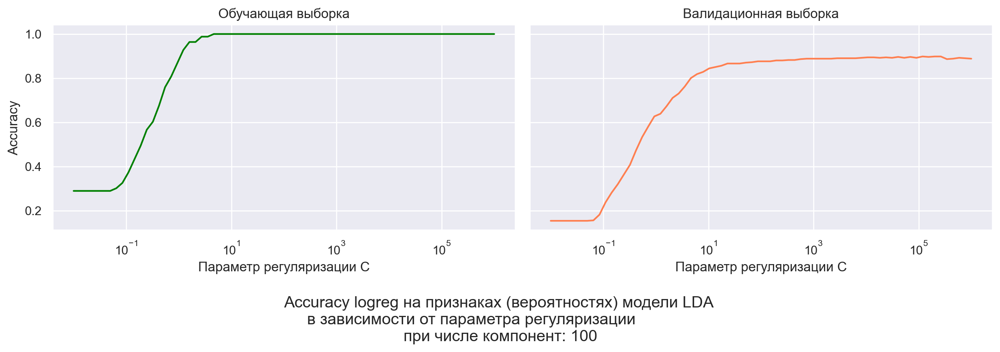

In [78]:
from IPython.display import clear_output

lda_n_components = np.arange(5, 105, 5)
c = np.logspace(-2, 6, 70)
lda_acc_val = []
lda_best_c_val = []

for lda_n_component in lda_n_components:
    # перебираю число компонент для LDA
    lda = LatentDirichletAllocation(n_components=lda_n_component, max_iter=50, evaluate_every=0, n_jobs=-1, random_state=13, verbose=0)
    lda.fit(X_train_marked_and_not_marked_bow)

    labels_prob_train = lda.transform(X_train_marked_bow)
    labels_prob_val = lda.transform(X_validate_bow)

    acc_train = []
    acc_val = []

    for c_i in c:
        lr = LogisticRegression(C=c_i, random_state=13, max_iter=1000, n_jobs=-1)
        lr.fit(labels_prob_train, y_train_marked)

        lr_pred_train = lr.predict(labels_prob_train)
        lr_pred_val = lr.predict(labels_prob_val)
        acc_lr_train = accuracy_score(y_train_marked, lr_pred_train)
        acc_lr_val = accuracy_score(y_validate, lr_pred_val)

        acc_train.append(acc_lr_train)
        acc_val.append(acc_lr_val)

    acc_train = np.array(acc_train)
    acc_val = np.array(acc_val)

    # визуализируем метрики в зависимости от коэф. рег. для текущего числа кластеров
    clear_output(wait=True)
    f, ax0 = plt.subplots(1, 2, figsize=(14,5), sharex=True, sharey=True)

    ax0[0].plot(c, acc_train, color='green')
    ax0[0].set_ylabel('Accuracy')
    ax0[0].set_xlabel('Параметр регуляризации C')
    ax0[0].set_title('Обучающая выборка')
    ax0[0].set_xscale('log')

    ax0[1].plot(c, acc_val, color='coral')
    ax0[1].set_ylabel('')
    ax0[1].set_xlabel('Параметр регуляризации C')
    ax0[1].set_title('Валидационная выборка')
    ax0[1].set_xscale('log')

    f.suptitle(f"Accuracy logreg на признаках (вероятностях) модели LDA \nв зависимости от параметра регуляризации \
            \nпри числе компонент: {lda_n_component}", y=0.035)
    f.tight_layout(rect=[0.05, 0.05, 0.95, 0.95])

    plt.show()

    best_c_val_idx = np.argmax(acc_val)
    best_c = c[best_c_val_idx]

    lda_acc_val.append(np.max(acc_val))
    lda_best_c_val.append(best_c)


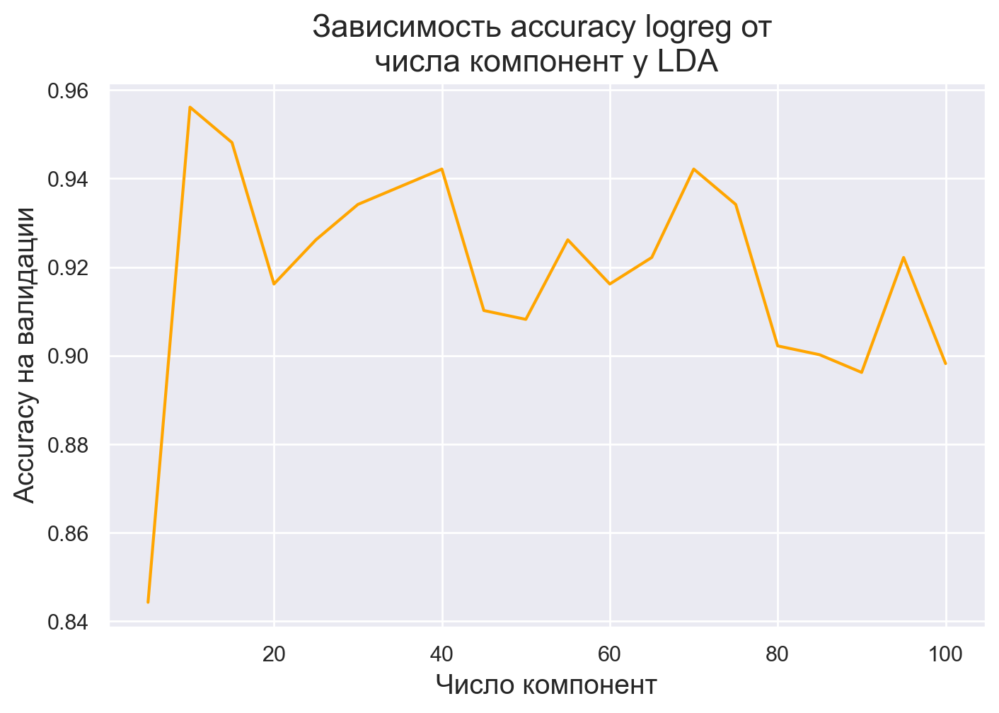

In [79]:
plt.figure(figsize=(8, 5))

plt.plot(lda_n_components, lda_acc_val, color='orange')
plt.title('Зависимость accuracy logreg от \nчисла компонент у LDA', fontsize=16)
plt.xlabel("Число компонент", fontsize=14)
plt.ylabel("Accuracy на валидации", fontsize=14);

In [80]:
n_components_best_idx = np.argmax(lda_acc_val)
n_components_best = lda_n_components[n_components_best_idx]
lda_best_acc = lda_acc_val[n_components_best_idx]
lda_best_c = lda_best_c_val[n_components_best_idx]


print(f'Лучшее число компонент: {n_components_best} \
      \nЛучшее accuracy: {lda_best_acc} \
      \nЛучшее C: {lda_best_c}')

Лучшее число компонент: 10       
Лучшее accuracy: 0.9560878243512974       
Лучшее C: 3.5540590371810645


Вычислим итоговое качество:

In [81]:
lda = LatentDirichletAllocation(n_components=n_components_best, max_iter=50, evaluate_every=0, n_jobs=-1, random_state=13, verbose=0)
lda.fit(X_train_marked_and_not_marked_bow)

labels_prob_train = lda.transform(X_train_marked_bow)
labels_prob_val = lda.transform(X_validate_bow)
labels_prob_test = lda.transform(X_test_bow)

lr = LogisticRegression(C=lda_best_c, random_state=13, max_iter=1000, n_jobs=-1)
lr.fit(labels_prob_train, y_train_marked)

lr_pred_train = lr.predict(labels_prob_train)
lr_pred_test = lr.predict(labels_prob_test)

acc_lr_train = accuracy_score(y_train_marked, lr_pred_train)
acc_lr_test = accuracy_score(y_test, lr_pred_test)

print(f'Accuracy train: {round(acc_lr_train, 4)} \
      \nAccuracy test:  {round(acc_lr_test, 4)}')

Accuracy train: 0.9759       
Accuracy test:  0.9372


In [82]:
df_metrics_small.loc['LDA + logreg (topic probs) (CV)'] = [
    0.9759,
    0.9372,
    3.6,
    10
]

df_metrics_small

,accuracy train,accuracy test,C (коэф. рег.),Число кластеров
tf-idf + logreg (CV),1.0000,0.9013,327455.0,NaN
KMeans (tf-idf) + logreg (center dist.) (CV),1.0000,0.9461,90473.6,40.0
LDA + logreg (topic probs) (CV),0.9759,0.9372,3.6,10.0


Сравним с предыдущими результатами:

In [170]:
df_metrics.sort_values(by='accuracy test', ascending=False)

,accuracy train,accuracy test,C (коэф. рег.)
tf-idf + logreg (CV),1.0000,0.9749,268.3
tf-idf + logreg (base),0.9958,0.9695,1.0
KMeans (tf-idf) + logreg (center dist.) (CV),0.9682,0.9443,71968.6
LDA + logreg (topic probs) (base),0.9538,0.9425,1.0
LDA + logreg (topic probs) (CV),0.9592,0.9390,10.0
KMeans (tf-idf) + logreg (center dist.) (base),0.8711,0.8366,1.0


In [83]:
df_metrics_small.sort_values(by='accuracy test', ascending=False)

,accuracy train,accuracy test,C (коэф. рег.),Число кластеров
KMeans (tf-idf) + logreg (center dist.) (CV),1.0000,0.9461,90473.6,40.0
LDA + logreg (topic probs) (CV),0.9759,0.9372,3.6,10.0
tf-idf + logreg (CV),1.0000,0.9013,327455.0,NaN


Как изменились результаты по сравнению с обучением на полной разметке? Сделайте выводы.

**Ответ:** результаты перевернулись: теперь лучший результат показывает модель K-Means + logreg (практически такой же, как при обучении на всем трейне с подбором регуляризации дл logreg). Качество LDA + logreg практически не изменилось, а качество tf-idf + logreg упало на 0.07, и она стала переобучаться.

Из этого можно сделать следующие выводы:
* Модель K-Means + logreg достаточно простая, для ее обучения можно использовать намного меньше данных и не терять в качестве. Но для нее нужно следить за переобучением и подбирать число кластеров
    * возможно, это связано с тем, что данные простые, и центры кластеров даже по 100 объектам являются хорошими признаками 
* Модель LDA + logreg не склонна к переобучению и не требует большого числа данных
* Модель tf-idf + logreg склонна переобучаться, а также требует большого числа данных

Посмотрим на semi-supervised методами, которые реализованы в `sklearn`. Сравним с результатами выше.

In [44]:
import warnings
warnings.filterwarnings("ignore") 
# чтобы не показывать ConvergenceWarning

**Небольшое введение**: в sklearn реализован **Label Propagation algorithm**. Вот его описание: «Label propagation is a graph-based transductive method to infer pseudo-labels for unlabeled data. Unlabeled data points iteratively adopt the label of the majority of their neighbors based on the labelled data points».

Еще есть **Label Spreading algorithm**, но они с Label Propagation algorithm отличаются только модификациями матрицы сходства и наличием параметра, который позволяет алгоритму в некоторой степени изменить вес истинных данных, помеченных метками (скольким % не доверяем). У Label Propagation он равен 0, у Label Spreading его можно настраивать.

*Источник*: https://medium.com/geekculture/semi-supervised-learning-using-label-propagation-2f2d69b8f3ae

In [20]:
from sklearn.semi_supervised import LabelPropagation, LabelSpreading

Представим ответы для неразмеченных данных так, как их ожидает sklearn: реразмеченные ответы должны иметь метки `-1`:

In [179]:
X_train, X_test, y_train, y_test = train_test_split(data.drop('y', axis=1), y, test_size=0.25, random_state=13)

X_train_marked, X_train_not_marked, X_validate = X_train[:chortcut_1], X_train[chortcut_1:chortcut_2], X_train[chortcut_2:]
y_train_marked, y_train_not_marked, y_validate = y_train[:chortcut_1], y_train[chortcut_1:chortcut_2], y_train[chortcut_2:]

X_train_marked_and_not_marked = pd.concat([X_train_marked, X_train_not_marked])
y_train_marked_and_not_marked = pd.concat([y_train_marked, y_train_not_marked])
y_train_marked_and_not_marked[y_train_not_marked.index] = -1

y_train_marked_and_not_marked[y_train_not_marked.index].unique()

array([-1])

### Модель на tf-idf признаках

Попробую подобрать лучшие параметры для Label Spreading и Label Propagation, а затем сравнить их.

In [180]:
vectorizer = TfidfVectorizer(max_df=1.0, min_df=0.005)
X_tf_idf = vectorizer.fit_transform(X_train_marked_and_not_marked.text)
X_validate_tf_idf = vectorizer.transform(X_validate.text)
X_test_tf_idf = vectorizer.transform(X_test.text)

In [182]:
# эти алгоритмы не работают со спарс матрицей
X_tf_idf = X_tf_idf.toarray()
X_validate_tf_idf = X_validate_tf_idf.toarray()
X_test_tf_idf = X_test_tf_idf.toarray()

In [183]:
# обучаю две модели
label_sprd_model = LabelSpreading(n_jobs=-1)
label_sprd_model.fit(X_tf_idf, y_train_marked_and_not_marked)

label_prop_model = LabelPropagation(n_jobs=-1)
label_prop_model.fit(X_tf_idf, y_train_marked_and_not_marked)

LabelPropagation(n_jobs=-1)

In [184]:
# LabelSpreading
lr_pred_train = label_sprd_model.predict(X_tf_idf)
lr_pred_test = label_sprd_model.predict(X_test_tf_idf)

acc_lr_train = accuracy_score(pd.concat([y_train_marked, y_train_not_marked]), lr_pred_train)
acc_lr_test = accuracy_score(y_test, lr_pred_test)

print(f'LabelSpreading model \
      \nAccuracy train: {round(acc_lr_train, 4)} \
      \nAccuracy test:  {round(acc_lr_test, 4)}')

LabelSpreading model       
Accuracy train: 0.8278       
Accuracy test:  0.8169


In [185]:
# LabelPropagation
lr_pred_train = label_prop_model.predict(X_tf_idf)
lr_pred_test = label_prop_model.predict(X_test_tf_idf)

acc_lr_train = accuracy_score(pd.concat([y_train_marked, y_train_not_marked]), lr_pred_train)
acc_lr_test = accuracy_score(y_test, lr_pred_test)

print(f'LabelPropagation model \
      \nAccuracy train: {round(acc_lr_train, 4)} \
      \nAccuracy test:  {round(acc_lr_test, 4)}')

LabelPropagation model       
Accuracy train: 0.8895       
Accuracy test:  0.8636


`LabelPropagation` дает лучший результат, вероятно, потому что данные достаточно простые, и им можно доверять.

In [62]:
# dataframe для сравнения 
# методов классификации по метрикам
df_semi_supervised = pd.DataFrame(columns=['accuracy train', 
                                   'accuracy test',
                                   'alpha',
                                   'gamma / n_neighbors'])

# добавление очередной строки с характеристиками метода
df_semi_supervised.loc['tf-idf + LabelSpreading (rbf)-base'] = [
    0.8278,
    0.8169,
    0.2,
    20
]

df_semi_supervised.loc['tf-idf + LabelPropagation (rbf)-base'] = [
    0.8895,
    0.8636,
    0,
    20
]

df_semi_supervised

,accuracy train,accuracy test,alpha,gamma / n_neighbors
tf-idf + LabelSpreading (rbf)-base,0.8278,0.8169,0.2,20.0
tf-idf + LabelPropagation (rbf)-base,0.8895,0.8636,0.0,20.0


Можно попробовать взять другое ядро: `knn` вместо `rbf`:

In [187]:
label_sprd_model = LabelSpreading(kernel='knn', n_jobs=-1)
label_sprd_model.fit(X_tf_idf, y_train_marked_and_not_marked)

label_prop_model = LabelPropagation(kernel='knn', n_jobs=-1)
label_prop_model.fit(X_tf_idf, y_train_marked_and_not_marked)

LabelPropagation(kernel='knn', n_jobs=-1)

In [188]:
# LabelSpreading
lr_pred_train = label_sprd_model.predict(X_tf_idf)
lr_pred_test = label_sprd_model.predict(X_test_tf_idf)

acc_lr_train = accuracy_score(pd.concat([y_train_marked, y_train_not_marked]), lr_pred_train)
acc_lr_test = accuracy_score(y_test, lr_pred_test)

print(f'LabelSpreading model \
      \nAccuracy train: {round(acc_lr_train, 4)} \
      \nAccuracy test:  {round(acc_lr_test, 4)}')

LabelSpreading model       
Accuracy train: 0.892       
Accuracy test:  0.8671


In [189]:
# LabelPropagation
lr_pred_train = label_prop_model.predict(X_tf_idf)
lr_pred_test = label_prop_model.predict(X_test_tf_idf)

acc_lr_train = accuracy_score(pd.concat([y_train_marked, y_train_not_marked]), lr_pred_train)
acc_lr_test = accuracy_score(y_test, lr_pred_test)

print(f'LabelPropagation model \
      \nAccuracy train: {round(acc_lr_train, 4)} \
      \nAccuracy test:  {round(acc_lr_test, 4)}')

LabelPropagation model       
Accuracy train: 0.8972       
Accuracy test:  0.8689


Результат стал лучше, прежде всего у LabelSpreading

In [63]:
# добавление очередной строки с характеристиками метода
df_semi_supervised.loc['tf-idf + LabelSpreading (knn)-base'] = [
    0.892,
    0.8671,
    0.2,
    7
]

df_semi_supervised.loc['tf-idf + LabelPropagation (knn)-base'] = [
    0.8972,
    0.8689,
    0,
    7
]

df_semi_supervised

,accuracy train,accuracy test,alpha,gamma / n_neighbors
tf-idf + LabelSpreading (rbf)-base,0.8278,0.8169,0.2,20.0
tf-idf + LabelPropagation (rbf)-base,0.8895,0.8636,0.0,20.0
tf-idf + LabelSpreading (knn)-base,0.8920,0.8671,0.2,7.0
tf-idf + LabelPropagation (knn)-base,0.8972,0.8689,0.0,7.0


Подбор `n_neighbors` для `LabelPropagation`:

In [196]:
# LabelPropagation - knn
n_neighborss = np.arange(1, 100)
acc_train = []
acc_val = []

for n_neighbors in n_neighborss:
    label_prop_model = LabelPropagation(kernel='knn', n_neighbors=n_neighbors, max_iter=10_000, n_jobs=-1)
    label_prop_model.fit(X_tf_idf, y_train_marked_and_not_marked)

    lr_pred_train = label_prop_model.predict(X_tf_idf)
    lr_pred_val = label_prop_model.predict(X_validate_tf_idf)

    acc_lr_train = accuracy_score(pd.concat([y_train_marked, y_train_not_marked]), lr_pred_train)
    acc_lr_val = accuracy_score(y_validate, lr_pred_val)

    acc_train.append(acc_lr_train)
    acc_val.append(acc_lr_val)

acc_train = np.array(acc_train)
acc_val = np.array(acc_val)

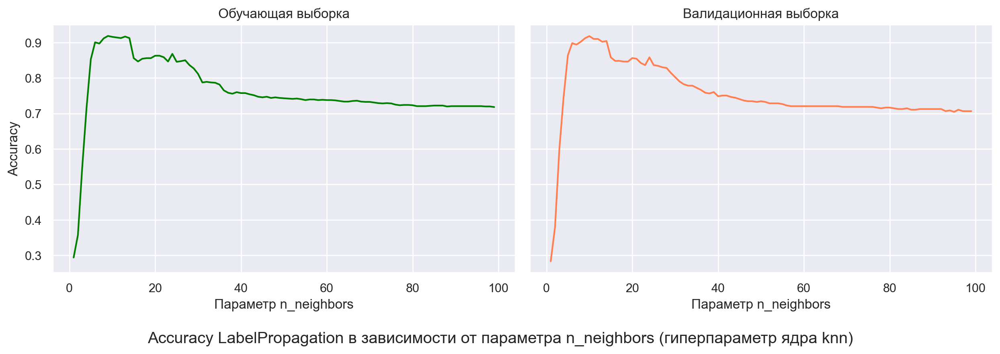

In [197]:
f, ax0 = plt.subplots(1, 2, figsize=(14,5), sharex=True, sharey=True)

ax0[0].plot(n_neighborss, acc_train, color='green')
ax0[0].set_ylabel('Accuracy')
ax0[0].set_xlabel('Параметр n_neighbors')
ax0[0].set_title('Обучающая выборка')

ax0[1].plot(n_neighborss, acc_val, color='coral')
ax0[1].set_ylabel('')
ax0[1].set_xlabel('Параметр n_neighbors')
ax0[1].set_title('Валидационная выборка')

f.suptitle("Accuracy LabelPropagation в зависимости от параметра n_neighbors (гиперпараметр ядра knn)", y=0.035)
f.tight_layout(rect=[0.05, 0.05, 0.95, 0.95])

In [198]:
prop_best_n_neighbors_val_idx = np.argmax(acc_val)
prop_best_n_neighbors = n_neighborss[prop_best_n_neighbors_val_idx]
prop_best_acc = acc_val[prop_best_n_neighbors_val_idx]

print(f'Модель: LabelPropagation \
      \nЛучшее n_neighbors: {prop_best_n_neighbors} \
      \nЛучшее accuracy: {prop_best_acc}')

Модель: LabelPropagation       
Лучшее n_neighbors: 10       
Лучшее accuracy: 0.9181636726546906


In [199]:
label_prop_model = LabelPropagation(kernel='knn', n_neighbors=prop_best_n_neighbors, max_iter=10_000, n_jobs=-1)
label_prop_model.fit(X_tf_idf, y_train_marked_and_not_marked)

lr_pred_train = label_prop_model.predict(X_tf_idf)
lr_pred_test = label_prop_model.predict(X_test_tf_idf)

acc_lr_train = accuracy_score(pd.concat([y_train_marked, y_train_not_marked]), lr_pred_train)
acc_lr_test = accuracy_score(y_test, lr_pred_test)

print(f'Модель: LabelPropagation \
      \nAccuracy train: {round(acc_lr_train, 4)} \
      \nAccuracy test:  {round(acc_lr_test, 4)}')

Модель: LabelPropagation       
Accuracy train: 0.916       
Accuracy test:  0.8851


In [64]:
df_semi_supervised.loc['tf-idf + LabelPropagation (knn)-CV'] = [
    0.916,
    0.8851,
    0,
    10
]

df_semi_supervised

,accuracy train,accuracy test,alpha,gamma / n_neighbors
tf-idf + LabelSpreading (rbf)-base,0.8278,0.8169,0.2,20.0
tf-idf + LabelPropagation (rbf)-base,0.8895,0.8636,0.0,20.0
tf-idf + LabelSpreading (knn)-base,0.8920,0.8671,0.2,7.0
tf-idf + LabelPropagation (knn)-base,0.8972,0.8689,0.0,7.0
tf-idf + LabelPropagation (knn)-CV,0.9160,0.8851,0.0,10.0


Подбор `gamma` для `LabelPropagation`:

In [205]:
# LabelPropagation - rbf
gammas = np.logspace(-2, 6, 70)
acc_train = []
acc_val = []

for gamma in gammas:
    label_prop_model = LabelPropagation(kernel='rbf', gamma=gamma, max_iter=10_000, n_jobs=-1)
    label_prop_model.fit(X_tf_idf, y_train_marked_and_not_marked)

    lr_pred_train = label_prop_model.predict(X_tf_idf)
    lr_pred_val = label_prop_model.predict(X_validate_tf_idf)

    acc_lr_train = accuracy_score(pd.concat([y_train_marked, y_train_not_marked]), lr_pred_train)
    acc_lr_val = accuracy_score(y_validate, lr_pred_val)

    acc_train.append(acc_lr_train)
    acc_val.append(acc_lr_val)

acc_train = np.array(acc_train)
acc_val = np.array(acc_val)

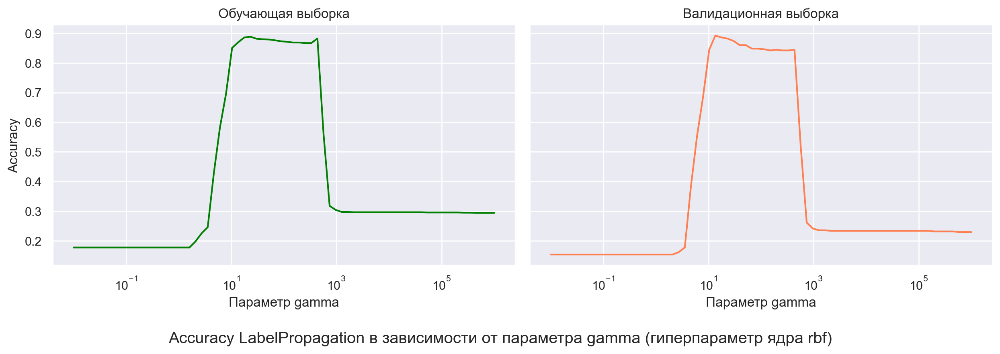

In [206]:
f, ax0 = plt.subplots(1, 2, figsize=(14,5), sharex=True, sharey=True)

ax0[0].plot(gammas, acc_train, color='green')
ax0[0].set_ylabel('Accuracy')
ax0[0].set_xlabel('Параметр gamma')
ax0[0].set_title('Обучающая выборка')
ax0[0].set_xscale('log')
# ax0[0].yscale('log')

ax0[1].plot(gammas, acc_val, color='coral')
ax0[1].set_ylabel('')
ax0[1].set_xlabel('Параметр gamma')
ax0[1].set_title('Валидационная выборка')
ax0[1].set_xscale('log')
# ax0[1].yscale('log')

f.suptitle("Accuracy LabelPropagation в зависимости от параметра gamma (гиперпараметр ядра rbf)", y=0.035)
f.tight_layout(rect=[0.05, 0.05, 0.95, 0.95])

In [207]:
prop_best_gamma_val_idx = np.argmax(acc_val)
prop_best_gamma = gammas[prop_best_gamma_val_idx]
prop_best_acc = acc_val[prop_best_gamma_val_idx]

print(f'Модель: LabelPropagation \
      \nЛучшее gamma: {prop_best_gamma} \
      \nЛучшее accuracy: {prop_best_acc}')

Модель: LabelPropagation       
Лучшее gamma: 13.503140378698735       
Лучшее accuracy: 0.8922155688622755


In [208]:
label_prop_model = LabelPropagation(kernel='rbf', gamma=prop_best_gamma, max_iter=10_000, n_jobs=-1)
label_prop_model.fit(X_tf_idf, y_train_marked_and_not_marked)

lr_pred_train = label_prop_model.predict(X_tf_idf)
lr_pred_test = label_prop_model.predict(X_test_tf_idf)

acc_lr_train = accuracy_score(pd.concat([y_train_marked, y_train_not_marked]), lr_pred_train)
acc_lr_test = accuracy_score(y_test, lr_pred_test)

print(f'Модель: LabelPropagation \
      \nAccuracy train: {round(acc_lr_train, 4)} \
      \nAccuracy test:  {round(acc_lr_test, 4)}')

Модель: LabelPropagation       
Accuracy train: 0.8698       
Accuracy test:  0.86


In [65]:
df_semi_supervised.loc['tf-idf + LabelPropagation (rbf)-CV'] = [
    0.8698,
    0.86,
    0,
    13.5
]

df_semi_supervised

,accuracy train,accuracy test,alpha,gamma / n_neighbors
tf-idf + LabelSpreading (rbf)-base,0.8278,0.8169,0.2,20.0
tf-idf + LabelPropagation (rbf)-base,0.8895,0.8636,0.0,20.0
tf-idf + LabelSpreading (knn)-base,0.8920,0.8671,0.2,7.0
tf-idf + LabelPropagation (knn)-base,0.8972,0.8689,0.0,7.0
tf-idf + LabelPropagation (knn)-CV,0.9160,0.8851,0.0,10.0
tf-idf + LabelPropagation (rbf)-CV,0.8698,0.8600,0.0,13.5


Подбор `alpha` и `n_neighbors` для `LabelSpreading`:

In [216]:
# LabelSpreading - knn
n_neighborss = np.arange(1, 100)
alphas = np.linspace(0.001, 0.999, 30)
acc_train = []
acc_val = []
best_alphas = []

for n_neighbors in n_neighborss:
    acc_train_alpha = []
    acc_val_alpha = []
    for alpha in alphas:
        label_prop_model = LabelSpreading(kernel='knn', n_neighbors=n_neighbors, alpha=alpha, max_iter=10_000, n_jobs=-1)
        label_prop_model.fit(X_tf_idf, y_train_marked_and_not_marked)

        lr_pred_train = label_prop_model.predict(X_tf_idf)
        lr_pred_val = label_prop_model.predict(X_validate_tf_idf)

        acc_lr_train = accuracy_score(pd.concat([y_train_marked, y_train_not_marked]), lr_pred_train)
        acc_lr_val = accuracy_score(y_validate, lr_pred_val)

        acc_train_alpha.append(acc_lr_train)
        acc_val_alpha.append(acc_lr_val)
    
    acc_train_alpha = np.array(acc_train_alpha)
    acc_val_alpha = np.array(acc_val_alpha)
    best_alpha_idx = np.argmax(acc_val_alpha)

    best_alpha = alphas[best_alpha_idx]
    best_alphas.append(best_alpha)

    best_acc = acc_val_alpha[best_alpha_idx]
    acc_val.append(best_acc)
    acc_train.append(acc_train_alpha[best_alpha_idx])

    clear_output()
    print('n_neighbors:', n_neighbors)

    # break
    

acc_train = np.array(acc_train)
acc_val = np.array(acc_val)

n_neighbors: 99


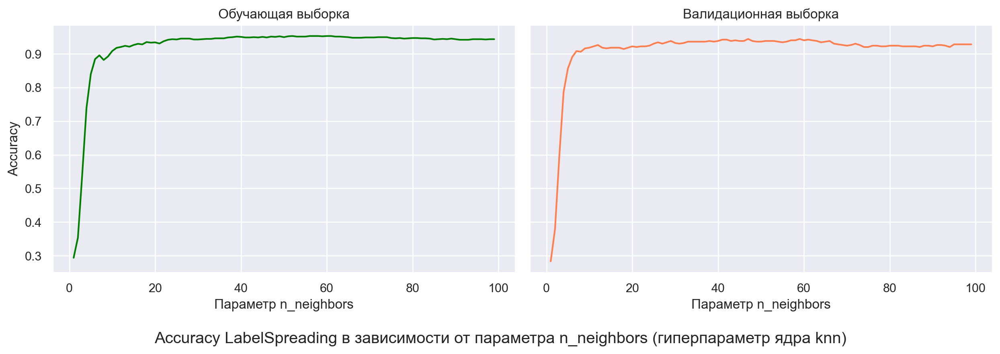

In [222]:
f, ax0 = plt.subplots(1, 2, figsize=(14,5), sharex=True, sharey=True)

ax0[0].plot(n_neighborss, acc_train, color='green')
ax0[0].set_ylabel('Accuracy')
ax0[0].set_xlabel('Параметр n_neighbors')
ax0[0].set_title('Обучающая выборка')

ax0[1].plot(n_neighborss, acc_val, color='coral')
ax0[1].set_ylabel('')
ax0[1].set_xlabel('Параметр n_neighbors')
ax0[1].set_title('Валидационная выборка')

f.suptitle("Accuracy LabelSpreading в зависимости от параметра n_neighbors (гиперпараметр ядра knn)", y=0.035)
f.tight_layout(rect=[0.05, 0.05, 0.95, 0.95])

In [220]:
sprd_best_n_neighbors_val_idx = np.argmax(acc_val)
sprd_best_n_neighbors = n_neighborss[sprd_best_n_neighbors_val_idx]
sprd_best_alpha = best_alphas[sprd_best_n_neighbors_val_idx]
sprd_best_acc = acc_val[sprd_best_n_neighbors_val_idx]

print(f'Модель: LabelSpreading \
      \nЛучшее alpha: {sprd_best_alpha} \
      \nЛучшее n_neighbors: {sprd_best_n_neighbors} \
      \nЛучшее accuracy: {sprd_best_acc}')

Модель: LabelSpreading       
Лучшее alpha: 0.001       
Лучшее n_neighbors: 47       
Лучшее accuracy: 0.9441117764471058


In [224]:
label_sprd_model = LabelSpreading(kernel='knn', n_neighbors=sprd_best_n_neighbors, alpha=sprd_best_alpha, max_iter=10_000, n_jobs=-1)
label_sprd_model.fit(X_tf_idf, y_train_marked_and_not_marked)

lr_pred_train = label_sprd_model.predict(X_tf_idf)
lr_pred_test = label_sprd_model.predict(X_test_tf_idf)

acc_lr_train = accuracy_score(pd.concat([y_train_marked, y_train_not_marked]), lr_pred_train)
acc_lr_test = accuracy_score(y_test, lr_pred_test)

print(f'Модель: LabelSpreading \
      \nAccuracy train: {round(acc_lr_train, 4)} \
      \nAccuracy test:  {round(acc_lr_test, 4)}')

Модель: LabelSpreading       
Accuracy train: 0.9512       
Accuracy test:  0.93


In [66]:
df_semi_supervised.loc['tf-idf + LabelSpreading (knn)-CV'] = [
    0.9512,
    0.93,
    0.001,
    47
]

df_semi_supervised

,accuracy train,accuracy test,alpha,gamma / n_neighbors
tf-idf + LabelSpreading (rbf)-base,0.8278,0.8169,0.200,20.0
tf-idf + LabelPropagation (rbf)-base,0.8895,0.8636,0.000,20.0
tf-idf + LabelSpreading (knn)-base,0.8920,0.8671,0.200,7.0
tf-idf + LabelPropagation (knn)-base,0.8972,0.8689,0.000,7.0
tf-idf + LabelPropagation (knn)-CV,0.9160,0.8851,0.000,10.0
tf-idf + LabelPropagation (rbf)-CV,0.8698,0.8600,0.000,13.5
tf-idf + LabelSpreading (knn)-CV,0.9512,0.9300,0.001,47.0


In [232]:
df_metrics_small

,accuracy train,accuracy test,C (коэф. рег.),Число кластеров
tf-idf + logreg (CV),1.0000,0.9013,327455.0,NaN
KMeans (tf-idf) + logreg (center dist.) (CV),1.0000,0.9461,90473.6,40.0
LDA + logreg (topic probs) (CV),0.8554,0.8564,567.1,100.0


**Мини-вывод**: модель tf-idf + LabelSpreading с `knn` **смогла превзойти** модель tf-idf + logreg (CV) на 0.03 по accuracy.

### K-Means на tf-idf признаках + LabelSpreading на расстояниях до центров кластеров

In [233]:
X_train, X_test, y_train, y_test = train_test_split(data.drop('y', axis=1), y, test_size=0.25, random_state=13)

X_train_marked, X_train_not_marked, X_validate = X_train[:chortcut_1], X_train[chortcut_1:chortcut_2], X_train[chortcut_2:]
y_train_marked, y_train_not_marked, y_validate = y_train[:chortcut_1], y_train[chortcut_1:chortcut_2], y_train[chortcut_2:]

X_train_marked_and_not_marked = pd.concat([X_train_marked, X_train_not_marked])
y_train_marked_and_not_marked = pd.concat([y_train_marked, y_train_not_marked])
y_train_marked_and_not_marked[y_train_not_marked.index] = -1

y_train_marked_and_not_marked[y_train_not_marked.index].unique()

array([-1])

In [234]:
vectorizer = TfidfVectorizer(max_df=1.0, min_df=0.005)
X_train_marked_and_not_marked_tf_idf = vectorizer.fit_transform(X_train_marked_and_not_marked.text)
X_validate_tf_idf = vectorizer.transform(X_validate.text)
X_test_tf_idf = vectorizer.transform(X_test.text)

In [240]:
X_tf_idf = vectorizer.transform(data.text)  # vectorizer уже обучен на новом train

In [256]:
from IPython.display import clear_output

k_means_clusters = np.arange(5, 105, 5)
n_neighborss = np.arange(1, 101)
acc_train = []
acc_val = []
best_n_neighbors = []

for k_means_cluster in k_means_clusters:
    k_means = KMeans(n_clusters=k_means_cluster, random_state=13)
    k_means = k_means.fit(X_train_marked_and_not_marked_tf_idf)
    clusters = k_means.predict(X_train_marked_and_not_marked_tf_idf)
    centers = k_means.cluster_centers_ 

    cluster_data = data.copy()

    for i in range(centers.shape[0]):
        # для каждого центра кластера
        # превращаем каждый центр в строку
        one_center_as_row = centers[i].reshape(-1, 1).T
        # создаю матрицу из единиц одного размера с X_tf_idf
        ones = np.ones(X_tf_idf.shape)  # (2225, 4608)
        # дублирую центры кластеров до размера X_tf_idf
        one_center_as_matrix = one_center_as_row * ones
        # считаю расстояние до центра i-го кластера для каждого объекта (новости)
        norm = np.linalg.norm(one_center_as_matrix - X_tf_idf, axis=1)

        # записываем расстояние до каждого кластера для каждого объекта (новости)
        cluster_data['dist_to_clust_' + str(i)] = norm

    # забираем новые признаки
    dist_cluster_data = cluster_data[cluster_data.columns[7:]]
    # делим на train и test
    X_train, X_test, y_train, y_test = train_test_split(dist_cluster_data, y, test_size=0.25, random_state=13)
    # делим на размеченный train и неразмеченный train и validate
    X_train_dist_marked, X_train_dist_not_marked, X_dist_validate = X_train[:chortcut_1], X_train[chortcut_1:chortcut_2], X_train[chortcut_2:]
    y_train_marked, y_train_not_marked, y_validate = y_train[:chortcut_1], y_train[chortcut_1:chortcut_2], y_train[chortcut_2:]
    # объединяю train для обучения unsupervised
    X_train_dist_marked_and_not_marked = pd.concat([X_train_dist_marked, X_train_dist_not_marked])
    y_train_marked_and_not_marked = pd.concat([y_train_marked, y_train_not_marked])
    y_train_marked_and_not_marked[y_train_not_marked.index] = -1

    # проверка, что все сошлось
    assert y_train_marked_and_not_marked[y_train_not_marked.index].unique()[0] == -1
    assert X_train_dist_marked.shape[0] + X_train_dist_not_marked.shape[0] + X_dist_validate.shape[0] == X_train.shape[0]

    # контейнеры для метрик
    acc_train_n_neighbors = []
    acc_val_n_neighbors = []

    for n_neighbors in n_neighborss:
        label_sprd_model = LabelSpreading(kernel='knn', n_neighbors=n_neighbors, alpha=0.001, max_iter=10_000, n_jobs=-1)
        label_sprd_model.fit(X_train_dist_marked_and_not_marked, y_train_marked_and_not_marked)

        lr_pred_train = label_sprd_model.predict(X_train_dist_marked_and_not_marked)
        lr_pred_val = label_sprd_model.predict(X_dist_validate)

        acc_lr_train = accuracy_score(pd.concat([y_train_marked, y_train_not_marked]), lr_pred_train)
        acc_lr_val = accuracy_score(y_validate, lr_pred_val)

        acc_train_n_neighbors.append(acc_lr_train)
        acc_val_n_neighbors.append(acc_lr_val)
    
    acc_train_n_neighbors = np.array(acc_train_n_neighbors)
    acc_val_n_neighbors = np.array(acc_val_n_neighbors)
    best_n_neighbors_idx = np.argmax(acc_val_n_neighbors)

    best_n_neighbor = n_neighborss[best_n_neighbors_idx]
    best_n_neighbors.append(best_n_neighbor)

    best_acc = acc_val_n_neighbors[best_n_neighbors_idx]
    acc_val.append(best_acc)
    acc_train.append(acc_train_n_neighbors[best_n_neighbors_idx])

    clear_output()
    print('klusters:', k_means_cluster)

    # break
    

acc_train = np.array(acc_train)
acc_val = np.array(acc_val)

klusters: 100


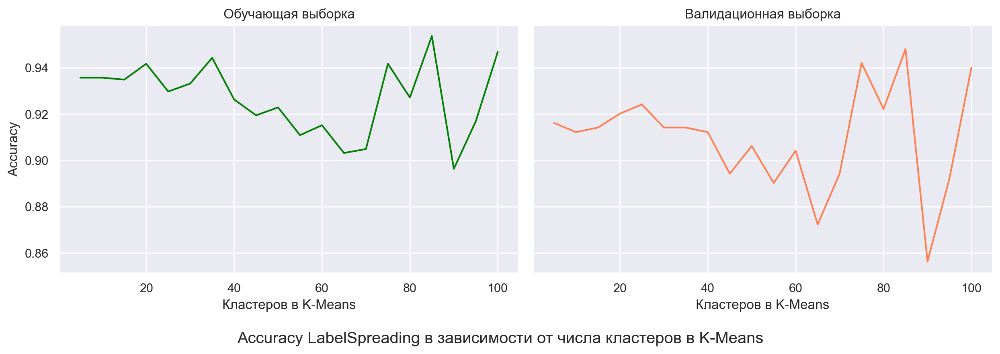

In [257]:
f, ax0 = plt.subplots(1, 2, figsize=(14,5), sharex=True, sharey=True)

ax0[0].plot(k_means_clusters, acc_train, color='green')
ax0[0].set_ylabel('Accuracy')
ax0[0].set_xlabel('Кластеров в K-Means')
ax0[0].set_title('Обучающая выборка')

ax0[1].plot(k_means_clusters, acc_val, color='coral')
ax0[1].set_ylabel('')
ax0[1].set_xlabel('Кластеров в K-Means')
ax0[1].set_title('Валидационная выборка')

f.suptitle("Accuracy LabelSpreading в зависимости от числа кластеров в K-Means", y=0.035)
f.tight_layout(rect=[0.05, 0.05, 0.95, 0.95])

In [258]:
sprd_best_k_means_clusters_idx = np.argmax(acc_val)
sprd_best_k_means_clusters = k_means_clusters[sprd_best_k_means_clusters_idx]
sprd_best_n_neighbors = n_neighborss[sprd_best_k_means_clusters_idx]
sprd_best_acc = acc_val[sprd_best_k_means_clusters_idx]

print(f'Модель: LabelSpreading \
      \nЛучшее n_clusters: {sprd_best_k_means_clusters} \
      \nЛучшее n_neighbors: {sprd_best_n_neighbors} \
      \nЛучшее accuracy: {sprd_best_acc}')

Модель: LabelSpreading       
Лучшее n_clusters: 85       
Лучшее n_neighbors: 17       
Лучшее accuracy: 0.9481037924151696


In [259]:
k_means = KMeans(n_clusters=sprd_best_k_means_clusters, random_state=13)
k_means = k_means.fit(X_train_marked_and_not_marked_tf_idf)
clusters = k_means.predict(X_train_marked_and_not_marked_tf_idf)
centers = k_means.cluster_centers_ 

cluster_data = data.copy()

for i in range(centers.shape[0]):
    # для каждого центра кластера
    # превращаем каждый центр в строку
    one_center_as_row = centers[i].reshape(-1, 1).T
    # создаю матрицу из единиц одного размера с X_tf_idf
    ones = np.ones(X_tf_idf.shape)  # (2225, 4608)
    # дублирую центры кластеров до размера X_tf_idf
    one_center_as_matrix = one_center_as_row * ones
    # считаю расстояние до центра i-го кластера для каждого объекта (новости)
    norm = np.linalg.norm(one_center_as_matrix - X_tf_idf, axis=1)

    # записываем расстояние до каждого кластера для каждого объекта (новости)
    cluster_data['dist_to_clust_' + str(i)] = norm

# забираем новые признаки
dist_cluster_data = cluster_data[cluster_data.columns[7:]]
# делим на train и test
X_train, X_test, y_train, y_test = train_test_split(dist_cluster_data, y, test_size=0.25, random_state=13)
# делим на размеченный train и неразмеченный train и validate
X_train_dist_marked, X_train_dist_not_marked, X_dist_validate = X_train[:chortcut_1], X_train[chortcut_1:chortcut_2], X_train[chortcut_2:]
y_train_marked, y_train_not_marked, y_validate = y_train[:chortcut_1], y_train[chortcut_1:chortcut_2], y_train[chortcut_2:]
# объединяю train для обучения unsupervised
X_train_dist_marked_and_not_marked = pd.concat([X_train_dist_marked, X_train_dist_not_marked])
y_train_marked_and_not_marked = pd.concat([y_train_marked, y_train_not_marked])
y_train_marked_and_not_marked[y_train_not_marked.index] = -1

Подбор параметра `alpha` для `LabelSpreading` с оптимальным `n_neighbors`:

In [270]:
alphas = np.linspace(0.001, 0.999, 100)
acc_train = []
acc_val = []

for alpha in alphas:
    label_sprd_model = LabelSpreading(kernel='knn', n_neighbors=sprd_best_n_neighbors, alpha=alpha, max_iter=10_000, n_jobs=-1)
    label_sprd_model.fit(X_train_dist_marked_and_not_marked, y_train_marked_and_not_marked)

    lr_pred_train = label_sprd_model.predict(X_train_dist_marked_and_not_marked)
    lr_pred_val = label_sprd_model.predict(X_dist_validate)

    acc_lr_train = accuracy_score(pd.concat([y_train_marked, y_train_not_marked]), lr_pred_train)
    acc_lr_val = accuracy_score(y_validate, lr_pred_val)

    acc_train.append(acc_lr_train)
    acc_val.append(acc_lr_val)

acc_train = np.array(acc_train)
acc_val = np.array(acc_val)

In [271]:
sprd_best_alpha_idx = np.argmax(acc_val)
sprd_best_alpha = alphas[sprd_best_alpha_idx]
print(f'Модель: LabelSpreading \
      \nЛучшее alpha: {sprd_best_alpha} \
      \nЛучшее accuracy: {acc_val[sprd_best_alpha_idx]}')

Модель: LabelSpreading       
Лучшее alpha: 0.8981919191919192       
Лучшее accuracy: 0.9441117764471058


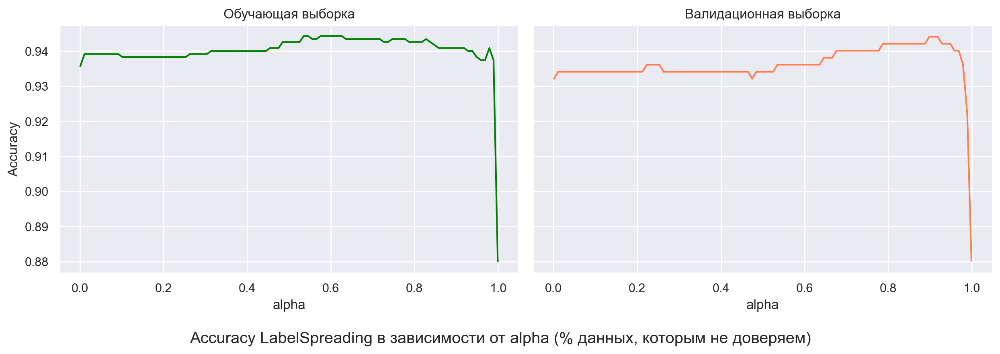

In [275]:
f, ax0 = plt.subplots(1, 2, figsize=(14,5), sharex=True, sharey=True)

ax0[0].plot(alphas, acc_train, color='green')
ax0[0].set_ylabel('Accuracy')
ax0[0].set_xlabel('alpha')
ax0[0].set_title('Обучающая выборка')

ax0[1].plot(alphas, acc_val, color='coral')
ax0[1].set_ylabel('')
ax0[1].set_xlabel('alpha')
ax0[1].set_title('Валидационная выборка')

f.suptitle("Accuracy LabelSpreading в зависимости от alpha (% данных, которым не доверяем)", y=0.035)
f.tight_layout(rect=[0.05, 0.05, 0.95, 0.95])

In [276]:
label_sprd_model = LabelSpreading(kernel='knn', n_neighbors=sprd_best_n_neighbors, alpha=sprd_best_alpha, max_iter=10_000, n_jobs=-1)
label_sprd_model.fit(X_train_dist_marked_and_not_marked, y_train_marked_and_not_marked)

lr_pred_train = label_sprd_model.predict(X_train_dist_marked_and_not_marked)
lr_pred_test = label_sprd_model.predict(X_test)

acc_lr_train = accuracy_score(pd.concat([y_train_marked, y_train_not_marked]), lr_pred_train)
acc_lr_test = accuracy_score(y_test, lr_pred_test)

print(f'Модель: LabelSpreading \
      \nAccuracy train: {round(acc_lr_train, 4)} \
      \nAccuracy test:  {round(acc_lr_test, 4)}')

Модель: LabelSpreading       
Accuracy train: 0.9409       
Accuracy test:  0.9264


In [67]:
df_semi_supervised.loc['KMeans (17 clust) + LabelSpreading (knn)-CV'] = [
    0.9409,
    0.9264,
    0.9,
    17
]

df_semi_supervised

,accuracy train,accuracy test,alpha,gamma / n_neighbors
tf-idf + LabelSpreading (rbf)-base,0.8278,0.8169,0.200,20.0
tf-idf + LabelPropagation (rbf)-base,0.8895,0.8636,0.000,20.0
tf-idf + LabelSpreading (knn)-base,0.8920,0.8671,0.200,7.0
tf-idf + LabelPropagation (knn)-base,0.8972,0.8689,0.000,7.0
tf-idf + LabelPropagation (knn)-CV,0.9160,0.8851,0.000,10.0
tf-idf + LabelPropagation (rbf)-CV,0.8698,0.8600,0.000,13.5
tf-idf + LabelSpreading (knn)-CV,0.9512,0.9300,0.001,47.0
KMeans (17 clust) + LabelSpreading (knn)-CV,0.9409,0.9264,0.900,17.0


In [280]:
df_metrics_small

,accuracy train,accuracy test,C (коэф. рег.),Число кластеров
tf-idf + logreg (CV),1.0000,0.9013,327455.0,NaN
KMeans (tf-idf) + logreg (center dist.) (CV),1.0000,0.9461,90473.6,40.0
LDA + logreg (topic probs) (CV),0.8554,0.8564,567.1,100.0


**Мини-вывод**: semi-supervised модели `LabelSpreading` **не хватило 0.02 по accuracy до аналогичной модели** на расстояния до центров кластеров с logreg.

### Латентное размещение Дирихле + LabelSpreading

In [37]:
# разбиваю данные
X_train, X_test, y_train, y_test = train_test_split(data.drop('y', axis=1), y, test_size=0.25, random_state=13)

X_train_marked, X_train_not_marked, X_validate = X_train[:chortcut_1], X_train[chortcut_1:chortcut_2], X_train[chortcut_2:]
y_train_marked, y_train_not_marked, y_validate = y_train[:chortcut_1], y_train[chortcut_1:chortcut_2], y_train[chortcut_2:]

X_train_marked_and_not_marked = pd.concat([X_train_marked, X_train_not_marked])
y_train_marked_and_not_marked = pd.concat([y_train_marked, y_train_not_marked])
y_train_marked_and_not_marked[y_train_not_marked.index] = -1

y_train_marked_and_not_marked[y_train_not_marked.index].unique()

array([-1])

In [41]:
# обучаем и применяем bag of words
bag_of_words_vect = CountVectorizer(max_df=1.0, min_df=0.005)
X_train_marked_and_not_marked_bow = bag_of_words_vect.fit_transform(X_train_marked_and_not_marked.text).toarray()
feature_names = bag_of_words_vect.get_feature_names_out()

X_train_marked_bow = bag_of_words_vect.transform(X_train_marked.text).toarray()
X_train_not_marked_bow = bag_of_words_vect.transform(X_train_not_marked.text).toarray()
X_validate_bow = bag_of_words_vect.transform(X_validate.text).toarray()
X_test_bow = bag_of_words_vect.transform(X_test.text).toarray()

assert X_train_marked_and_not_marked_bow.shape[1] == X_train_marked_bow.shape[1] == \
    X_train_not_marked_bow.shape[1] == X_validate_bow.shape[1] == X_test_bow.shape[1]

In [48]:
from IPython.display import clear_output

lda_n_components = np.arange(5, 105, 5)
n_neighborss = np.arange(1, 101)
acc_train = []
acc_val = []
best_n_neighbors = []

for lda_n_component in lda_n_components:
    # перебираю число компонент для LDA
    acc_train_n_neighbors = []
    acc_val_n_neighbors = []

    lda = LatentDirichletAllocation(n_components=lda_n_component, max_iter=50, evaluate_every=0, n_jobs=-1, random_state=13, verbose=0)
    lda.fit(X_train_marked_and_not_marked_bow)

    labels_prob_train = lda.transform(X_train_marked_and_not_marked_bow)
    labels_prob_val = lda.transform(X_validate_bow)

    acc_train_n_neighbors = []
    acc_val_n_neighbors = []

    for n_neighbors in n_neighborss:
        label_sprd_model = LabelSpreading(kernel='knn', n_neighbors=n_neighbors, alpha=0.001, max_iter=10_000, n_jobs=-1)
        label_sprd_model.fit(labels_prob_train, y_train_marked_and_not_marked)

        lr_pred_train = label_sprd_model.predict(labels_prob_train)
        lr_pred_val = label_sprd_model.predict(labels_prob_val)

        acc_lr_train = accuracy_score(pd.concat([y_train_marked, y_train_not_marked]), lr_pred_train)
        acc_lr_val = accuracy_score(y_validate, lr_pred_val)

        acc_train_n_neighbors.append(acc_lr_train)
        acc_val_n_neighbors.append(acc_lr_val)
    
    acc_train_n_neighbors = np.array(acc_train_n_neighbors)
    acc_val_n_neighbors = np.array(acc_val_n_neighbors)
    best_n_neighbors_idx = np.argmax(acc_val_n_neighbors)

    best_n_neighbor = n_neighborss[best_n_neighbors_idx]
    best_n_neighbors.append(best_n_neighbor)

    best_acc = acc_val_n_neighbors[best_n_neighbors_idx]
    acc_val.append(best_acc)
    acc_train.append(acc_train_n_neighbors[best_n_neighbors_idx])

    clear_output()
    print('lda_n_component:', lda_n_component)
    
acc_train = np.array(acc_train)
acc_val = np.array(acc_val)

lda_n_component: 100


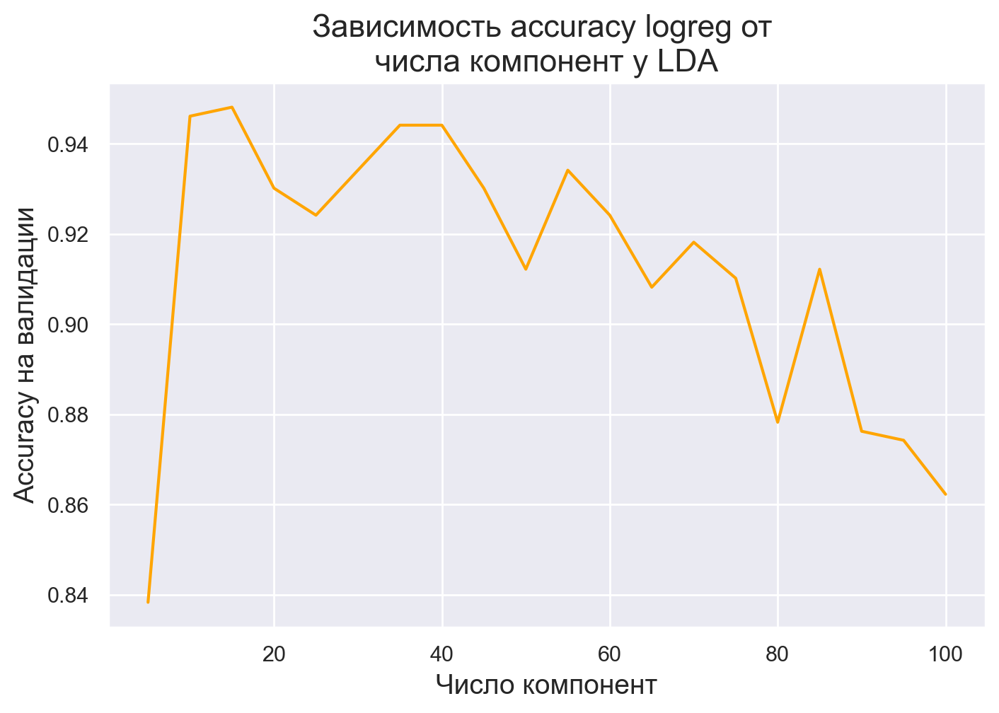

In [49]:
plt.figure(figsize=(8, 5))

plt.plot(lda_n_components, acc_val, color='orange')
plt.title('Зависимость accuracy logreg от \nчисла компонент у LDA', fontsize=16)
plt.xlabel("Число компонент", fontsize=14)
plt.ylabel("Accuracy на валидации", fontsize=14);

In [50]:
n_components_best_idx = np.argmax(acc_val)
n_components_best = lda_n_components[n_components_best_idx]
lda_best_acc = acc_val[n_components_best_idx]
lda_best_n_neighborss = best_n_neighbors[n_components_best_idx]


print(f'Лучшее число компонент: {n_components_best} \
      \nЛучшее accuracy: {lda_best_acc} \
      \nЛучшее n_neighbors: {lda_best_n_neighborss}')

Лучшее число компонент: 15       
Лучшее accuracy: 0.9481037924151696       
Лучшее n_neighbors: 44


Подбор `alpha` для `LabelSpreading` с оптимальным `n_components` для `LatentDirichletAllocation`:

In [53]:
alphas = np.linspace(0.001, 0.999, 100)
acc_train = []
acc_val = []

lda = LatentDirichletAllocation(n_components=n_components_best, max_iter=50, evaluate_every=0, n_jobs=-1, random_state=13, verbose=0)
lda.fit(X_train_marked_and_not_marked_bow)

labels_prob_train = lda.transform(X_train_marked_and_not_marked_bow)
labels_prob_val = lda.transform(X_validate_bow)

for alpha in alphas:
    label_sprd_model = LabelSpreading(kernel='knn', n_neighbors=lda_best_n_neighborss, alpha=alpha, max_iter=10_000, n_jobs=-1)
    label_sprd_model.fit(labels_prob_train, y_train_marked_and_not_marked)

    lr_pred_train = label_sprd_model.predict(labels_prob_train)
    lr_pred_val = label_sprd_model.predict(labels_prob_val)

    acc_lr_train = accuracy_score(pd.concat([y_train_marked, y_train_not_marked]), lr_pred_train)
    acc_lr_val = accuracy_score(y_validate, lr_pred_val)

    acc_train.append(acc_lr_train)
    acc_val.append(acc_lr_val)

acc_train = np.array(acc_train)
acc_val = np.array(acc_val)

In [54]:
lda_best_alpha_idx = np.argmax(acc_val)
lda_best_alpha = alphas[lda_best_alpha_idx]
print(f'Модель: LabelSpreading \
      \nЛучшее alpha: {lda_best_alpha} \
      \nЛучшее accuracy: {acc_val[lda_best_alpha_idx]}')

Модель: LabelSpreading       
Лучшее alpha: 0.001       
Лучшее accuracy: 0.9481037924151696


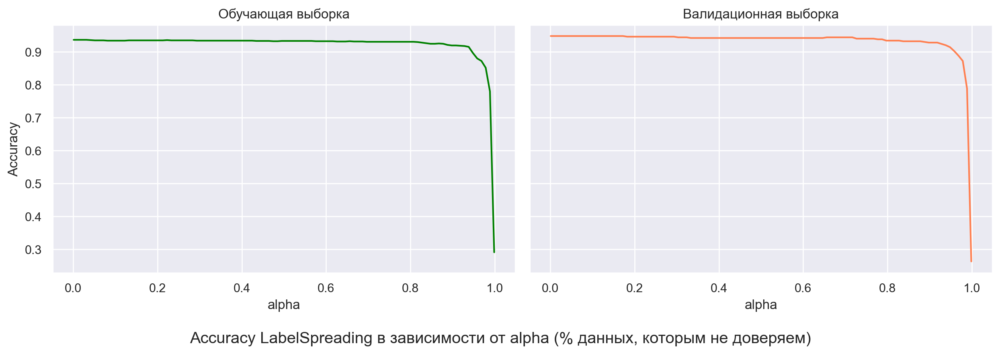

In [55]:
f, ax0 = plt.subplots(1, 2, figsize=(14,5), sharex=True, sharey=True)

ax0[0].plot(alphas, acc_train, color='green')
ax0[0].set_ylabel('Accuracy')
ax0[0].set_xlabel('alpha')
ax0[0].set_title('Обучающая выборка')

ax0[1].plot(alphas, acc_val, color='coral')
ax0[1].set_ylabel('')
ax0[1].set_xlabel('alpha')
ax0[1].set_title('Валидационная выборка')

f.suptitle("Accuracy LabelSpreading в зависимости от alpha (% данных, которым не доверяем)", y=0.035)
f.tight_layout(rect=[0.05, 0.05, 0.95, 0.95])

In [58]:
lda = LatentDirichletAllocation(n_components=n_components_best, max_iter=50, evaluate_every=0, n_jobs=-1, random_state=13, verbose=0)
lda.fit(X_train_marked_and_not_marked_bow)

labels_prob_train = lda.transform(X_train_marked_and_not_marked_bow)
labels_prob_val = lda.transform(X_validate_bow)
labels_prob_test = lda.transform(X_test_bow)

label_sprd_model = LabelSpreading(kernel='knn', n_neighbors=lda_best_n_neighborss, alpha=lda_best_alpha, max_iter=10_000, n_jobs=-1)
label_sprd_model.fit(labels_prob_train, y_train_marked_and_not_marked)

lr_pred_train = label_sprd_model.predict(labels_prob_train)
lr_pred_test = label_sprd_model.predict(labels_prob_test)

acc_lr_train = accuracy_score(pd.concat([y_train_marked, y_train_not_marked]), lr_pred_train)
acc_lr_test = accuracy_score(y_test, lr_pred_test)

print(f'Модель: LabelSpreading \
      \nAccuracy train: {round(acc_lr_train, 4)} \
      \nAccuracy test:  {round(acc_lr_test, 4)}')

Модель: LabelSpreading       
Accuracy train: 0.9366       
Accuracy test:  0.9246


In [95]:
df_semi_supervised.loc['LDA (15 comp) + LabelSpreading (knn)-CV'] = [
    0.9366,
    0.9246,
    0.001,
    44
]

In [84]:
df_metrics_small.sort_values(by='accuracy test', ascending=False)

,accuracy train,accuracy test,C (коэф. рег.),Число кластеров
KMeans (tf-idf) + logreg (center dist.) (CV),1.0000,0.9461,90473.6,40.0
LDA + logreg (topic probs) (CV),0.9759,0.9372,3.6,10.0
tf-idf + logreg (CV),1.0000,0.9013,327455.0,NaN


In [97]:
df_semi_supervised.sort_values(by='accuracy test', ascending=False).head(4)

,accuracy train,accuracy test,alpha,gamma / n_neighbors
tf-idf + LabelSpreading (knn)-CV,0.9512,0.9300,0.001,47.0
KMeans (17 clust) + LabelSpreading (knn)-CV,0.9409,0.9264,0.900,17.0
LDA (15 comp) + LabelSpreading (knn)-CV,0.9366,0.9246,0.001,44.0
tf-idf + LabelPropagation (knn)-CV,0.9160,0.8851,0.000,10.0


In [94]:
df_metrics.sort_values(by='accuracy test', ascending=False).head(5)

,accuracy train,accuracy test,C (коэф. рег.)
tf-idf + logreg (CV),1.0000,0.9749,268.3
tf-idf + logreg (base),0.9958,0.9695,1.0
KMeans (tf-idf) + logreg (center dist.) (CV),0.9682,0.9443,71968.6
LDA + logreg (topic probs) (base),0.9538,0.9425,1.0
LDA + logreg (topic probs) (CV),0.9592,0.9390,10.0


**Вывод**: с помощью semi-supervised алгоритмов из sklearn **удалось улучшить результат для 1/3 подходов** (классификатор на tf-idf представление).

Для всех задач kNN показал себя лучше, чем более сложное ядро rbf. Думаю, это связано с тем, что наши данные простые и не противоречивые, а также их немного.

Благодаря применению `LabelSpreading` модели самый простой и быстрый подход с классификацией по tf-idf представлению вновь стал лучшим по качеству. Если бы мне нужно было решать подобную задачу, я бы использовал именно его.

При этом, в целом, результаты работы semi-supervised алгоритмов отличаются от обучения классических методов по всей выборке по качеству примерно на 0.02 по **accuracy**. Учитывая, что они обучены на 5% данных, я думаю, что это хороший способ снижения затрат на сбор и разметку данных.  

На занятиях мы обсуждали, что метрика [BCubed](https://www.researchgate.net/profile/Julio-Gonzalo-2/publication/225548032_Amigo_E_Gonzalo_J_Artiles_J_et_alA_comparison_of_extrinsic_clustering_evaluation_metrics_based_on_formal_constraints_Inform_Retriev_12461-486/links/0c96052138dbb99740000000/Amigo-E-Gonzalo-J-Artiles-J-et-alA-comparison-of-extrinsic-clustering-evaluation-metrics-based-on-formal-constraints-Inform-Retriev-12461-486.pdf) хорошо подходит для сравнения алгоритмов кластеризации, если нам известно настоящее разделение на кластеры (gold standard). Реализуем подсчет метрики BCubed и сравним несколько алгоритмов кластеризации на текстовых данных из основного задания. В качестве gold standard используем разметку category.

*Примечание: в начале сделаем свою реализацию метрики BCubed, а затем сравним с реализацией в библиотеке `bcubed`.*

In [21]:
# обучаю tf-idf, отбрасывая 0.5% слов по встречаемости
vectorizer = TfidfVectorizer(max_df=1.0, min_df=0.005)
X = vectorizer.fit_transform(data.text)

# обучаю kmeans с 5 кластерами
k_means = KMeans(n_clusters=5, random_state=13)
k_means = k_means.fit(X)

clusters = k_means.predict(X)
centers = k_means.cluster_centers_ 

# добавляю выходы модели в датасет
data['cluster'] = clusters

In [115]:
data.sample(5)

,category,filename,title,content,raw_text,text,y,cluster
1626,sport,314.txt,O'Driscoll saves Irish blushes,Two moments of magic from Brian O'Driscoll gu...,O'Driscoll saves Irish blushes Two moments of ...,save irish blush two moment magic brian guided...,3,3
482,business,483.txt,Ailing EuroDisney vows turnaround,"EuroDisney, the European home of Mickey Mouse...","Ailing EuroDisney vows turnaround EuroDisney, ...",ailing eurodisney vow turnaround eurodisney eu...,0,0
1081,politics,186.txt,Blair says mayor should apologise,Tony Blair has urged London mayor Ken Livings...,Blair says mayor should apologise Tony Blair h...,blair mayor apologise tony blair urged london ...,2,4
805,entertainment,296.txt,Snow Patrol bassist exits group,"Snow Patrol had ""no other course of action"" b...",Snow Patrol bassist exits group Snow Patrol ha...,snow patrol bassist exit group snow patrol cou...,1,2
578,entertainment,069.txt,Foxx and Swank take actors awards,Jamie Foxx and Hilary Swank have won the Scre...,Foxx and Swank take actors awards Jamie Foxx a...,foxx swank take actor award jamie foxx hilary ...,1,2


In [116]:
def precision_bcubed(data):
    '''
    Функция считает метрику Precision-BCubed
    param data: pd.DataFrame с метками кластеров и gold-standard метками
    у pd.DataFrame data должно быть определено два поля:
        1. 'y' - gold-standard метки
        2. 'cluster' - кластеры из модели
    '''
    # завожу переменную для суммы precision-ов
    prec = 0

    # без цикла по объектам реализовать не получилось
    for _, row in data.iterrows():
        # фиксирую истинную метку (ground truth) и кластер из модели
        gr_tr_i, cluster_i = row['y'], row['cluster']
        # обращаюсь к объектам, которые попали в такой же кластер
        same_clust = data[data['cluster'] == cluster_i]
        # считаю, сколько из них принадлежат такой же истинной метке 
        correct = np.sum(same_clust['y'] == gr_tr_i)
        # считаю precision, прибавляю к общей сумме
        prec_i = correct / len(same_clust)
        prec += prec_i
    # номрирую на число объектов
    prec = prec / len(data)
    return prec

def recall_bcubed(data):
    '''
    Функция считает метрику Recall-BCubed
    param data: pd.DataFrame с метками кластеров и gold-standard метками
    у pd.DataFrame data должно быть определено два поля:
        1. 'y' - gold-standard метки
        2. 'cluster' - кластеры из модели
    '''
    # завожу переменную для суммы recall-ов
    recl = 0

    # без цикла по объектам реализовать не получилось
    for _, row in data.iterrows():
        # фиксирую истинную метку (ground truth) и кластер из модели
        gr_tr_i, cluster_i = row['y'], row['cluster']
        # обращаюсь к объектам, у которых такие же истинные метки
        same_gr_tr = data[data['y'] == gr_tr_i]
        # смотрю, сколько из объектов того же ист. класса попало в 
        # один кластер с i-м объеком
        in_clust = np.sum(same_gr_tr['cluster'] == cluster_i)
        # считаю recall, прибавляю к сумме
        recl_i = in_clust / len(same_gr_tr)
        recl += recl_i
    # номрирую на число объектов
    recl = recl / len(data)
    return recl

def f_alpha_score(prec, recl, alpha=1.0):
    '''
    Функция считает F_alpha-меру с возможностью изменения параметра alpha,
    отвечающего за "вес" prec и recl
    param prec: precision_bcubed
    param recl: recall_bcubed
    param alpha: парамер, отвечающий за "вес" precision_bcubed и recall_bcubed
    '''
    return ((1.0 + alpha**2) * (prec * recl)) / (alpha**2 * prec + recl)

In [117]:
prec = precision_bcubed(data)
recl = recall_bcubed(data)
f_score = f_alpha_score(prec, recl)

In [119]:
print(f'Precision-BCubed для K-Means: {round(prec, 4)}, \
      \nRecall-BCubed для K-Means: {round(recl, 4)}, \
      \nF-мера для K-Means: {round(f_score, 4)}')

Precision-BCubed для K-Means: 0.7823,       
Recall-BCubed для K-Means: 0.7847,       
F-мера для K-Means: 0.7835


In [21]:
# dataframe для сравнения 
# методов классификации по метрикам
df_bcubed = pd.DataFrame(columns=['N clusters',
                                  'Precision-BCubed',
                                  'Recall-BCubed',
                                  'F-score'])

# добавление очередной строки с характеристиками метода
df_bcubed.loc['K-Means'] = [
    5,
    0.7823,
    0.7847,
    0.7835
]

Видно, что для K-Means Precision-BCubed почти не отличается от Recall-BCubed.

Теперь сравним мою реализацию с готовой (и странной) из библиотеки `bcubed`:

In [29]:
import bcubed

[bcubed](https://pypi.org/project/bcubed/) требует странного представления данных в виде словаря. Оформлю данные так, как функции из нее ждут:

In [120]:
ldict = {}  # это ground truth

for id, row in data.iterrows():
    ldict[id] = set([row['y']])

cdict = {}  # это кластеры

for id, row in data.iterrows():
    cdict[id] = set([row['cluster']])

In [121]:
precision = bcubed.precision(cdict, ldict)
recall = bcubed.recall(cdict, ldict)
fscore = bcubed.fscore(precision, recall)

In [123]:
print(f'Мой    Precision-BCubed для K-Means: {round(prec, 4)}, \
      \nНе мой Precision-BCubed для K-Means: {round(precision, 4)}\n')

print(f'Мой   Recall-BCubed для K-Means: {round(recl, 4)}, \
      \nНе мойRecall-BCubed для K-Means: {round(recall, 4)}\n')

print(f'Моя    F-мера для K-Means: {round(f_score, 4)}, \
      \nНе моя F-мера для K-Means: {round(fscore, 4)}')

Мой    Precision-BCubed для K-Means: 0.7823,       
Не мой Precision-BCubed для K-Means: 0.7823

Мой   Recall-BCubed для K-Means: 0.7847,       
Не мойRecall-BCubed для K-Means: 0.7847

Моя    F-мера для K-Means: 0.7835,       
Не моя F-мера для K-Means: 0.7835


**В точности одинаково!**

In [124]:
%%timeit
prec = precision_bcubed(data)
recl = recall_bcubed(data)
f_score = f_alpha_score(prec, recl)

3.45 s ± 789 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [125]:
%%timeit
precision = bcubed.precision(cdict, ldict)
recall = bcubed.recall(cdict, ldict)
fscore = bcubed.fscore(precision, recall)

4.22 s ± 286 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


Мое решение более эффективно.

In [126]:
# для визуализации
prec_kmeans = precision_bcubed(data)
recl_kmeans = recall_bcubed(data)
f_score_kmeans = f_alpha_score(prec, recl)

Посмотрим на результаты для других алгоритмов кластеризации:

In [128]:
# спектральная кластеризация
spectral_clust = SpectralClustering(n_clusters=5, random_state=13)
clusters_spectral = spectral_clust.fit_predict(X)

# добавляю выходы модели в датасет
data['cluster'] = clusters_spectral

In [134]:
# для визуализации
prec_spectral = precision_bcubed(data)
recl_spectral = recall_bcubed(data)
f_score_spectral = f_alpha_score(prec_spectral, recl_spectral)

In [135]:
print(f'Precision-BCubed для Spectral: {round(prec_spectral, 4)}, \
      \nRecall-BCubed для Spectral: {round(recl_spectral, 4)}, \
      \nF-мера для Spectral: {round(f_score_spectral, 4)}')

Precision-BCubed для Spectral: 0.7154,       
Recall-BCubed для Spectral: 0.7493,       
F-мера для Spectral: 0.732


In [22]:
# добавление очередной строки с характеристиками метода
df_bcubed.loc['Spectral'] = [
    5,
    0.7154,
    0.7493,
    0.732
]

Для DBSCAN будет обучено несколько вариантов, чтобы показать зависимость метрики от числа кластеров:

In [278]:
# обучаем dbscan
dbscan_5 = DBSCAN(eps=1.21, min_samples=42, n_jobs=-1)
clusters_dbscan_5 = dbscan_5.fit_predict(X)
np.unique(clusters_dbscan_5)  # получилось 5 кластеров

array([-1,  0,  1,  2,  3], dtype=int64)

In [279]:
# добавляю выходы модели в датасет
data['cluster'] = clusters_dbscan_5

# для визуализации
prec_dbscan_5 = precision_bcubed(data)
recl_dbscan_5 = recall_bcubed(data)
f_score_dbscan_5 = f_alpha_score(prec_dbscan_5, recl_dbscan_5)

print(f'Precision-BCubed для DBSCAN (5): {round(prec_dbscan_5, 4)}, \
      \nRecall-BCubed для DBSCAN (5): {round(recl_dbscan_5, 4)}, \
      \nF-мера для DBSCAN (5): {round(f_score_dbscan_5, 4)}')

Precision-BCubed для DBSCAN (5): 0.3548,       
Recall-BCubed для DBSCAN (5): 0.7162,       
F-мера для DBSCAN (5): 0.4745


In [23]:
# добавление очередной строки с характеристиками метода
df_bcubed.loc['DBSCAN (5)'] = [
    5,
    0.3548,
    0.7162,
    0.4745
]

In [280]:
# обучаем dbscan
dbscan_6 = DBSCAN(eps=1.21, min_samples=40, n_jobs=-1)
clusters_dbscan_6 = dbscan_6.fit_predict(X)
np.unique(clusters_dbscan_6)  # получилось 6 кластеров

array([-1,  0,  1,  2,  3,  4], dtype=int64)

In [286]:
# добавляю выходы модели в датасет
data['cluster'] = clusters_dbscan_6

# для визуализации
prec_dbscan_6 = precision_bcubed(data)
recl_dbscan_6 = recall_bcubed(data)
f_score_dbscan_6 = f_alpha_score(prec_dbscan_6, recl_dbscan_6)

print(f'Precision-BCubed для DBSCAN (6): {round(prec_dbscan_6, 4)}, \
      \nRecall-BCubed для DBSCAN (6): {round(recl_dbscan_6, 4)}, \
      \nF-мера для DBSCAN (6): {round(f_score_dbscan_6, 4)}')

Precision-BCubed для DBSCAN (6): 0.3725,       
Recall-BCubed для DBSCAN (6): 0.675,       
F-мера для DBSCAN (6): 0.4801


In [24]:
# добавление очередной строки с характеристиками метода
df_bcubed.loc['DBSCAN (6)'] = [
    6,
    0.3725,
    0.675, 
    0.4801
]

In [282]:
# обучаем dbscan
dbscan_7 = DBSCAN(eps=1.22, min_samples=40, n_jobs=-1)  #  0.4935
clusters_dbscan_7 = dbscan_7.fit_predict(X)
np.unique(clusters_dbscan_7)  # получилось 7 кластеров

array([-1,  0,  1,  2,  3,  4,  5,  6], dtype=int64)

In [283]:
# добавляю выходы модели в датасет
data['cluster'] = clusters_dbscan_7

# для визуализации
prec_dbscan_7 = precision_bcubed(data)
recl_dbscan_7 = recall_bcubed(data)
f_score_dbscan_7 = f_alpha_score(prec_dbscan_7, recl_dbscan_7)

In [284]:
print(f'Precision-BCubed для DBSCAN (7): {round(prec_dbscan_7, 4)}, \
      \nRecall-BCubed для DBSCAN (7): {round(recl_dbscan_7, 4)}, \
      \nF-мера для DBSCAN (7): {round(f_score_dbscan_7, 4)}')

Precision-BCubed для DBSCAN (7): 0.4353,       
Recall-BCubed для DBSCAN (7): 0.5696,       
F-мера для DBSCAN (7): 0.4935


In [25]:
# добавление очередной строки с характеристиками метода
df_bcubed.loc['DBSCAN (7)'] = [
    7,
    0.4353,  
    0.5696,   
    0.4935
]

Визуализация:

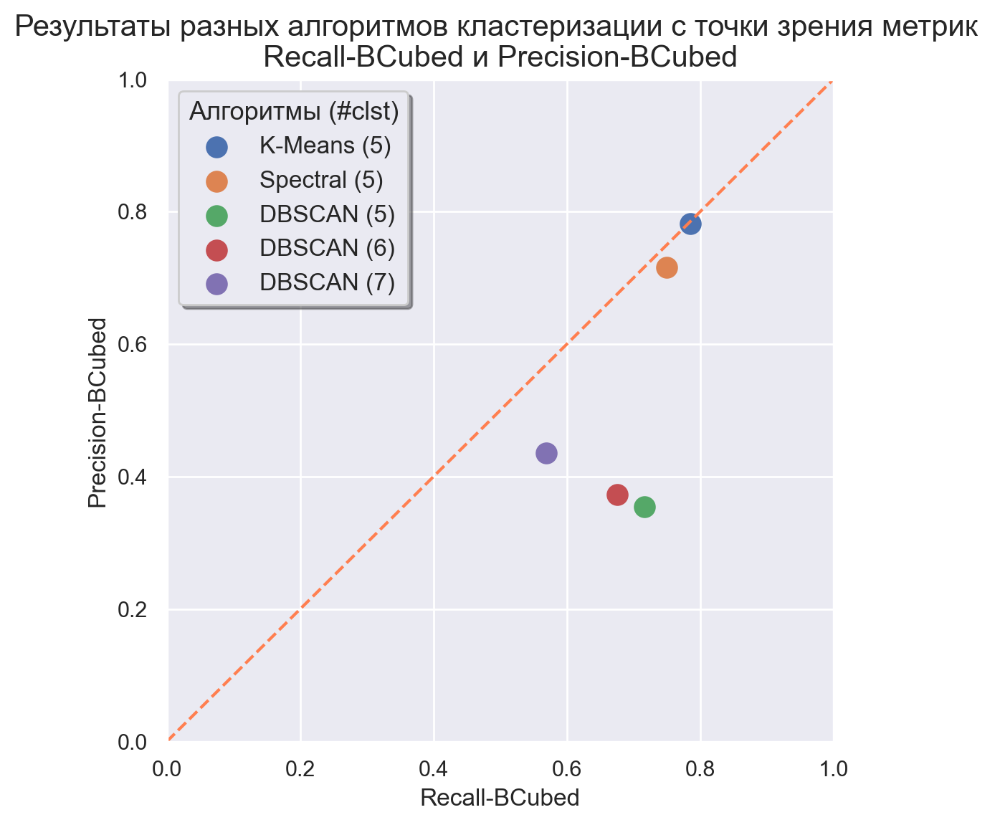

In [285]:
# тестим max_depth
plt.figure(figsize=(6, 6))

plt.plot([0, 1], [0, 1], '--', c='coral')
plt.scatter(recl_kmeans, prec_kmeans, label='K-Means (5)', cmap=sns.color_palette("Spectral", as_cmap=True), s=100)
plt.scatter(recl_spectral, prec_spectral, label='Spectral (5)', cmap=sns.color_palette("Spectral", as_cmap=True), s=100)
plt.scatter(recl_dbscan_5, prec_dbscan_5, label='DBSCAN (5)', cmap=sns.color_palette("Spectral", as_cmap=True), s=100)
plt.scatter(recl_dbscan_6, prec_dbscan_6, label='DBSCAN (6)', cmap=sns.color_palette("Spectral", as_cmap=True), s=100)
plt.scatter(recl_dbscan_7, prec_dbscan_7, label='DBSCAN (7)', cmap=sns.color_palette("Spectral", as_cmap=True), s=100)

plt.legend(title='Алгоритмы (#clst)', title_fontsize=13, fontsize=12, loc='best', shadow=True)
plt.xlabel('Recall-BCubed')
plt.ylabel('Precision-BCubed')
plt.xlim(0, 1)
plt.ylim(0, 1)
plt.title('Результаты разных алгоритмов кластеризации с точки зрения метрик \nRecall-BCubed и Precision-BCubed', fontsize=15);

In [29]:
df_bcubed.sort_values('F-score', ascending=False)

,N clusters,Precision-BCubed,Recall-BCubed,F-score
K-Means,5.0,0.7823,0.7847,0.7835
Spectral,5.0,0.7154,0.7493,0.7320
DBSCAN (7),7.0,0.4353,0.5696,0.4935
DBSCAN (6),6.0,0.3725,0.6750,0.4801
DBSCAN (5),5.0,0.3548,0.7162,0.4745


**Вывод**: с т.з. метрики BCubed (F-score) лучшим алгоритмом стал **K-Means** (причем у него значения Recall и Precision практически идентичные), спектральная кластеризация отстала совсем ненамного. Думаю, что хорошие метрики у K-Means связаны с тем, что он ищет кластеры примерно одинакового выпуклого размера, а, применительно к этой задаче, спектр. кластеризация может немного "усложнять". Хотя на визуализациях выше было видно, что, применительно к этой задаче, **K-Means очень похож на спектральную кластеризацию**.

**DBSCAN** по метрикам провалился полностью, как было замечено выше. Причем F-мера для него получается выше (0.4935 VS 0.4801 VS 0.4745), если брать больше кластеров, чем есть в golden-standard засчет не такого провального Precision.

P.S. При этом просто напомню, что результат DBSCAN выглядит примерно так:

In [266]:
tsne = TSNE(n_components=2, perplexity=30.0, random_state=13, learning_rate='auto', init='random', n_jobs=-1)
X_embedded = tsne.fit_transform(X)

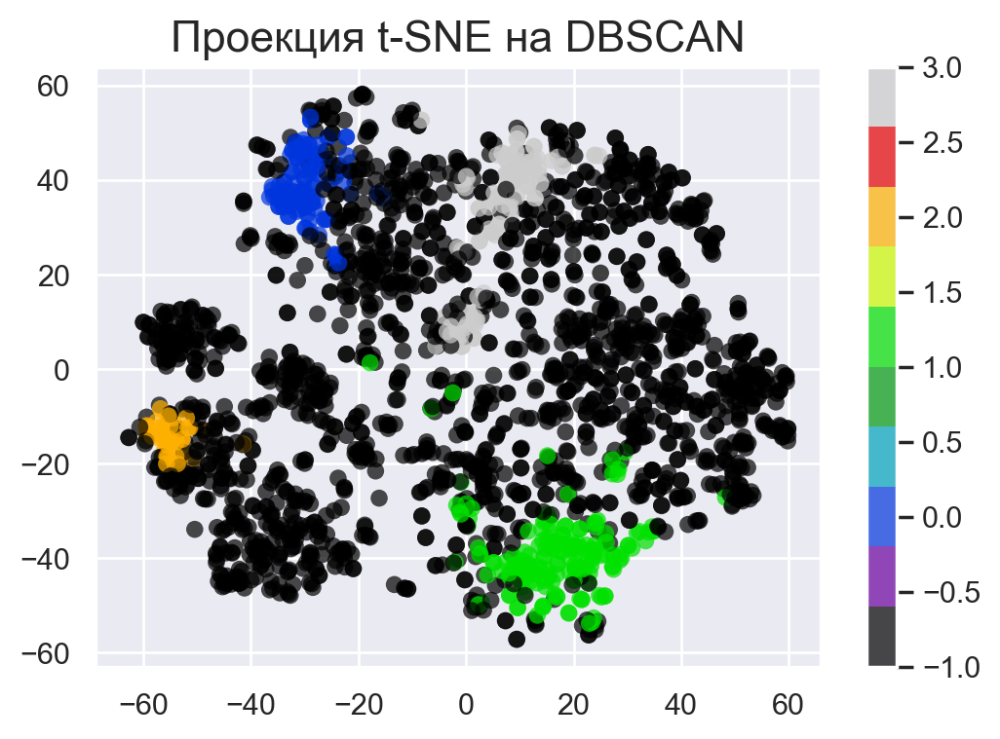

In [287]:
plt.figure(figsize=(6, 4))
plt.scatter(X_embedded[:, 0], X_embedded[:, 1], c=clusters_dbscan_5, 
            edgecolor='none', alpha=0.7, s=40,
            cmap=plt.cm.get_cmap('nipy_spectral', 10))
plt.colorbar()
plt.title('Проекция t-SNE на DBSCAN', fontsize=16);

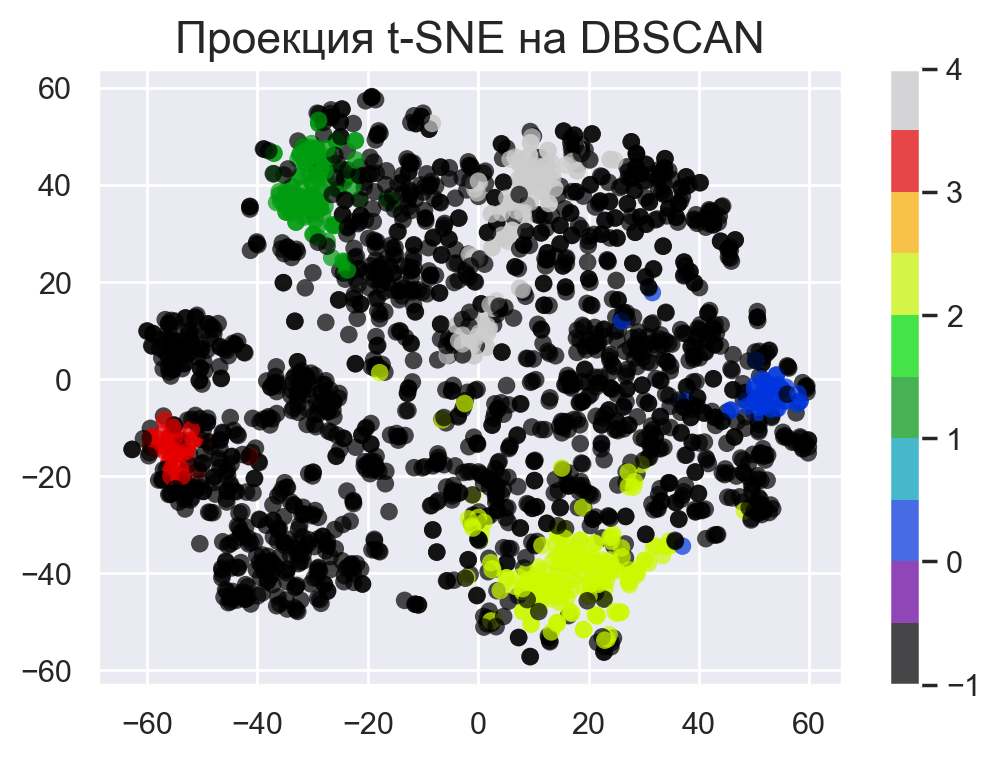

In [288]:
plt.figure(figsize=(6, 4))
plt.scatter(X_embedded[:, 0], X_embedded[:, 1], c=clusters_dbscan_6, 
            edgecolor='none', alpha=0.7, s=40,
            cmap=plt.cm.get_cmap('nipy_spectral', 10))
plt.colorbar()
plt.title('Проекция t-SNE на DBSCAN', fontsize=16);

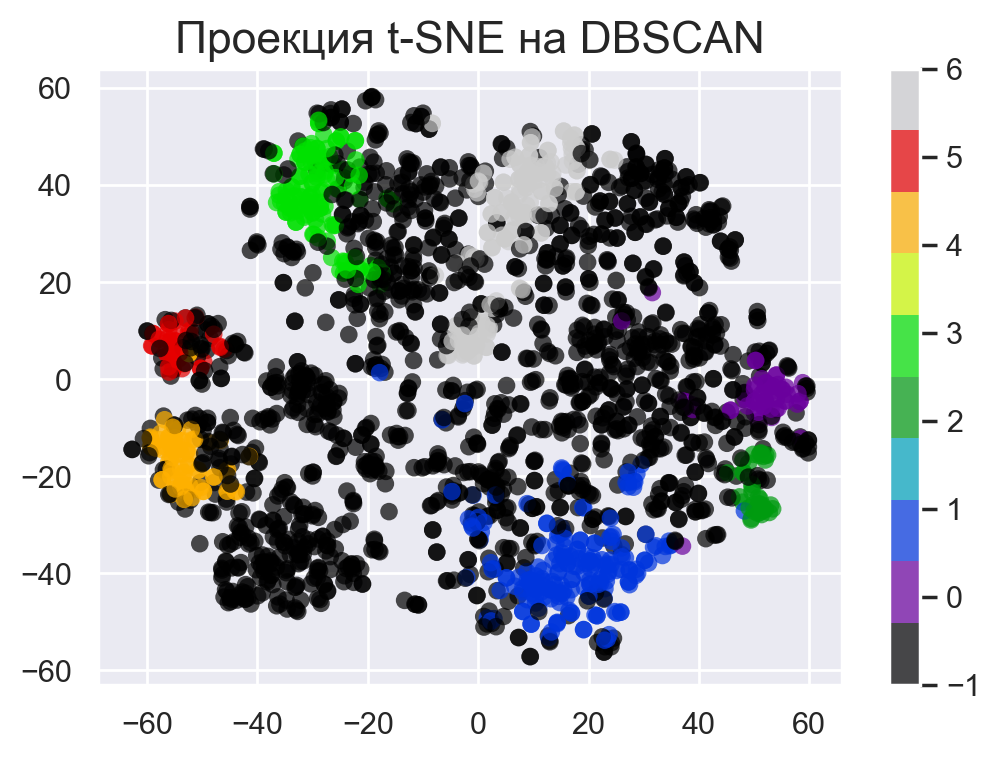

In [268]:
plt.figure(figsize=(6, 4))
plt.scatter(X_embedded[:, 0], X_embedded[:, 1], c=clusters_dbscan_7, 
            edgecolor='none', alpha=0.7, s=40,
            cmap=plt.cm.get_cmap('nipy_spectral', 10))
plt.colorbar()
plt.title('Проекция t-SNE на DBSCAN', fontsize=16);